In [1]:
!pip install -q efficientnet

In [1]:
%pwd

'E:\\OneDrive\\Insight\\plant-disease-master\\plant-pathology-2020-fgvc7'

In [1]:
import os
import gc
import re

import cv2
import math
import numpy as np
import scipy as sp
import pandas as pd

import tensorflow as tf
from IPython.display import SVG
import efficientnet.tfkeras as efn
from keras.utils import plot_model
import tensorflow.keras.layers as L
from keras.utils import model_to_dot
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model

from tensorflow.keras.applications import DenseNet121

import seaborn as sns
from tqdm import tqdm
import matplotlib.cm as cm
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.utils import shuffle

from sklearn.model_selection import train_test_split

tqdm.pandas()


import warnings
warnings.filterwarnings("ignore")


np.random.seed(0)
#tf.random.set_seed(0)


C:\Users\Wanchen\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Wanchen\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Wanchen\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Wanchen\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:519: FutureWarnin

In [2]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots 


In [2]:
%pwd

'E:\\OneDrive\\Insight\\plant-disease-master\\plant-pathology-2020-fgvc7'

In [14]:
TRAIN_DIR ='./color'

In [15]:
def label_imgv2(word_label):
    if word_label == 'Apple__Apple_Scab': return 0
    elif word_label == 'Apple__Black_rot': return 1
    elif word_label == 'Apple__Cedar_apple_rust': return 2
    elif word_label == 'Apple__healthy': return 3
    elif word_label == 'Blueberry__healthy': return 4
    elif word_label == 'Cherry_(including_sour)__Powdery_mildew': return 5
    elif word_label == 'Cherry_(including_sour)__healthy': return 6
    elif word_label == 'Corn_(maize)__Cercospora_leaf_spot Gary_leaf_spot': return 7
    elif word_label == 'Corn_(maize)__Common_rust_': return 8
    elif word_label == 'Corn_(maize)__Northern_Leaf_Blight': return 9
    elif word_label == 'Corn_(maize)__healthy': return 10
    elif word_label == 'Grape__Black_rot': return 11
    elif word_label == 'Grape__Esca_(Black_Measles)': return 12
    elif word_label == 'Grape__Leaf_blight_(Isariopsis_Leaf_Spot)': return 13
    elif word_label == 'Grape__healthy': return 14
    elif word_label == 'Orange__Haunglongbing_(Citrus_greening)': return 15
    elif word_label == 'Peach__Bacterial_spot': return 16
    elif word_label == 'Peach__healthy': return 17
    elif word_label == 'Pepper,_bell__Bacterial_spot': return 18
    elif word_label == 'Pepper,_bell__healthy': return 19
    elif word_label == 'Potato__Late_blight': return 21
    elif word_label == 'Potato__healthy': return 22
    elif word_label == 'Raspberry__healthy': return 23
    elif word_label == 'Soybean__healthy': return 24
    elif word_label == 'Squash__Powdery_mildew': return 25
    elif word_label == 'Strawberry__Leaf_scorch': return 26
    elif word_label == 'Strawberry__healthy': return 27
    elif word_label == 'Tomato__Bacterial_spot': return 28
    elif word_label == 'Tomato__Early_blight': return 29
    elif word_label == 'Tomato__Late_blight': return 30
    elif word_label == 'Tomato__Leaf_Mold': return 31
    elif word_label == 'Tomato__Septoria_leaf_spot': return 32
    elif word_label == 'Tomato__Spider_mite Two-spotted_spider_mite': return 33
    elif word_label == 'Tomato__Target_Spot': return 34
    elif word_label == 'Tomato__Tomato_Yellow_Leaf_Curl_Virus': return 35
    elif word_label == 'Tomato__Tomato_mosaic_virus': return 36
    elif word_label == 'Tomato__healthy': return 37

def create_train_data():
    training_data = []
    
    for folder in os.listdir(TRAIN_DIR):
        i=0
        for img in os.listdir(TRAIN_DIR+"/"+folder):
            i+=1
            path = os.path.join(TRAIN_DIR+"/"+folder,img)
            
            try:
                label = label_imgv2(folder)
                img = cv2.imread(path,cv2.IMREAD_COLOR)
                img = cv2.resize(img, (IMG_SIZE,IMG_SIZE))
                training_data.append([np.array(img),np.array(label)])
            
            except:
                print(path)
            if i==500:
                break

    shuffle(training_data)
    return training_data

train_data = create_train_data()

./color/Apple___Apple_scab\00075aa8-d81a-4184-8541-b692b78d398a___FREC_Scab 3335.JPG
./color/Apple___Apple_scab\01a66316-0e98-4d3b-a56f-d78752cd043f___FREC_Scab 3003.JPG
./color/Apple___Apple_scab\01f3deaa-6143-4b6c-9c22-620a46d8be04___FREC_Scab 3112.JPG
./color/Apple___Apple_scab\0208f4eb-45a4-4399-904e-989ac2c6257c___FREC_Scab 3037.JPG
./color/Apple___Apple_scab\023123cb-7b69-4c9f-a521-766d7c8543bb___FREC_Scab 3487.JPG
./color/Apple___Apple_scab\0261a6e4-21f8-481a-8827-b674e6955644___FREC_Scab 3055.JPG
./color/Apple___Apple_scab\029424b0-0ef5-491b-9ef5-069190d24d8f___FREC_Scab 3504.JPG
./color/Apple___Apple_scab\03354abb-aa1c-4f9d-a1ef-9f40505cd539___FREC_Scab 3355.JPG
./color/Apple___Apple_scab\0340dc35-5215-48ab-8db7-06af99fcb358___FREC_Scab 2966.JPG
./color/Apple___Apple_scab\0395b847-2c73-4674-826f-33a6afb5b4fe___FREC_Scab 3287.JPG
./color/Apple___Apple_scab\03eccb1a-0368-4ac7-9f48-7546037b775a___FREC_Scab 3334.JPG
./color/Apple___Apple_scab\0537ad56-3d24-4e97-a947-65b9b37f8988__

./color/Apple___Apple_scab\2bfd8ee0-af6b-42fd-ae61-fc5e92ec1b67___FREC_Scab 2988.JPG
./color/Apple___Apple_scab\2c648fcd-d637-4559-beaa-9dd6079646fb___FREC_Scab 3213.JPG
./color/Apple___Apple_scab\2c7ca7c8-1a6c-4811-b9b0-b054c11a5397___FREC_Scab 3260.JPG
./color/Apple___Apple_scab\2c89ceaf-748c-4371-80d0-d01855f04a92___FREC_Scab 2962.JPG
./color/Apple___Apple_scab\2d329823-7ad5-4189-89b7-4bdf24f9c393___FREC_Scab 3507.JPG
./color/Apple___Apple_scab\2d4c8a12-a34c-4c8b-b357-271d87532ece___FREC_Scab 3090.JPG
./color/Apple___Apple_scab\2d5265d2-be99-4e9f-a085-d309cc01b751___FREC_Scab 3023.JPG
./color/Apple___Apple_scab\2dd8b8f8-46b0-4bc6-b817-ea7163f4b28b___FREC_Scab 3473.JPG
./color/Apple___Apple_scab\2e264ee0-7679-4ad2-a19a-1ac4d2e84079___FREC_Scab 2984.JPG
./color/Apple___Apple_scab\2f1e68c0-c059-46fd-bbf3-f160817abdc3___FREC_Scab 3535.JPG
./color/Apple___Apple_scab\2f668a95-80ab-40ac-98ef-657bd85b668b___FREC_Scab 3247.JPG
./color/Apple___Apple_scab\30111fee-0c22-4ca4-aeb4-ac14a9a5d651__

./color/Apple___Apple_scab\5eb564a6-cd74-4c90-95d9-611a6301369d___FREC_Scab 3099.JPG
./color/Apple___Apple_scab\5f312356-04d0-44d0-ba06-4e3c33907b03___FREC_Scab 3349.JPG
./color/Apple___Apple_scab\5fcb921d-3329-443c-a708-37c3943f5493___FREC_Scab 2987.JPG
./color/Apple___Apple_scab\60226bd7-db11-4d7e-ba29-a5136f6bebe0___FREC_Scab 3470.JPG
./color/Apple___Apple_scab\60f3ba82-caf1-4cf7-998c-b0005458fa38___FREC_Scab 3226.JPG
./color/Apple___Apple_scab\6105e3bd-339c-47bd-9764-4ba9b7059a6b___FREC_Scab 3096.JPG
./color/Apple___Apple_scab\61373045-a7a5-4213-94fb-7d81638d5561___FREC_Scab 3430.JPG
./color/Apple___Apple_scab\61643f40-eb9a-4c6b-8de5-c12319fc7680___FREC_Scab 3114.JPG
./color/Apple___Apple_scab\6171eecd-e385-4010-b9cd-5982f4674fee___FREC_Scab 2911.JPG
./color/Apple___Apple_scab\623fb084-dbac-42fb-b636-7cfcb89ba9f6___FREC_Scab 3437.JPG
./color/Apple___Apple_scab\62c3478f-3ab0-48df-962f-9d7782ec364d___FREC_Scab 2925.JPG
./color/Apple___Apple_scab\62f548e4-13e0-4e62-bcbc-2bc2c68251f3__

./color/Apple___Apple_scab\8406c2d8-abac-4992-bf23-6728a84d5437___FREC_Scab 3371.JPG
./color/Apple___Apple_scab\8455ff58-ba10-44ee-abfc-0055cf6f0449___FREC_Scab 3135.JPG
./color/Apple___Apple_scab\84671985-6989-4451-b61d-c32dda7d7c5f___FREC_Scab 3379.JPG
./color/Apple___Apple_scab\84ba6fe9-427e-415b-8bfe-a1f8670e1537___FREC_Scab 3530.JPG
./color/Apple___Apple_scab\84ca9b3d-80c2-476a-a3ae-c085ea721548___FREC_Scab 3132.JPG
./color/Apple___Apple_scab\84e61e7e-f106-442c-a954-63dc3a57d5d5___FREC_Scab 3057.JPG
./color/Apple___Apple_scab\84ef6106-d401-44fb-a5c9-be5ef93cb4e7___FREC_Scab 2921.JPG
./color/Apple___Apple_scab\85aad925-f1e2-463e-840b-266d49a56d1f___FREC_Scab 3100.JPG
./color/Apple___Apple_scab\86054e9e-26b4-42b5-b192-58ddee7b0c34___FREC_Scab 3011.JPG
./color/Apple___Apple_scab\8632c6b9-84e1-4779-9294-71548ff838e5___FREC_Scab 3423.JPG
./color/Apple___Apple_scab\8727408d-c5b9-41c4-abd7-dd8e6978efff___FREC_Scab 2995.JPG
./color/Apple___Apple_scab\88079400-60e9-4317-b917-0bee6c8c16f5__

./color/Apple___Apple_scab\b011c870-c5a5-4990-9ddd-e00e02613780___FREC_Scab 3493.JPG
./color/Apple___Apple_scab\b02a7f1d-3cfc-489e-9e74-983059c6980d___FREC_Scab 3244.JPG
./color/Apple___Apple_scab\b0586996-77d5-4d02-8112-14eb67895bcf___FREC_Scab 3000.JPG
./color/Apple___Apple_scab\b0613c0d-0e9d-4e47-9743-57f5da39a092___FREC_Scab 3311.JPG
./color/Apple___Apple_scab\b0744c40-7396-4efb-9d0e-d7b1f22a9dd4___FREC_Scab 3407.JPG
./color/Apple___Apple_scab\b0b2a38c-396d-4d25-b346-5947e2c787d9___FREC_Scab 3077.JPG
./color/Apple___Apple_scab\b10dceaa-a764-46b4-bd61-bc9fb13579ca___FREC_Scab 3141.JPG
./color/Apple___Apple_scab\b18d07ee-d2e2-4cc2-876c-e03e3839f3b6___FREC_Scab 3427.JPG
./color/Apple___Apple_scab\b19aef4d-ee91-4768-9520-8fdfee2578b4___FREC_Scab 3396.JPG
./color/Apple___Apple_scab\b19d8a20-6d33-4ad5-848b-e618c07756b7___FREC_Scab 3198.JPG
./color/Apple___Apple_scab\b1efda88-84a3-4d96-b3bf-48d7e12155e9___FREC_Scab 3009.JPG
./color/Apple___Apple_scab\b24daaef-81e1-47fc-a858-b8c8b346d956__

./color/Apple___Black_rot\3bf50ea4-980e-471b-bbd1-fc0c526dbb7a___JR_FrgE.S 2905.JPG
./color/Apple___Black_rot\3bfaa3d6-96ab-4131-a569-ac6650045079___JR_FrgE.S 2890.JPG
./color/Apple___Black_rot\3d33710d-c091-4dae-a491-ef813ea2d34b___JR_FrgE.S 2885.JPG
./color/Apple___Black_rot\3e340ca3-47d5-4a22-9f40-e91f3eea2be6___JR_FrgE.S 8747.JPG
./color/Apple___Black_rot\3ed38c3a-4c0a-4682-b39b-e0f7d1bf361b___JR_FrgE.S 2859.JPG
./color/Apple___Black_rot\3ee8f19d-38a4-4e9d-adc1-c8ab5e95ba60___JR_FrgE.S 2839.JPG
./color/Apple___Black_rot\3ef4204e-d2c3-42b5-ac97-0eabb3d64b3f___JR_FrgE.S 8815.JPG
./color/Apple___Black_rot\3f7dbd31-47f7-45e4-aa23-42e23362a15d___JR_FrgE.S 2818.JPG
./color/Apple___Black_rot\40780a98-eb5f-4de6-bbf8-bc89b7fb0825___JR_FrgE.S 8764.JPG
./color/Apple___Black_rot\40e82aca-94d2-4237-bc27-d4a9c536b820___JR_FrgE.S 2926.JPG
./color/Apple___Black_rot\4186abb2-d07c-495c-9596-db575c3f7051___JR_FrgE.S 2891.JPG
./color/Apple___Black_rot\42277cf4-c76e-4c00-b42f-6254f2cb8496___JR_FrgE.S 2

./color/Apple___Black_rot\64577b36-9701-43be-a559-10f787f2d185___JR_FrgE.S 8611.JPG
./color/Apple___Black_rot\64b3612f-e972-44c5-8ef0-c9ac194c34a9___JR_FrgE.S 8623.JPG
./color/Apple___Black_rot\64d43490-e345-4690-8232-071bf0174895___JR_FrgE.S 3031.JPG
./color/Apple___Black_rot\65e6c212-6363-4ba2-8245-52c5266efad0___JR_FrgE.S 8625.JPG
./color/Apple___Black_rot\661a0919-e47a-4fcb-a815-d6ba84c17d93___JR_FrgE.S 2864.JPG
./color/Apple___Black_rot\668dfffb-b15e-4226-92fb-d7a2795821e0___JR_FrgE.S 2794.JPG
./color/Apple___Black_rot\67281292-f15a-4157-b531-395f3844e6ce___JR_FrgE.S 2792.JPG
./color/Apple___Black_rot\67a17e09-3409-4515-bde6-cb739d679f64___JR_FrgE.S 8708.JPG
./color/Apple___Black_rot\68566f26-8158-4fd5-9c5f-0a29eec5225a___JR_FrgE.S 8746.JPG
./color/Apple___Black_rot\6923c419-55d4-4f33-91aa-9ecfb860d72d___JR_FrgE.S 8763.JPG
./color/Apple___Black_rot\6941b868-48df-4f58-9b34-4bc9d9e82867___JR_FrgE.S 8668.JPG
./color/Apple___Black_rot\6af653b0-6a01-458c-bb17-5ee1b76115f4___JR_FrgE.S 2

./color/Apple___Black_rot\8d816370-cd56-4eb4-8d73-f9966e1853c6___JR_FrgE.S 2882.JPG
./color/Apple___Black_rot\8d911287-49a5-4b0b-b9e5-8d270baf40f0___JR_FrgE.S 8792.JPG
./color/Apple___Black_rot\8d935efd-8dba-4847-954f-a914d93d8d07___JR_FrgE.S 2857.JPG
./color/Apple___Black_rot\8ef1ae5f-e7e1-481d-a2ee-946d9ea29c01___JR_FrgE.S 2932.JPG
./color/Apple___Black_rot\8f3ed2e0-268d-485c-bfd0-0911db9ab888___JR_FrgE.S 8820.JPG
./color/Apple___Black_rot\8f866e9b-a1e4-4b34-89f0-74f2ddc641d1___JR_FrgE.S 8738.JPG
./color/Apple___Black_rot\90939c76-a197-49cd-b8cc-37f096cbaa97___JR_FrgE.S 3044.JPG
./color/Apple___Black_rot\90af12e6-8764-4cb5-9f88-ac1fa8b337c0___JR_FrgE.S 2738.JPG
./color/Apple___Black_rot\91270769-9fc1-4544-bb8e-b48450b7ad62___JR_FrgE.S 2953.JPG
./color/Apple___Black_rot\919b43c2-b954-4a1b-a3c7-602fc1ed00e4___JR_FrgE.S 2823.JPG
./color/Apple___Black_rot\932e43a7-738f-4864-92e2-745bb715160e___JR_FrgE.S 2997.JPG
./color/Apple___Black_rot\934ee916-4db9-4c1a-903e-3ebdd8201178___JR_FrgE.S 8

./color/Apple___Black_rot\b48b4bc3-f7dc-4c57-90eb-0bc29c8c1b5f___JR_FrgE.S 2744.JPG
./color/Apple___Black_rot\b5e8225f-baa9-4ee0-ae0d-3e15cd7e95b8___JR_FrgE.S 8718.JPG
./color/Apple___Black_rot\b6850718-a674-4eb2-9a5b-bb7ae5f32ce8___JR_FrgE.S 8602.JPG
./color/Apple___Black_rot\b766b27a-cc4c-432f-a6cd-48eb65bf556b___JR_FrgE.S 2921.JPG
./color/Apple___Black_rot\b7816ede-6659-4cdf-8b46-d36927981cff___JR_FrgE.S 8677.JPG
./color/Apple___Black_rot\b83cf31c-65e9-405d-a42b-5c4ffda9114c___JR_FrgE.S 8744.JPG
./color/Apple___Black_rot\b84f9317-4054-4796-b36a-1dffcb871956___JR_FrgE.S 8725.JPG
./color/Apple___Black_rot\b856fc24-15d8-4294-8dd5-70a270f54518___JR_FrgE.S 8789.JPG
./color/Apple___Black_rot\b94f7192-3ed3-4dfa-83a6-570142a8b795___JR_FrgE.S 8687.JPG
./color/Apple___Black_rot\b970ac93-7f26-41ae-a5ed-fc509e209c12___JR_FrgE.S 8808.JPG
./color/Apple___Black_rot\ba4c9f5d-dcc1-408f-a9c5-ca9835533e98___JR_FrgE.S 2833.JPG
./color/Apple___Black_rot\baf805d8-6809-4883-99ff-2fd59dd8be5f___JR_FrgE.S 2

./color/Apple___Cedar_apple_rust\3c412dc8-dbe2-43db-92ba-28ce72f835f6___FREC_C.Rust 9930.JPG
./color/Apple___Cedar_apple_rust\3dc7b8db-79dd-4206-b3f0-7091d28475b2___FREC_C.Rust 0079.JPG
./color/Apple___Cedar_apple_rust\3dcf5bf7-744a-439e-881b-10f73fd83616___FREC_C.Rust 3642.JPG
./color/Apple___Cedar_apple_rust\3dde7bc6-90e6-4057-a1e7-c2580ccf03a2___FREC_C.Rust 0092.JPG
./color/Apple___Cedar_apple_rust\3e123b1b-a57d-4689-8211-e270c19fd4a9___FREC_C.Rust 9962.JPG
./color/Apple___Cedar_apple_rust\3e4303ad-6293-4522-821b-ef5dd3b658ce___FREC_C.Rust 3686.JPG
./color/Apple___Cedar_apple_rust\3ea747af-ed9d-44f1-a8b6-61503adf0a4b___FREC_C.Rust 4174.JPG
./color/Apple___Cedar_apple_rust\3ef85bf3-728f-46d7-95cc-a5bddf34db98___FREC_C.Rust 3885.JPG
./color/Apple___Cedar_apple_rust\3f9bd33d-ceeb-49fa-8874-d9cc013ca018___FREC_C.Rust 4183.JPG
./color/Apple___Cedar_apple_rust\3fb3806c-db88-491d-b9b0-191b3d5964cd___FREC_C.Rust 4130.JPG
./color/Apple___Cedar_apple_rust\3fe25d8e-4497-49bd-b4e0-9c7dd3c3c6cd_

./color/Apple___Cedar_apple_rust\9360a196-fc3f-495e-ab9b-1803bcd87921___FREC_C.Rust 3818.JPG
./color/Apple___Cedar_apple_rust\949d3f98-9992-4f2d-8384-a74d3e9a4ae8___FREC_C.Rust 0197.JPG
./color/Apple___Cedar_apple_rust\94d6b99f-2ac4-4a88-823f-3c607358d057___FREC_C.Rust 9826.JPG
./color/Apple___Cedar_apple_rust\96a1d021-2c27-46a0-9891-41e449e4910e___FREC_C.Rust 3610.JPG
./color/Apple___Cedar_apple_rust\96bec7bd-9c12-4284-a298-d20379abb4a2___FREC_C.Rust 3815.JPG
./color/Apple___Cedar_apple_rust\98db1965-ab83-41ac-bd9b-a029d42a236c___FREC_C.Rust 9878.JPG
./color/Apple___Cedar_apple_rust\99efb674-1e97-4f94-978a-a87c24dde48a___FREC_C.Rust 9995.JPG
./color/Apple___Cedar_apple_rust\99efeabc-dafd-45ca-8111-91ec6aae3a7b___FREC_C.Rust 4089.JPG
./color/Apple___Cedar_apple_rust\9ace7aaf-8950-43b5-bafb-2c63f8839c20___FREC_C.Rust 9867.JPG
./color/Apple___Cedar_apple_rust\9b3023a6-f35a-46b4-be98-022eb2ac42e4___FREC_C.Rust 9801.JPG
./color/Apple___Cedar_apple_rust\9bbb97c5-a05b-4853-a30e-3b3ec1917067_

./color/Apple___Cedar_apple_rust\f5a27cbb-be27-4416-b9ae-a811e885c131___FREC_C.Rust 3788.JPG
./color/Apple___Cedar_apple_rust\f6af5eb5-6338-48a2-8b23-c7143b7f4a62___FREC_C.Rust 0016.JPG
./color/Apple___Cedar_apple_rust\f90bff66-b339-4a6f-acf4-85ed13aebff8___FREC_C.Rust 9843.JPG
./color/Apple___Cedar_apple_rust\fa148283-75ee-4806-8282-63662a2e05c1___FREC_C.Rust 4416.JPG
./color/Apple___Cedar_apple_rust\fb11d069-d664-4666-ab51-3a7a4284e495___FREC_C.Rust 3791.JPG
./color/Apple___Cedar_apple_rust\fb27b16c-4ac1-45e9-abd2-487a1a528fb0___FREC_C.Rust 0206.JPG
./color/Apple___Cedar_apple_rust\fbf3ccdb-6130-47f3-b5e3-3d2726b4b5c7___FREC_C.Rust 4237.JPG
./color/Apple___Cedar_apple_rust\fc170fda-2b0d-4b02-a569-fbe37a23264d___FREC_C.Rust 3704.JPG
./color/Apple___Cedar_apple_rust\fc477749-2fe6-48a5-9393-5eedeb7cedc3___FREC_C.Rust 3826.JPG
./color/Apple___Cedar_apple_rust\fcf12448-e50c-45a6-a70c-ea8a60ebb6ac___FREC_C.Rust 0204.JPG
./color/Apple___Cedar_apple_rust\fcfc7057-7de6-466b-9f7e-9b767deaf266_

./color/Apple___healthy\0eacfbb6-3d68-4a89-b8f8-6b2d328102af___RS_HL 7961.JPG
./color/Apple___healthy\0ebf06b5-7471-42d7-b8d6-5a53127f90f3___RS_HL 8163.JPG
./color/Apple___healthy\0ec3bd54-80a1-4dcd-9411-bcfafd147272___RS_HL 7534.JPG
./color/Apple___healthy\0eceac69-c7bf-4e9e-a249-7ae23dcf065f___RS_HL 5888.JPG
./color/Apple___healthy\0eeeccc7-f3fb-4b7a-90ec-750fbf10f7e6___RS_HL 6249.JPG
./color/Apple___healthy\0f33804a-5389-49cc-abb1-c414b243991b___RS_HL 7321.JPG
./color/Apple___healthy\0f56566e-6151-4ede-b10b-2b1f04f23659___RS_HL 7359.JPG
./color/Apple___healthy\0f5cb632-9b97-48ce-88d6-45bf321175ce___RS_HL 6088.JPG
./color/Apple___healthy\0f6184c4-18d9-42c5-93d7-e9c4abe85560___RS_HL 7286.JPG
./color/Apple___healthy\0f78db5b-0775-4132-b7d6-6a5eb5f4682a___RS_HL 6006.JPG
./color/Apple___healthy\0fef497f-8fc7-45ee-ad1c-f4e9237fdaf4___RS_HL 7283.JPG
./color/Apple___healthy\1017bf7f-5a1e-459e-af55-c9a0f83f1b23___RS_HL 5868.JPG
./color/Apple___healthy\101c9dba-0628-40fd-a4af-cb7f4848d414___R

./color/Apple___healthy\1dabd7f0-68f4-4d1b-b026-e314457de638___RS_HL 8153.JPG
./color/Apple___healthy\1db9945a-de31-4e5f-9f95-2888c6330057___RS_HL 7901.JPG
./color/Apple___healthy\1dbfc9d3-f568-4e19-a83c-8fa408cfea3a___RS_HL 5909.JPG
./color/Apple___healthy\1e59b25e-551a-4343-a551-cd03abdb5cac___RS_HL 7376.JPG
./color/Apple___healthy\1ec5d93e-76ab-44cf-a53e-ef3f741a095a___RS_HL 7504.JPG
./color/Apple___healthy\1ecec99b-aeb0-4261-85cf-ac2e8cc80ebd___RS_HL 6073.JPG
./color/Apple___healthy\1ee2a8ac-77e7-4799-bff1-be48e8aa9ae5___RS_HL 7303.JPG
./color/Apple___healthy\1f2a82f5-af63-46b8-9c18-d8b9567db343___RS_HL 7849.JPG
./color/Apple___healthy\1f2d1c4b-78cd-418a-b0c3-2565b530fe5b___RS_HL 7572.JPG
./color/Apple___healthy\1f2ffb52-a697-43fc-a0d0-609d30e33bfe___RS_HL 6010.JPG
./color/Apple___healthy\1fae0947-05ec-4487-a8d4-5ce3c860a21f___RS_HL 7962.JPG
./color/Apple___healthy\1fd5cde9-dc78-4b8d-a82c-ab9a29880894___RS_HL 7918.JPG
./color/Apple___healthy\1fdc99ae-fbc7-480f-9cde-e80b54744c0d___R

./color/Apple___healthy\2d62f422-484f-4fa9-af67-f2724cfe5564___RS_HL 7441.JPG
./color/Apple___healthy\2d6efa59-1d5a-4f92-8879-2fdfa163d404___RS_HL 6157.JPG
./color/Apple___healthy\2d7f4c07-f4f4-4589-aa82-49e05e5b253b___RS_HL 8056.JPG
./color/Apple___healthy\2da4c099-fc85-4895-bedc-8a0241ed23b5___RS_HL 5754.JPG
./color/Apple___healthy\2dc5f050-21dd-4b81-a1cb-ef2a9f72f134___RS_HL 5694.JPG
./color/Apple___healthy\2e403d36-e4f2-4323-a78c-5a7330f1083c___RS_HL 7857.JPG
./color/Apple___healthy\2e599aab-11dd-4073-845e-b45a6accb4de___RS_HL 8009.JPG
./color/Apple___healthy\2e6c2a31-e580-49ad-aa9e-31c11f0ff4b3___RS_HL 8137.JPG
./color/Apple___healthy\2e7471ae-fd24-4038-9caf-98f4cf2a6946___RS_HL 7437.JPG
./color/Apple___healthy\2f2f3662-f870-4b42-b00a-cf098b974d85___RS_HL 8140.JPG
./color/Apple___healthy\2fae96ef-fe0f-4004-bbb7-259c62cde5c3___RS_HL 7953.JPG
./color/Apple___healthy\2fbd9205-be67-4f43-be2a-93a8def382a6___RS_HL 7680.JPG
./color/Apple___healthy\303603ae-edae-45ba-914d-ab522db7089b___R

./color/Apple___healthy\3df0da99-6c5d-4520-b396-9616e81f8935___RS_HL 6031.JPG
./color/Apple___healthy\3df65fa9-1348-4c13-aca6-04bdca4fc070___RS_HL 5668.JPG
./color/Apple___healthy\3e19a6c4-e5d8-4649-b403-7a8fd36b88e2___RS_HL 7533.JPG
./color/Apple___healthy\3e3eaffe-3dda-4a64-8aa7-ca6cf40ff284___RS_HL 5698.JPG
./color/Apple___healthy\3e694355-bfdc-4dfe-978e-16c08b70bdba___RS_HL 8028.JPG
./color/Apple___healthy\3e8eb97c-b2ad-4aeb-82ff-2f1334801c9b___RS_HL 6098.JPG
./color/Apple___healthy\3ecbb982-2844-4662-ad65-9a94fee38fa3___RS_HL 8060.JPG
./color/Apple___healthy\3ecfd9ce-30c4-4453-9d90-75854c7f82b7___RS_HL 5950.JPG
./color/Apple___healthy\3ee00792-0430-445e-8c25-970607d2759d___RS_HL 7810.JPG
./color/Apple___healthy\3ee17877-b649-4b43-939a-d9415a21dfd5___RS_HL 7300.JPG
./color/Apple___healthy\3ee70760-b734-43e2-b29b-aee4daafe6cd___RS_HL 7317.JPG
./color/Apple___healthy\3eef4051-9e25-4e17-8540-c35e5df18648___RS_HL 6054.JPG
./color/Apple___healthy\3f9788c1-8456-453f-b1c2-5cc66ba714a6___R

./color/Blueberry___healthy\09db31ee-5e29-4b64-8fc8-b8bfb90bea19___RS_HL 5260.JPG
./color/Blueberry___healthy\09e4cb6f-2897-477a-adce-f2c6204840e5___RS_HL 2303.JPG
./color/Blueberry___healthy\0a0b8f78-df2d-4cfc-becf-cde10fa2766b___RS_HL 5487.JPG
./color/Blueberry___healthy\0a3f8b2f-9bb1-4da9-85a1-fb5a52c059e2___RS_HL 2478.JPG
./color/Blueberry___healthy\0a818f22-929b-4ef8-bcdb-ac86e909ba26___RS_HL 5438.JPG
./color/Blueberry___healthy\0a8747da-e4f8-41bc-8a02-0e726696dfd4___RS_HL 0673.JPG
./color/Blueberry___healthy\0a8febf2-434f-4723-8fbd-9482eb1f2aec___RS_HL 5504.JPG
./color/Blueberry___healthy\0acad158-32bf-4512-8f97-3b3856daffb5___RS_HL 0765.JPG
./color/Blueberry___healthy\0af69fdc-fc5f-44ac-bb75-0939611516f6___RS_HL 0323.JPG
./color/Blueberry___healthy\0b0e61c1-0f6a-4cfa-8e3d-6034c1d95705___RS_HL 2249.JPG
./color/Blueberry___healthy\0b342a7e-bd8a-49b9-8121-06503160ec51___RS_HL 2669.JPG
./color/Blueberry___healthy\0b344c16-456c-4085-aa61-6a1c4cb93632___RS_HL 2538.JPG
./color/Blueberr

./color/Blueberry___healthy\1c9022ae-8319-419c-9082-b3d7a16340ee___RS_HL 2278.JPG
./color/Blueberry___healthy\1cbf66bf-6df6-4c25-a6b1-a00e2d2b2578___RS_HL 4913.JPG
./color/Blueberry___healthy\1ce44f80-a40e-436c-b885-e8bedc330e83___RS_HL 0544.JPG
./color/Blueberry___healthy\1ce79dac-a5eb-4906-9a38-58318b43c1b3___RS_HL 2636.JPG
./color/Blueberry___healthy\1cfe804c-e244-4a0f-8cef-26423d63087e___RS_HL 2394.JPG
./color/Blueberry___healthy\1d4093ae-be11-4216-ab84-7958fa53b830___RS_HL 0327.JPG
./color/Blueberry___healthy\1d43a5c2-daa4-45d0-a4d3-067ef4915c3d___RS_HL 5384.JPG
./color/Blueberry___healthy\1d6c5aa9-4195-4dc9-8965-f84c021a0179___RS_HL 2628.JPG
./color/Blueberry___healthy\1d785109-356a-4728-abb0-e331de179926___RS_HL 2449.JPG
./color/Blueberry___healthy\1dac8f21-e2ba-4c12-92c3-d2802177062b___RS_HL 2570.JPG
./color/Blueberry___healthy\1db30d37-7b42-42c1-81a7-d8c7357c392b___RS_HL 5451.JPG
./color/Blueberry___healthy\1db73b81-6321-4bc0-a473-b156bf19955f___RS_HL 5323.JPG
./color/Blueberr

./color/Blueberry___healthy\30d595b3-e956-4063-a467-897f692164e0___RS_HL 4937.JPG
./color/Blueberry___healthy\30e90fe0-8130-4422-a92a-1006422a8625___RS_HL 5145.JPG
./color/Blueberry___healthy\31478517-b2fb-4d5c-be5b-94abfff46455___RS_HL 4979.JPG
./color/Blueberry___healthy\3153c7af-e06c-4281-9cd5-a3672c85ef23___RS_HL 0589.JPG
./color/Blueberry___healthy\3176ed09-6117-40ad-b99d-346ae254f6e3___RS_HL 4941.JPG
./color/Blueberry___healthy\31972111-fdb8-4be5-b181-47edaa16c542___RS_HL 0366.JPG
./color/Blueberry___healthy\31a1250b-c02b-4dd0-8155-fca683b90709___RS_HL 2620.JPG
./color/Blueberry___healthy\31c69c7d-5060-4189-947e-24bf1a2f325e___RS_HL 0738.JPG
./color/Blueberry___healthy\321bcba9-a5bc-4560-b1d3-4580b8a51c42___RS_HL 2517.JPG
./color/Blueberry___healthy\327b8984-0a75-4675-9a76-b9505ce8c07e___RS_HL 2393.JPG
./color/Blueberry___healthy\32828651-e577-4428-8d59-816bd7a1a70c___RS_HL 5070.JPG
./color/Blueberry___healthy\32ab02ea-840c-4750-b296-14926e16c3c9___RS_HL 0661.JPG
./color/Blueberr

./color/Blueberry___healthy\44eb28f3-0d37-47a9-9b56-be98d15b8232___RS_HL 0469.JPG
./color/Blueberry___healthy\44f18ad5-9dea-4f69-ae1b-2d7d59db68c8___RS_HL 0724.JPG
./color/Blueberry___healthy\4506e107-ada5-4118-96c3-b4febe3e6c3a___RS_HL 5124.JPG
./color/Blueberry___healthy\45125eef-ab89-43b1-be9f-e7bfcb28deb8___RS_HL 5276.JPG
./color/Blueberry___healthy\45148f5a-3724-43e7-ae3a-711c1883b5ad___RS_HL 5473.JPG
./color/Blueberry___healthy\4518941a-f355-4d64-ab54-8861a650aa54___RS_HL 0363.JPG
./color/Blueberry___healthy\45249be0-22cd-4358-bea9-41f36735f3dd___RS_HL 2387.JPG
./color/Blueberry___healthy\453cbd96-50e7-48c4-8546-233436243125___RS_HL 0335.JPG
./color/Blueberry___healthy\454e845a-6d34-46de-9b6a-2e0f9ee722bd___RS_HL 2516.JPG
./color/Blueberry___healthy\458da6c6-56c6-4248-879f-d85765869bb3___RS_HL 0573.JPG
./color/Blueberry___healthy\45994c13-a5bf-4949-8e29-1860001f29be___RS_HL 2432.JPG
./color/Blueberry___healthy\45c7879b-8510-48c2-9e76-6b292e3764ce___RS_HL 0659.JPG
./color/Blueberr

./color/Blueberry___healthy\578c3f32-09f6-4ca7-a9d0-d7a74c13a1d2___RS_HL 5283.JPG
./color/Blueberry___healthy\57ddfd04-04ec-4921-ac39-568877cec650___RS_HL 5396.JPG
./color/Blueberry___healthy\58004f3b-6318-4df0-bcde-c0099e560513___RS_HL 5003.JPG
./color/Blueberry___healthy\5831569b-f1ee-4db4-848d-3630d5796c7b___RS_HL 0393.JPG
./color/Blueberry___healthy\583ac255-4c39-4940-bb6d-d1d861b6a538___RS_HL 5102.JPG
./color/Blueberry___healthy\58493071-193f-4bf9-a5f8-8b6422644597___RS_HL 2604.JPG
./color/Blueberry___healthy\5859eb65-831a-4773-a386-e0399ed00758___RS_HL 0757.JPG
./color/Blueberry___healthy\585ceeb4-35ea-4b78-96ef-b55a9ea33877___RS_HL 0759.JPG
./color/Blueberry___healthy\58702f9a-4c85-4cd3-9a76-3da0f102eb5e___RS_HL 2563.JPG
./color/Blueberry___healthy\587d9e51-882d-4f55-be50-b492ede415e6___RS_HL 2307.JPG
./color/Blueberry___healthy\587fe7ae-e9c3-4127-b0f3-5b7177edb7c2___RS_HL 5311.JPG
./color/Cherry_(including_sour)___healthy\0008f3d3-2f85-4973-be9a-1b520b8b59fc___JR_HL 4092.JPG
./

./color/Cherry_(including_sour)___healthy\16bbe776-cc47-444a-8324-246c97d61ce6___JR_HL 4061.JPG
./color/Cherry_(including_sour)___healthy\170d5af5-538b-4cf3-b344-de385bc254f8___JR_HL 4149.JPG
./color/Cherry_(including_sour)___healthy\1716865b-73f8-4636-8a50-a9edc47aabfc___JR_HL 9782.JPG
./color/Cherry_(including_sour)___healthy\17c449c1-f296-4cb3-8d12-156b27d2981a___JR_HL 9703.JPG
./color/Cherry_(including_sour)___healthy\17ced140-3575-471d-9a52-9d37a9e4fccd___JR_HL 4266.JPG
./color/Cherry_(including_sour)___healthy\17d3b0b7-b847-4510-a2e0-30b9314284f3___JR_HL 9556.JPG
./color/Cherry_(including_sour)___healthy\183e009f-456d-45f3-8f1a-efe984123983___JR_HL 4091.JPG
./color/Cherry_(including_sour)___healthy\185054fb-77dd-4c64-8d76-d1f061da173f___JR_HL 9797.JPG
./color/Cherry_(including_sour)___healthy\18854838-ea2e-4b85-8d17-ec1165f0bc36___JR_HL 3985.JPG
./color/Cherry_(including_sour)___healthy\18dd1c4b-ea49-49b7-9334-ad61763babd4___JR_HL 4297.JPG
./color/Cherry_(including_sour)___health

./color/Cherry_(including_sour)___healthy\3174d49f-1233-40f0-a0cd-e90abaea175f___JR_HL 9890 copy.JPG
./color/Cherry_(including_sour)___healthy\318dfc8b-46ee-43cd-9fa5-7bdb8c022e4b___JR_HL 9840.JPG
./color/Cherry_(including_sour)___healthy\319abe40-ce3e-485c-8651-6c98f5f06e69___JR_HL 4069.JPG
./color/Cherry_(including_sour)___healthy\31ca812a-76c6-4010-953a-ebb96d705b74___JR_HL 4005.JPG
./color/Cherry_(including_sour)___healthy\3234e174-67e1-47ed-9240-0d0091b5378d___JR_HL 9567.JPG
./color/Cherry_(including_sour)___healthy\326920ea-c28f-4444-a893-e3b00ecc5915___JR_HL 4198.JPG
./color/Cherry_(including_sour)___healthy\328813fb-93bc-4673-9eaf-dc4e243d0418___JR_HL 3933.JPG
./color/Cherry_(including_sour)___healthy\32c38f0d-bc33-4579-b0d0-76305106d325___JR_HL 4291.JPG
./color/Cherry_(including_sour)___healthy\32f80959-fec7-4f33-a205-28e3f8b7a277___JR_HL 9682.JPG
./color/Cherry_(including_sour)___healthy\334e9c97-03ce-4ad6-96dc-16c92578d63d___JR_HL 9525.JPG
./color/Cherry_(including_sour)___h

./color/Cherry_(including_sour)___healthy\472fd482-aec7-4e73-86d1-7161f6a5024b___JR_HL 4178.JPG
./color/Cherry_(including_sour)___healthy\47c3230c-dc1e-4787-a533-2b5afc0cdffa___JR_HL 9491.JPG
./color/Cherry_(including_sour)___healthy\48476597-1b5c-4d55-bd30-80059a2356bf___JR_HL 9674.JPG
./color/Cherry_(including_sour)___healthy\484ade57-5dd0-4764-b379-5a0e684afd81___JR_HL 9580.JPG
./color/Cherry_(including_sour)___healthy\48a91ca3-c944-4b2b-9068-8f5d77c4dc14___JR_HL 9487.JPG
./color/Cherry_(including_sour)___healthy\493e0085-4c40-42a4-b580-32e81f0585fa___JR_HL 9851.JPG
./color/Cherry_(including_sour)___healthy\49547074-60cf-4924-b6a3-4c70baf60186___JR_HL 4189.JPG
./color/Cherry_(including_sour)___healthy\4998a03a-2eca-4b0f-9c66-bdb616b88076___JR_HL 4154.JPG
./color/Cherry_(including_sour)___healthy\49cab9b4-2390-4636-9253-89f1c574f34b___JR_HL 9608.JPG
./color/Cherry_(including_sour)___healthy\4a4c92aa-54e7-4a06-a18c-a399fcc4a649___JR_HL 4064.JPG
./color/Cherry_(including_sour)___health

./color/Cherry_(including_sour)___healthy\68f0e459-0938-4988-862f-893afb413d57___JR_HL 4268.JPG
./color/Cherry_(including_sour)___healthy\69de380a-4fd8-4c50-bdff-a983495dcd8c___JR_HL 4175.JPG
./color/Cherry_(including_sour)___healthy\69f4388a-774e-450b-88ae-40e21ebe18d9___JR_HL 4040.JPG
./color/Cherry_(including_sour)___healthy\6a08468a-7a0a-4bfb-8817-12c98be1f4ec___JR_HL 4036.JPG
./color/Cherry_(including_sour)___healthy\6a0faa8f-adeb-4ee4-90f5-cb5b74b2cb4a___JR_HL 4018.JPG
./color/Cherry_(including_sour)___healthy\6aa34cd7-a976-4cd5-9ec4-580f622d4de7___JR_HL 9558.JPG
./color/Cherry_(including_sour)___healthy\6abcc809-0fc3-4603-b403-7ec9366a37c2___JR_HL 4026.JPG
./color/Cherry_(including_sour)___healthy\6ae3fb47-fad5-4167-b106-782bc5ef68d6___JR_HL 9513.JPG
./color/Cherry_(including_sour)___healthy\6b18c4ef-cc0f-4573-85c5-d4c24a8ae9e7___JR_HL 9548.JPG
./color/Cherry_(including_sour)___healthy\6b20c6d1-da8f-43c8-800a-2864976481d2___JR_HL 4218.JPG
./color/Cherry_(including_sour)___health

./color/Cherry_(including_sour)___healthy\871dddc4-1a16-4ad6-9990-301fed42974f___JR_HL 4223.JPG
./color/Cherry_(including_sour)___healthy\87409610-8b2f-4970-af41-6234c47ee1dc___JR_HL 9811.JPG
./color/Cherry_(including_sour)___healthy\87739566-ed1f-4da7-b465-f1c8d464aa5d___JR_HL 4044.JPG
./color/Cherry_(including_sour)___healthy\87e1d554-2e33-4985-8749-7093a68b0dc7___JR_HL 9493.JPG
./color/Cherry_(including_sour)___healthy\88aa10b3-3574-49a1-8bb3-183525fa9848___JR_HL 4081.JPG
./color/Cherry_(including_sour)___healthy\88fd947e-a850-4e0c-9dff-8984478b04e1___JR_HL 3984.JPG
./color/Cherry_(including_sour)___healthy\8959bcbf-278b-4eef-b255-605e0e082cb5___JR_HL 4210.JPG
./color/Cherry_(including_sour)___healthy\89bfbe68-6d5e-40f7-82c3-49107268740d___JR_HL 3974.JPG
./color/Cherry_(including_sour)___healthy\8a9abb91-b955-44cb-a2aa-c77b746ada81___JR_HL 4145.JPG
./color/Cherry_(including_sour)___healthy\8aacd48c-7710-4171-9738-7105a075cf22___JR_HL 4227.JPG
./color/Cherry_(including_sour)___health

./color/Cherry_(including_sour)___Powdery_mildew\062e83b3-baee-4d36-9b62-6d2a19938027___FREC_Pwd.M 0314.JPG
./color/Cherry_(including_sour)___Powdery_mildew\063a1f13-313b-4ed5-bf9f-cc8b6ceff957___FREC_Pwd.M 4758.JPG
./color/Cherry_(including_sour)___Powdery_mildew\06a6c36c-95b7-40b2-9ad5-0f23e8ef7f37___FREC_Pwd.M 4756.JPG
./color/Cherry_(including_sour)___Powdery_mildew\06e75876-ed4e-40e9-8e82-0b6b4a00eafb___FREC_Pwd.M 0279.JPG
./color/Cherry_(including_sour)___Powdery_mildew\0705b5fa-5607-4b8b-87b7-dd453a896a86___FREC_Pwd.M 4842.JPG
./color/Cherry_(including_sour)___Powdery_mildew\0711a85e-1e8f-47a3-a9ce-841af3f77544___FREC_Pwd.M 0497.JPG
./color/Cherry_(including_sour)___Powdery_mildew\073a2d5a-9cae-4afc-8d96-2f8a969e4b90___FREC_Pwd.M 5103.JPG
./color/Cherry_(including_sour)___Powdery_mildew\078c2573-e637-4aad-b806-abb59d784132___FREC_Pwd.M 4784.JPG
./color/Cherry_(including_sour)___Powdery_mildew\07a5e560-43ac-4141-89c8-562824bb978c___FREC_Pwd.M 4975.JPG
./color/Cherry_(including_so

./color/Cherry_(including_sour)___Powdery_mildew\1cfdbaaf-526b-45df-a078-758fd4f5c1f3___FREC_Pwd.M 4943.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1d792544-0c6e-4d7c-b61f-a4a9e034e630___FREC_Pwd.M 0358.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1d8075d8-202f-44a6-821d-a596eb480c5c___FREC_Pwd.M 4576.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1d8a567d-a66b-4d8e-8505-0dc919534d38___FREC_Pwd.M 0402.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1d9a02a1-60f6-430f-aef2-5db080ad7f32___FREC_Pwd.M 4993.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1e223698-b6c1-4c4d-8762-240c0435ce09___FREC_Pwd.M 5100.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1e41d6af-63c2-47c2-8a71-f41e558eadbf___FREC_Pwd.M 4557.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1e5a88c6-d50c-4e12-8e9a-93c69595143e___FREC_Pwd.M 4858.JPG
./color/Cherry_(including_sour)___Powdery_mildew\1e6e1d27-5a7d-4f2a-ad97-9cc632136ea9___FREC_Pwd.M 0578.JPG
./color/Cherry_(including_so

./color/Cherry_(including_sour)___Powdery_mildew\31e0b236-bd92-4020-976d-520cdff0e28b___FREC_Pwd.M 5066.JPG
./color/Cherry_(including_sour)___Powdery_mildew\31f275aa-0701-4a56-b9df-16e5ee852b4a___FREC_Pwd.M 4674.JPG
./color/Cherry_(including_sour)___Powdery_mildew\3206d163-a96f-4a2f-b497-3da3c1c79c6f___FREC_Pwd.M 4534.JPG
./color/Cherry_(including_sour)___Powdery_mildew\3241ea49-4272-490b-95d5-6797a3aea739___FREC_Pwd.M 0408.JPG
./color/Cherry_(including_sour)___Powdery_mildew\324c0529-3992-4015-91f2-1f8c8b87940f___FREC_Pwd.M 0323.JPG
./color/Cherry_(including_sour)___Powdery_mildew\327470f8-b708-4976-b2fa-873da3ef6b39___FREC_Pwd.M 0319.JPG
./color/Cherry_(including_sour)___Powdery_mildew\328041cc-6302-4d95-8160-f976e6e61426___FREC_Pwd.M 0257.JPG
./color/Cherry_(including_sour)___Powdery_mildew\32caa2e2-5e11-4c70-be6c-118f3599b910___FREC_Pwd.M 4901.JPG
./color/Cherry_(including_sour)___Powdery_mildew\32f9b09e-963a-4724-99cc-d4b4adff9914___FREC_Pwd.M 0317.JPG
./color/Cherry_(including_so

./color/Cherry_(including_sour)___Powdery_mildew\46713371-70e1-4a42-9537-5781e602c174___FREC_Pwd.M 0384.JPG
./color/Cherry_(including_sour)___Powdery_mildew\474c1d4c-015f-4029-994f-90be5cfb3032___FREC_Pwd.M 4574.JPG
./color/Cherry_(including_sour)___Powdery_mildew\47fcda65-b8ab-458d-9d5a-734ef9fb2aca___FREC_Pwd.M 0455.JPG
./color/Cherry_(including_sour)___Powdery_mildew\48175408-eebb-4868-bc02-906a07a93b77___FREC_Pwd.M 0318.JPG
./color/Cherry_(including_sour)___Powdery_mildew\485a5bc3-01f2-4fe1-a99d-46315e428e29___FREC_Pwd.M 4462.JPG
./color/Cherry_(including_sour)___Powdery_mildew\486df68c-c24c-4ab0-87b0-6e79a8435ce8___FREC_Pwd.M 0399.JPG
./color/Cherry_(including_sour)___Powdery_mildew\48a8b952-2746-4a2d-95f0-18f6efcaa834___FREC_Pwd.M 4794.JPG
./color/Cherry_(including_sour)___Powdery_mildew\49008a5d-9ba2-4291-ad7a-93c8bc72b4b2___FREC_Pwd.M 0463.JPG
./color/Cherry_(including_sour)___Powdery_mildew\498a52a4-eb74-42bf-9209-1bbb5d803342___FREC_Pwd.M 0567.JPG
./color/Cherry_(including_so

./color/Cherry_(including_sour)___Powdery_mildew\5c001ce6-71a9-4f04-9fbd-06f7e73c671b___FREC_Pwd.M 4965.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5c889ff2-b516-4333-ba98-d6f31b95efa8___FREC_Pwd.M 4620.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5cd2f748-9c48-4014-a623-719154ad16e9___FREC_Pwd.M 0589.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5cd54f30-4203-4545-80d1-dd3afe90648f___FREC_Pwd.M 4825.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5cdf0423-83a1-42ec-97f0-4c91a6130cb4___FREC_Pwd.M 4645.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5d4a44a9-b7a1-46a4-9355-651e3c205b0c___FREC_Pwd.M 4972.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5d785df7-f03c-4a2d-be73-567831c490a8___FREC_Pwd.M 4616.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5e2924fb-da5e-4870-b2ea-adb80ed6c72d___FREC_Pwd.M 5120.JPG
./color/Cherry_(including_sour)___Powdery_mildew\5e603aba-8668-44fd-8b33-f6dd7686606e___FREC_Pwd.M 0245.JPG
./color/Cherry_(including_so

./color/Cherry_(including_sour)___Powdery_mildew\7395ef22-f4fa-41de-8b01-adf1980a7882___FREC_Pwd.M 4497.JPG
./color/Cherry_(including_sour)___Powdery_mildew\73dc8186-cfe1-4021-8697-ed4e3cf16568___FREC_Pwd.M 0282.JPG
./color/Cherry_(including_sour)___Powdery_mildew\7428687f-b77a-4e20-8bdd-f36cd90f931c___FREC_Pwd.M 0467.JPG
./color/Cherry_(including_sour)___Powdery_mildew\74936000-efc2-47d4-8e31-8c59fcd17400___FREC_Pwd.M 0271.JPG
./color/Cherry_(including_sour)___Powdery_mildew\74e32f6b-3bab-49b9-8665-aa8ce546d555___FREC_Pwd.M 0260.JPG
./color/Cherry_(including_sour)___Powdery_mildew\753c3273-e5a5-4425-ab2b-45f41c21ce12___FREC_Pwd.M 4519.JPG
./color/Cherry_(including_sour)___Powdery_mildew\75819ffc-fe0c-4586-b925-e84c5a7c7528___FREC_Pwd.M 4563.JPG
./color/Cherry_(including_sour)___Powdery_mildew\75e036a9-2c97-4b9a-816c-54424c51127a___FREC_Pwd.M 5013.JPG
./color/Cherry_(including_sour)___Powdery_mildew\763ede8b-c6f1-4e82-8326-1b240c17103f___FREC_Pwd.M 5106.JPG
./color/Cherry_(including_so

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\276eaa0e-3c86-4190-8701-fdb5f9148bb1___RS_GLSp 7283.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\2788c3da-4e36-408e-b2e5-a08442f7f432___RS_GLSp 4500.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\27d44f36-eb1b-42df-b32f-ba8373b08e46___RS_GLSp 4416.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\27db0747-841a-454c-aff6-cb506689cca9___RS_GLSp 9347.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\27ea3780-cdea-449f-b427-04ad3d0a7eae___RS_GLSp 9271.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\28132313-02f5-4116-b7e6-5b0d33b1868f___RS_GLSp 7334 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\283e2340-1c6a-4d67-b40b-64620f95912b___RS_GLSp 4470.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\28463ffb-8023-41c0-9084-6b5ade2d6ca3___RS_GLSp 4310.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\287f4726-e68a-43

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\51bec38f-7a7a-43dc-9ab8-aa9dd7d9830c___RS_GLSp 4439.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\527b87bb-91fb-4b6b-bb7f-6ff64b09ef80___RS_GLSp 7305.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\52acf240-2625-4b4c-8484-6c93e998b115___RS_GLSp 7337.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\53ef1232-f812-41e7-bb8c-190241c11fc3___RS_GLSp 4617.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\54d4d612-50a4-46cd-b0de-4e65988718f7___RS_GLSp 4637.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\54ff4537-6187-4a07-b478-7a06d159915c___RS_GLSp 9368.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\56861977-2bbb-445d-a956-95fcb62f93f7___RS_GLSp 4607 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\573ad2a6-906a-4d32-af81-0026fc57258f___RS_GLSp 4613.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\5786dc07-0a0f-46

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7aaf97df-dc18-4858-887d-e27dfe6c020e___RS_GLSp 7330.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7b0308b0-8997-4318-b3e0-26c658f8dadf___RS_GLSp 7300.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7c479d6b-0f9a-4646-8337-445b76d2959e___RS_GLSp 9349.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7cc0887b-1bbc-49f4-8779-f7ff62aab90e___RS_GLSp 9354.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7eeafe66-9b88-473c-a2d6-a72edb99c3fa___RS_GLSp 9364.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7f69942f-70ce-456b-b8cb-1ce937ea6389___RS_GLSp 4418.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\7ff116fc-5095-4377-bcf1-b173f05c9e7b___RS_GLSp 7323.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\801db508-6c7c-45b4-9687-13c73e1e074f___RS_GLSp 7279.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\806c6ae2-671e-425d-96

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a4937a5f-feb4-4d93-a75d-210a8d82bb0d___RS_GLSp 9296.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a4d985ef-9631-4c30-894c-cd9bcecded58___RS_GLSp 4477.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a593a2fb-75d0-434e-ad4e-b9272d7b4652___RS_GLSp 4585.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a5ab43da-2672-4993-b24a-46d0cae88fa6___RS_GLSp 9355.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a69da8d8-ed56-4bd8-a6ac-4208b8751cf1___RS_GLSp 9278.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a70422d5-9fb2-4d2f-9780-e341e8ea4c82___RS_GLSp 4380 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a746eab2-b4d5-48f7-9dd6-9f9584a030f1___RS_GLSp 4328 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a7659e27-ba53-4b85-a0dd-6a1009703831___RS_GLSp 4619.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\a768a3ed-74

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c3937239-7444-4c3d-a271-f02d5286fe5a___RS_GLSp 4485.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c43e45f2-4d0b-4a15-a598-d6e64c228981___RS_GLSp 4340.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c47c1b5d-7527-4f1c-a3b0-8d737c5ccbaf___RS_GLSp 4457.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c4bd1ca9-533e-4a74-a4d1-8d633ac76438___RS_GLSp 4318.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c517891d-1411-4f7a-8d34-286ff2a7571f___RS_GLSp 4404.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c5776fbf-edd4-4dcb-889f-4e8971c73dd9___RS_GLSp 9330.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c6df65ae-6f54-4962-a7f3-cc21fd3e5b4d___RS_GLSp 3810 copy 2.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c740d42c-29fd-49cd-a941-afd8429b1f28___RS_GLSp 4688.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\c7506909-ffa6-

./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\e728b124-21b4-4022-aed0-3608564f6b6f___RS_GLSp 4473.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\e760af68-e885-46b4-a823-c4faf290c9d0___RS_GLSp 7299.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\e83678ff-832f-45eb-b95b-766701e6c051___RS_GLSp 9285.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\e90fe656-399f-4863-8014-03dc30e84f8c___RS_GLSp 4326 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\eb6de968-972f-4350-adb2-45196cf94252___RS_GLSp 7329.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\eb963671-b486-4f91-9e7a-8315b81c13fc___RS_GLSp 4287 copy.jpg
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\eba7c3d9-7e8e-4cfc-9a84-7eb39671d480___RS_GLSp 9318.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\ebf90794-7915-4842-8548-f91f6c2bbf72___RS_GLSp 4471.JPG
./color/Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot\ec76caa7-e1

./color/Corn_(maize)___Common_rust_\RS_Rust 1655.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1656.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1657.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1658.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1659.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1660.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1661.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1662.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1663.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1664.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1665.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1666.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1667.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1668.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1669.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1670.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1671.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1672.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 16

./color/Corn_(maize)___Common_rust_\RS_Rust 1817.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1818.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1819.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1820.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1822.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1823.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1825.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1826.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1827.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1828.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1829.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1830.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1831.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1832.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1833.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1834.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1835.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 1836.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 18

./color/Corn_(maize)___Common_rust_\RS_Rust 2001.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2002.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2003.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2004.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2005.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2006.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2007.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2008.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2009.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2010.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2011.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2012.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2013.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2014.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2015.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2016.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2017.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 2018.JPG
./color/Corn_(maize)___Common_rust_\RS_Rust 20

./color/Corn_(maize)___healthy\0cff7eca-bb9e-4cc3-ad7a-23694bdba903___R.S_HL 8289 copy 2.jpg
./color/Corn_(maize)___healthy\0d0d4a6f-784f-464b-89e8-f962d375e4be___R.S_HL 8253 copy.jpg
./color/Corn_(maize)___healthy\0d27e784-5661-4474-9806-3453c7ef3bf5___R.S_HL 5511 copy.jpg
./color/Corn_(maize)___healthy\0d61ead9-f316-408e-88f5-fbecdfb11c1a___R.S_HL 8324 copy 3.jpg
./color/Corn_(maize)___healthy\0dbd11d8-bf4d-48e1-a154-bf99de9caf64___R.S_HL 8227 copy.jpg
./color/Corn_(maize)___healthy\0e056ce8-3e28-4a07-bae2-33c9e96d1ada___R.S_HL 0652 copy 2.jpg
./color/Corn_(maize)___healthy\0ee6c8d6-534f-4fc5-92bb-fac9d226c70b___R.S_HL 8011 copy.jpg
./color/Corn_(maize)___healthy\0f16ec85-220f-4b3f-8a89-6e463676c8b0___R.S_HL 8013 copy 2.jpg
./color/Corn_(maize)___healthy\0f1f7e10-1ca9-488c-8c59-a736d0d7fb4d___R.S_HL 8040 copy.jpg
./color/Corn_(maize)___healthy\0f3ce24e-fcf4-4738-94db-dc39881c0c73___R.S_HL 8038 copy.jpg
./color/Corn_(maize)___healthy\0f6d1e23-9ac3-4d2d-bd32-9b0cb91bf4e3___R.S_HL 0625 

./color/Corn_(maize)___healthy\20046515-e844-4ad2-b3e0-38d2dabcef66___R.S_HL 8002 copy.jpg
./color/Corn_(maize)___healthy\201141a7-69a3-40b2-90fd-da538cf10ffa___R.S_HL 7908 copy.jpg
./color/Corn_(maize)___healthy\2012c62b-11b6-4cc4-9483-adebb2f30f81___R.S_HL 8326 copy.jpg
./color/Corn_(maize)___healthy\205f8753-7598-4469-86c2-59307f90e85c___R.S_HL 8228 copy.jpg
./color/Corn_(maize)___healthy\2130487a-e25c-4ac3-ac90-a404f2528f91___R.S_HL 8158 copy 2.jpg
./color/Corn_(maize)___healthy\21380f6b-1ccb-4aa3-9cf6-af8d85b8925e___R.S_HL 8340 copy.jpg
./color/Corn_(maize)___healthy\216989d3-2721-4c2d-b279-763d393d8c03___R.S_HL 7879 copy.jpg
./color/Corn_(maize)___healthy\216cc3ea-7af3-4fa5-a2f6-b3845b749c85___R.S_HL 8113 copy.jpg
./color/Corn_(maize)___healthy\21bcd072-87a4-4a25-b6fe-3d6cb261b879___R.S_HL 8012 copy 2.jpg
./color/Corn_(maize)___healthy\21f7da6b-c22e-4f1a-9a22-39aaaa6cc38a___R.S_HL 5551 copy.jpg
./color/Corn_(maize)___healthy\220d849c-1a18-4743-bf5f-a570d2759818___R.S_HL 7911 copy

./color/Corn_(maize)___healthy\370ef13d-e998-4e6f-a179-5f4a3bf0f054___R.S_HL 0635 copy 3.jpg
./color/Corn_(maize)___healthy\37f6cdf3-3424-4ff9-8106-7840c506ddd8___R.S_HL 8166 copy.jpg
./color/Corn_(maize)___healthy\37fa5c5c-0c0b-4f9e-b3fa-f9fac95639a7___R.S_HL 8191 copy.jpg
./color/Corn_(maize)___healthy\380c63d1-1c28-4ff7-9bba-96a3183f3d01___R.S_HL 0631 copy 2.jpg
./color/Corn_(maize)___healthy\384dee4e-f5d5-4c86-a3f8-279946157984___R.S_HL 8278 copy.jpg
./color/Corn_(maize)___healthy\38573cac-324c-457a-8c88-2810ebb0f99a___R.S_HL 8316 copy 3.jpg
./color/Corn_(maize)___healthy\38618a59-09e8-48d9-93a8-3911040d224f___R.S_HL 8195 copy 3.jpg
./color/Corn_(maize)___healthy\3865ed98-f848-46b1-b83e-a1f1468b75dd___R.S_HL 8171 copy 2.jpg
./color/Corn_(maize)___healthy\388becdf-55dd-4fcb-a32a-b8b5e01de2f3___R.S_HL 8054 copy 2.jpg
./color/Corn_(maize)___healthy\38b16a51-d4cf-4070-b973-47ec6a367d9f___R.S_HL 0653 copy 2.jpg
./color/Corn_(maize)___healthy\38eac1aa-9b93-4f9e-83c0-51f47a336fb4___R.S_HL

./color/Corn_(maize)___healthy\4dfc51c1-3466-4717-b63c-5bd448a68819___R.S_HL 8220 copy 2.jpg
./color/Corn_(maize)___healthy\4e65846a-3154-486c-b58c-cbaf698e0f97___R.S_HL 8151 copy 2.jpg
./color/Corn_(maize)___healthy\4e78f502-e486-4057-b157-3065dd4abd86___R.S_HL 7993 copy 2.jpg
./color/Corn_(maize)___healthy\4ea4d667-2e5d-4440-83ee-5b0d68217272___R.S_HL 0651 copy 3.jpg
./color/Corn_(maize)___healthy\4f27ff1a-29dd-439d-8445-a5b73998da5c___R.S_HL 8044 copy.jpg
./color/Corn_(maize)___healthy\4f3347e6-ed68-4659-aa26-5591ea8c923e___R.S_HL 5505 copy.jpg
./color/Corn_(maize)___healthy\500c13c7-2b8e-43ea-b842-154de7cf7f50___R.S_HL 8003 copy 2.jpg
./color/Corn_(maize)___healthy\5048e022-c5a7-4215-a55c-c9576e45f4e2___R.S_HL 0602 copy.jpg
./color/Corn_(maize)___healthy\508527ca-609b-427f-9b08-7ac3f3d45034___R.S_HL 8112 copy 2.jpg
./color/Corn_(maize)___healthy\50d502de-24fe-4929-bd9d-9bbe9bdb6541___R.S_HL 8052 copy 2.jpg
./color/Corn_(maize)___healthy\50e026e1-cee6-4382-9664-5cd5be377e91___R.S_HL

./color/Corn_(maize)___healthy\6485e415-6e67-4be7-a198-9c3c6d3edc5c___R.S_HL 5528 copy.jpg
./color/Corn_(maize)___healthy\64bc2a39-3715-4de9-8fd7-453017c61517___R.S_HL 0639 copy 2.jpg
./color/Corn_(maize)___healthy\64d75b51-f153-4bb5-84b4-d7fcb8279f25___R.S_HL 8018 copy 2.jpg
./color/Corn_(maize)___healthy\650d4770-c4b9-4854-8476-681d9d93034c___R.S_HL 5557 copy.jpg
./color/Corn_(maize)___healthy\65182820-6207-4a47-b757-9b5ae02b80ef___R.S_HL 8218 copy 2.jpg
./color/Corn_(maize)___healthy\659a0087-4ac1-4956-800f-d14c619bcf47___R.S_HL 7900 copy.jpg
./color/Corn_(maize)___healthy\65deda93-1bde-4adc-a57e-b7e1b8372101___R.S_HL 0603.JPG
./color/Corn_(maize)___healthy\660085ff-5593-4fdf-9830-ebc93bf21a27___R.S_HL 8203 copy 2.jpg
./color/Corn_(maize)___healthy\662b5ad2-c80d-4c4b-ba98-7075c52698ac___R.S_HL 8008 copy 2.jpg
./color/Corn_(maize)___healthy\6647a8ea-ccea-4acc-b40c-ef520817b955___R.S_HL 8098 copy 3.jpg
./color/Corn_(maize)___healthy\6672927f-9c4b-4c78-a733-1b6a9607764a___R.S_HL 5512 c

./color/Corn_(maize)___Northern_Leaf_Blight\14576526-37d0-49cb-a775-fc9b4504127e___RS_NLB 4267.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\14734668-ea31-458a-81dd-da6b177c4d26___RS_NLB 3694.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\14c0cb10-f1bc-49d5-b03e-65a81805140c___RS_NLB 3826.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\14db59c3-03bf-4d81-80b0-19e778ed17e7___RS_NLB 3542.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\1517209e-897b-4ad5-b43a-8c9a8573c862___RS_NLB 4156.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\15484387-5b5e-4248-928b-f5d4c98e8133___RS_NLB 3479.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\15803dee-8071-49f1-81b6-fd3dedbc1c58___RS_NLB 4020 copy.jpg
./color/Corn_(maize)___Northern_Leaf_Blight\1600d5c2-b322-475d-bdf2-5609095bee27___RS_NLB 3499.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\162b2f34-0fa5-49ca-8996-ef495e8ef6c6___RS_NLB 3484.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\17cc72b5-9af2-4988-8b4d-f79a4054e26d___RS_NLB 3968.JPG
./col

./color/Corn_(maize)___Northern_Leaf_Blight\2f91a397-315c-45bb-9d88-3d1389c82d98___RS_NLB 3508.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\2f9acce2-8616-4cd3-8aac-b57cd9a03084___RS_NLB 4228 copy 2.jpg
./color/Corn_(maize)___Northern_Leaf_Blight\2fbb25c1-446d-4d0e-9a01-646bbcecd416___RS_NLB 3856.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\2fd737f7-bba3-4df7-8bd9-8c1d78b96bf3___RS_NLB 4127.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\2fe2160f-0dad-4387-8f68-ff7a0ed18c49___RS_NLB 4161.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\30749f41-c345-4c08-b3a8-12bd37d492e1___RS_NLB 3738.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\30f2767e-d618-41c6-ae4f-d7ddf806318b___RS_NLB 4068.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\30f5e05c-9d93-47d1-b3b4-9358de08d63f___RS_NLB 3863.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\3103f262-0222-41f6-9ce3-8f18e8aa855c___RS_NLB 4243.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\31104df7-10fe-4dea-a3fe-2c65ecbf2b1f___RS_NLB 3991.JPG
./c

./color/Corn_(maize)___Northern_Leaf_Blight\4b25878b-a6c8-4f88-8cb0-cf701d7f3c3f___RS_NLB 4000.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4b79b80a-6ad9-41b3-9d6a-7b493c5c75a0___RS_NLB 4258.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4c640c66-bb10-4f7c-ae15-6be2b885c6d2___RS_NLB 4006.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4d439804-01e9-4f5a-bfec-1ef99c882369___RS_NLB 3945.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4d669c56-5dff-4b5b-9395-85fd4ec204fc___RS_NLB 4266.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4d8cfcae-64e2-49e0-964f-01f6b39a23b4___RS_NLB 3631.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4ef8e489-cafb-4d59-9fc9-00f8087f0cac___RS_NLB 4172.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4f18b762-1a20-4367-bce3-41a58620a6d2___RS_NLB 4269.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4fb94993-2201-4b0f-bd6f-864b76774df8___RS_NLB 3835.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\4fbae838-e991-4294-9126-7ab7d7838349___RS_NLB 4046.JPG
./color/Co

./color/Corn_(maize)___Northern_Leaf_Blight\699bf6c9-fe54-4f33-84c2-559329820008___RS_NLB 4083.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\699c9da1-1968-469b-aab5-35b9856c04b4___RS_NLB 3776.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\69ac9833-5f27-4fd4-b117-8ca2de2a2db3___RS_NLB 3482.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\69ba838d-6ea2-4845-8d69-53d9a437d56e___RS_NLB 4171.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\69ebacf6-aff4-40d5-82de-95624c131503___RS_NLB 3526.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\6a43e0eb-5366-4170-9782-12c16a853d04___RS_NLB 3519.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\6a721f5c-1637-4926-b19c-43a82b064100___RS_NLB 4274.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\6a72d38e-1bde-4d45-892d-891574de8ca1___RS_NLB 3576 copy.jpg
./color/Corn_(maize)___Northern_Leaf_Blight\6aa24d2e-df4b-495b-a246-91f14df01f68___RS_NLB 3516.JPG
./color/Corn_(maize)___Northern_Leaf_Blight\6b1af2e2-fa9a-49db-8986-22f9a4472d01___RS_NLB 3744.JPG
./col

./color/Grape___Black_rot\004175d8-dc74-4285-8401-3cc9565730bb___FAM_B.Rot 0626.JPG
./color/Grape___Black_rot\006efc68-9e46-4168-921c-10ef8065702c___FAM_B.Rot 3470.JPG
./color/Grape___Black_rot\00905d40-bddf-460e-b348-1dbb6a34653b___FAM_B.Rot 0664.JPG
./color/Grape___Black_rot\0093ee81-2439-414c-bfb5-a5b6cd6aea72___FAM_B.Rot 3429.JPG
./color/Grape___Black_rot\00cab05d-e87b-4cf6-87d8-284f3ec99626___FAM_B.Rot 3244.JPG
./color/Grape___Black_rot\00cff577-afd4-4e36-ac9c-a52aa6ae5949___FAM_B.Rot 0508.JPG
./color/Grape___Black_rot\012658ed-f0a3-4791-a996-7115dd1e6e3b___FAM_B.Rot 3036.JPG
./color/Grape___Black_rot\017268b1-c25c-4299-a566-1b7ba3f1591e___FAM_B.Rot 3014.JPG
./color/Grape___Black_rot\01d4aa8b-cc91-4475-b80c-b5b0ca10f1f6___FAM_B.Rot 3050.JPG
./color/Grape___Black_rot\02a1df6c-97ec-41d4-b00c-9510741a39dc___FAM_B.Rot 0552.JPG
./color/Grape___Black_rot\02c0e019-97c2-48f5-ac40-90b8789e6288___FAM_B.Rot 0753.JPG
./color/Grape___Black_rot\02e135dd-a02e-40a5-a049-4b5fa978445c___FAM_B.Rot 3

./color/Grape___Black_rot\18e68e49-97d7-469e-b86f-eb8814aad525___FAM_B.Rot 3328.JPG
./color/Grape___Black_rot\190ae3d6-39ce-4512-818d-3feef7802d8a___FAM_B.Rot 3179.JPG
./color/Grape___Black_rot\1987f6fe-4090-4186-b0fd-2c86eb01a38c___FAM_B.Rot 3260.JPG
./color/Grape___Black_rot\19fb3c5f-8c99-40da-96b0-4b66e0f87f04___FAM_B.Rot 3072.JPG
./color/Grape___Black_rot\1a081ae3-fab7-4a12-8ba4-2e46cab5f344___FAM_B.Rot 5059.JPG
./color/Grape___Black_rot\1a1ba048-3ecb-4ad3-9ccf-87ee96b9a75e___FAM_B.Rot 3628.JPG
./color/Grape___Black_rot\1a603016-c88a-4227-865f-575ddf5eddd2___FAM_B.Rot 0464.JPG
./color/Grape___Black_rot\1a6aabd0-7ca8-4074-a457-5a8f3662a7d7___FAM_B.Rot 3539.JPG
./color/Grape___Black_rot\1ac53f1b-5d2c-4f6a-b4fe-dccd5dad551f___FAM_B.Rot 3046.JPG
./color/Grape___Black_rot\1b332769-d8c9-4f5b-b21e-171fcc9f939b___FAM_B.Rot 0640.JPG
./color/Grape___Black_rot\1b49994b-904a-4f13-8c97-e72b68d9d6e4___FAM_B.Rot 3079.JPG
./color/Grape___Black_rot\1b5c9aed-b19c-4ce8-953f-c8b4e6474ed5___FAM_B.Rot 5

./color/Grape___Black_rot\308ebcde-71d3-4ade-ba8c-1447def723a0___FAM_B.Rot 5045.JPG
./color/Grape___Black_rot\30a4f61a-34ef-4293-87bf-37b0b338c449___FAM_B.Rot 3121.JPG
./color/Grape___Black_rot\30cd541f-ff78-49e8-b114-01508f09144b___FAM_B.Rot 5020.JPG
./color/Grape___Black_rot\30e108e7-3a95-401f-a815-11397d206839___FAM_B.Rot 0548.JPG
./color/Grape___Black_rot\30f1fd47-5562-44a1-8e3d-9339c3c12064___FAM_B.Rot 3022.JPG
./color/Grape___Black_rot\312e9cb8-9d37-46eb-bf94-f9323774d41b___FAM_B.Rot 3009.JPG
./color/Grape___Black_rot\314a8a7e-9409-4e3c-9be4-e00156db4d19___FAM_B.Rot 3542.JPG
./color/Grape___Black_rot\314f0d89-f61c-4076-8584-85f51fdcfb06___FAM_B.Rot 3566.JPG
./color/Grape___Black_rot\315c24e9-0f5a-4546-a2ce-4c878108e27d___FAM_B.Rot 3065.JPG
./color/Grape___Black_rot\31e5573c-63a3-4417-94f4-4ef4dd19f56b___FAM_B.Rot 3478.JPG
./color/Grape___Black_rot\32ccb28a-15a7-4358-8806-a052914b00e0___FAM_B.Rot 0523.JPG
./color/Grape___Black_rot\33a6b4b5-8cc8-4533-b831-eb40c4ec61f9___FAM_B.Rot 3

./color/Grape___Black_rot\4a0e8241-b8c4-4e01-ab1b-7b8ff77f4b6f___FAM_B.Rot 3118.JPG
./color/Grape___Black_rot\4a73015b-dbd0-417f-98b3-2016561c9bae___FAM_B.Rot 3577.JPG
./color/Grape___Black_rot\4b052d59-caee-4a85-9ebb-27bf987e54b6___FAM_B.Rot 3016.JPG
./color/Grape___Black_rot\4b0efd47-1736-40e8-844f-077a0cf12294___FAM_B.Rot 5104.JPG
./color/Grape___Black_rot\4b4c5485-62c7-4b05-89e7-2b200788337d___FAM_B.Rot 3519.JPG
./color/Grape___Black_rot\4b58bd4b-a23c-4677-b52e-5301a120c981___FAM_B.Rot 3150.JPG
./color/Grape___Black_rot\4b7b10cb-99f2-4688-b5c8-b820c3214845___FAM_B.Rot 3489.JPG
./color/Grape___Black_rot\4b91056f-d3f6-4bdc-9387-7f8458993878___FAM_B.Rot 0757.JPG
./color/Grape___Black_rot\4c2cf28e-6bec-4105-bdaf-b36fb046ab3e___FAM_B.Rot 3024.JPG
./color/Grape___Black_rot\4c6fe690-8921-42ea-ab54-06bcc21de388___FAM_B.Rot 0505.JPG
./color/Grape___Black_rot\4ce501e4-f2e1-446f-a65e-2545ab9afb90___FAM_B.Rot 3402.JPG
./color/Grape___Black_rot\4d1aa43d-81ed-4535-a680-c998f4d7b974___FAM_B.Rot 0

./color/Grape___Black_rot\5e8d554a-6374-4d36-b389-a56cae97a9d7___FAM_B.Rot 3144.JPG
./color/Grape___Black_rot\5ea46817-2610-4fe8-b3d5-3a9e21870972___FAM_B.Rot 0605.JPG
./color/Grape___Black_rot\5efc6792-c66a-4ec2-8ca2-3a3664c934b8___FAM_B.Rot 0444.JPG
./color/Grape___Black_rot\5f65a7e2-e422-423b-b4f7-f9c7c6d0ef56___FAM_B.Rot 3210.JPG
./color/Grape___Black_rot\5fd7b9f6-6399-4d69-9fed-d9f380f1ac04___FAM_B.Rot 3077.JPG
./color/Grape___Black_rot\5feef803-3c0a-4dd9-87dd-7705c42b105c___FAM_B.Rot 0642.JPG
./color/Grape___Black_rot\5ffd7e9b-c750-4e10-8046-51d0c866fc8e___FAM_B.Rot 3562.JPG
./color/Grape___Black_rot\602b97d7-0319-4ca2-a8f1-91390a7489de___FAM_B.Rot 3530.JPG
./color/Grape___Black_rot\60984e35-f9d9-4cc8-8fbd-77a1dd6ece0e___FAM_B.Rot 3171.JPG
./color/Grape___Black_rot\613cac81-8048-40f7-892f-bb2e496cd7ea___FAM_B.Rot 0620.JPG
./color/Grape___Black_rot\615114a7-bd90-46f4-a2fe-fb4021bbf4d1___FAM_B.Rot 3227.JPG
./color/Grape___Black_rot\615a2495-64c3-42c6-9388-c2569f0009b5___FAM_B.Rot 3

./color/Grape___Esca_(Black_Measles)\062d27c7-8c0f-4ed9-bd63-e506d9965281___FAM_B.Msls 4200.JPG
./color/Grape___Esca_(Black_Measles)\06534733-e694-4772-96bb-70bcfc14780e___FAM_B.Msls 4253.JPG
./color/Grape___Esca_(Black_Measles)\066df51b-4f56-417d-8cf0-b6990b27b952___FAM_B.Msls 4382.JPG
./color/Grape___Esca_(Black_Measles)\069123c0-8f04-499e-a2ac-687e24b099f4___FAM_B.Msls 3917.JPG
./color/Grape___Esca_(Black_Measles)\06b3cef1-9eeb-4a15-a8c6-429532a64e2e___FAM_B.Msls 4427.JPG
./color/Grape___Esca_(Black_Measles)\06d929ae-6cad-452b-b027-7f0d15c221fc___FAM_B.Msls 1817.JPG
./color/Grape___Esca_(Black_Measles)\06eb73c0-225e-447b-ac67-08be159a73b7___FAM_B.Msls 1225.JPG
./color/Grape___Esca_(Black_Measles)\071145e3-a14e-4024-ae43-60e6622e5c06___FAM_B.Msls 4411.JPG
./color/Grape___Esca_(Black_Measles)\0753c4a8-1037-4fc2-8f5d-d442fc7c6b95___FAM_B.Msls 4085.JPG
./color/Grape___Esca_(Black_Measles)\076cb968-84a0-44bd-a278-1c9791de8bd9___FAM_B.Msls 3938.JPG
./color/Grape___Esca_(Black_Measles)\07d

./color/Grape___Esca_(Black_Measles)\16d1585b-326c-47ae-b351-328aeb4cb441___FAM_B.Msls 3904.JPG
./color/Grape___Esca_(Black_Measles)\16f6fbf7-e440-47c4-880c-84bf5920b6d2___FAM_B.Msls 1080.JPG
./color/Grape___Esca_(Black_Measles)\171667ab-a5ad-4adb-8a5d-0bf872956ca0___FAM_B.Msls 3858.JPG
./color/Grape___Esca_(Black_Measles)\17566750-1381-4ab9-987c-d945ef653a36___FAM_B.Msls 3903.JPG
./color/Grape___Esca_(Black_Measles)\17bbe5a7-4475-407f-9ab4-05145197acdb___FAM_B.Msls 4414.JPG
./color/Grape___Esca_(Black_Measles)\17c6b47a-d03e-4b80-9a35-0db97d82357d___FAM_B.Msls 4204.JPG
./color/Grape___Esca_(Black_Measles)\17ce99cb-94ce-4179-92e3-fc4078f6c049___FAM_B.Msls 4151.JPG
./color/Grape___Esca_(Black_Measles)\17f06d95-a112-4a6f-85ab-c8d29a98a461___FAM_B.Msls 4172.JPG
./color/Grape___Esca_(Black_Measles)\1802c259-256f-4c7d-a307-a0635fff458c___FAM_B.Msls 4203.JPG
./color/Grape___Esca_(Black_Measles)\18281818-c3a8-453b-b5fd-6101853e4aca___FAM_B.Msls 3915.JPG
./color/Grape___Esca_(Black_Measles)\18a

./color/Grape___Esca_(Black_Measles)\25ff50ce-dfe4-44b9-87cb-172273932046___FAM_B.Msls 4306.JPG
./color/Grape___Esca_(Black_Measles)\260bdf15-e113-4c70-a987-603bd0eac488___FAM_B.Msls 4397.JPG
./color/Grape___Esca_(Black_Measles)\26241a33-9bc6-489a-b9a3-518762e3b06d___FAM_B.Msls 4136.JPG
./color/Grape___Esca_(Black_Measles)\26501e64-7ac8-4060-8a99-e7636c9a58e3___FAM_B.Msls 4379.JPG
./color/Grape___Esca_(Black_Measles)\2678c709-f9f4-489d-8f8a-13ed2a6ee355___FAM_B.Msls 4322.JPG
./color/Grape___Esca_(Black_Measles)\26796d1d-8d47-48da-93b7-26b4da73ab0a___FAM_B.Msls 3875.JPG
./color/Grape___Esca_(Black_Measles)\26d87fc6-980e-4aa9-9693-0553bf78b313___FAM_B.Msls 4291.JPG
./color/Grape___Esca_(Black_Measles)\27336e68-c6e0-4546-9a21-723f04f0aed7___FAM_B.Msls 1351.JPG
./color/Grape___Esca_(Black_Measles)\279af42b-dfcb-4287-8848-edaf49a333fc___FAM_B.Msls 1093.JPG
./color/Grape___Esca_(Black_Measles)\27d377ed-a7fb-4f44-bdd7-bd638c79bf9b___FAM_B.Msls 4271.JPG
./color/Grape___Esca_(Black_Measles)\27f

./color/Grape___Esca_(Black_Measles)\37cd82db-7b14-4691-a96b-3b94fdd24689___FAM_B.Msls 3983.JPG
./color/Grape___Esca_(Black_Measles)\38193d6c-eaf2-4225-b4f6-6942295fd207___FAM_B.Msls 1048.JPG
./color/Grape___Esca_(Black_Measles)\38f657c3-2c3d-4fc9-b5d2-64fbbe46ab76___FAM_B.Msls 4194.JPG
./color/Grape___Esca_(Black_Measles)\395ff3a0-926c-45f8-b44e-1f509e2f9e98___FAM_B.Msls 1811.JPG
./color/Grape___Esca_(Black_Measles)\39afc0c1-dcbe-4f0a-94ad-68386b478eb0___FAM_B.Msls 1833.JPG
./color/Grape___Esca_(Black_Measles)\39fe5f50-7e91-4af9-a843-7a13f2bc734e___FAM_B.Msls 0898.JPG
./color/Grape___Esca_(Black_Measles)\3a4f2681-0ad1-4ad1-a05b-005592733970___FAM_B.Msls 1037.JPG
./color/Grape___Esca_(Black_Measles)\3a73587c-78e0-4cb4-b863-ef918ce0e77b___FAM_B.Msls 1010.JPG
./color/Grape___Esca_(Black_Measles)\3aa8a0d3-1784-4145-94c4-8c216ed28c3a___FAM_B.Msls 1074.JPG
./color/Grape___Esca_(Black_Measles)\3ac35d46-56c4-4137-b7a3-7023dc0beb41___FAM_B.Msls 1853.JPG
./color/Grape___Esca_(Black_Measles)\3ac

./color/Grape___Esca_(Black_Measles)\489bf185-96a3-4e8f-9e47-71aefa287825___FAM_B.Msls 1243.JPG
./color/Grape___Esca_(Black_Measles)\48ea4e89-4cf7-462e-b135-db94938570e4___FAM_B.Msls 4090.JPG
./color/Grape___Esca_(Black_Measles)\48ef2bb0-a34e-420c-884d-c5f59d666a74___FAM_B.Msls 0965.JPG
./color/Grape___Esca_(Black_Measles)\49279805-f68c-4525-8b06-78a322eb88cd___FAM_B.Msls 1299.JPG
./color/Grape___Esca_(Black_Measles)\495c4345-d46b-4058-b99b-d699ad24f481___FAM_B.Msls 1155.JPG
./color/Grape___Esca_(Black_Measles)\4960660d-51cc-4a8d-947a-1454a6e0a383___FAM_B.Msls 1171.JPG
./color/Grape___Esca_(Black_Measles)\49c6ee9e-8bc4-4187-82db-b9caba8bb168___FAM_B.Msls 1134.JPG
./color/Grape___Esca_(Black_Measles)\49ecd711-22af-4778-ab50-68f06e01e2c3___FAM_B.Msls 4277.JPG
./color/Grape___Esca_(Black_Measles)\4a534102-3e9e-4f82-b2c9-c6e8471f35e0___FAM_B.Msls 4300.JPG
./color/Grape___Esca_(Black_Measles)\4a57c7fc-4ff0-49d6-936e-02cacb1c8263___FAM_B.Msls 0927.JPG
./color/Grape___Esca_(Black_Measles)\4a5

./color/Grape___Esca_(Black_Measles)\5715769e-6b32-44ab-82e3-5e3e90f1e584___FAM_B.Msls 1054.JPG
./color/Grape___Esca_(Black_Measles)\57f9b9d4-9fdc-444d-9481-d1d1b155967e___FAM_B.Msls 3886.JPG
./color/Grape___Esca_(Black_Measles)\5840aef4-4049-49c6-9695-1d98b9944095___FAM_B.Msls 0988.JPG
./color/Grape___Esca_(Black_Measles)\5842cfba-3b53-461d-b3e2-0205e19be9b1___FAM_B.Msls 3855.JPG
./color/Grape___Esca_(Black_Measles)\584e36a1-75df-4581-afce-a14a9aa3cb16___FAM_B.Msls 3890.JPG
./color/Grape___Esca_(Black_Measles)\587ab471-2fa6-41da-a73c-eaae92b4a28f___FAM_B.Msls 4088.JPG
./color/Grape___Esca_(Black_Measles)\587ec2ee-443c-4f79-b6bd-9c8b62a8cbe4___FAM_B.Msls 3977.JPG
./color/Grape___Esca_(Black_Measles)\588792a1-d220-41c4-a7b4-2dd582662ec0___FAM_B.Msls 4181.JPG
./color/Grape___Esca_(Black_Measles)\58a7a680-1399-408a-be93-f2d7ee89adb0___FAM_B.Msls 3986.JPG
./color/Grape___Esca_(Black_Measles)\58fc7167-055e-456d-bd41-23c26fbfac25___FAM_B.Msls 0996.JPG
./color/Grape___Esca_(Black_Measles)\597

./color/Grape___healthy\2d1327cf-7a91-4baf-b3b6-42517c795c9c___Mt.N.V_HL 6171.JPG
./color/Grape___healthy\2d73d890-3628-41e7-aaa7-210781fa637c___Mt.N.V_HL 6043.JPG
./color/Grape___healthy\2dacf3f7-797b-4d4c-bf77-1d1a8f6d965d___Mt.N.V_HL 9117.JPG
./color/Grape___healthy\2dd116dc-661a-45dd-9c22-8729914ac0dd___Mt.N.V_HL 6047.JPG
./color/Grape___healthy\2e7eb5d4-9e80-4db5-9b59-6414fa90d1c7___Mt.N.V_HL 8903.JPG
./color/Grape___healthy\2fe405ca-8955-40a7-a2fb-526cd723548f___Mt.N.V_HL 8953.JPG
./color/Grape___healthy\304f5d6d-b17f-4e89-9196-9e649f117d03___Mt.N.V_HL 6189.JPG
./color/Grape___healthy\30ef1555-5cbf-4516-a2ee-aa2f43343810___Mt.N.V_HL 9120.JPG
./color/Grape___healthy\31a167ba-d110-4fd4-ba34-f9afd27d0f21___Mt.N.V_HL 6140.JPG
./color/Grape___healthy\321167a3-e39e-4f2d-b5f9-8ddeb0bf07a2___Mt.N.V_HL 6167.JPG
./color/Grape___healthy\3212eeb2-e75c-45a3-9211-6147cd370274___Mt.N.V_HL 6041.JPG
./color/Grape___healthy\3220429c-841d-4267-90d5-1a23d658d068___Mt.N.V_HL 8919.JPG
./color/Grape___

./color/Grape___healthy\6d08f78b-51f3-4aae-9bb0-a575fc1bd76b___Mt.N.V_HL 9110.JPG
./color/Grape___healthy\6dc550f9-1939-4184-8efd-4afd6508ae3c___Mt.N.V_HL 9026.JPG
./color/Grape___healthy\6de2d606-dc73-4cae-a8f9-e223085e56bd___Mt.N.V_HL 9007.JPG
./color/Grape___healthy\6f1cda60-ba09-4c3e-a54a-3f08cfd15d1e___Mt.N.V_HL 8975.JPG
./color/Grape___healthy\6f771370-1fb8-440e-a23f-4e0f29dbd65b___Mt.N.V_HL 6150.JPG
./color/Grape___healthy\6ff46c3b-bcbe-4a9b-8286-425cb92cb2ee___Mt.N.V_HL 8947.JPG
./color/Grape___healthy\7042c2f6-b859-41ec-8ee0-b058f9e9e906___Mt.N.V_HL 6164.JPG
./color/Grape___healthy\71af6c2b-b3ed-4629-8aaa-7b60187caee1___Mt.N.V_HL 9069.JPG
./color/Grape___healthy\7276406c-b1ce-4c23-af0a-2c1c38e6e1a2___Mt.N.V_HL 9099.JPG
./color/Grape___healthy\72814916-b835-4979-a40f-77143d9a74cd___Mt.N.V_HL 6107.JPG
./color/Grape___healthy\72cd93bf-63f6-476a-b3ae-43af2006c9f2___Mt.N.V_HL 6132.JPG
./color/Grape___healthy\7330e0f7-bc32-4297-95e6-a92c0cee1050___Mt.N.V_HL 6131.JPG
./color/Grape___

./color/Grape___healthy\acfa3deb-4d93-4afa-bbfb-94ac8e442545___Mt.N.V_HL 9119.JPG
./color/Grape___healthy\ad0a8ced-f3b0-4c21-8ec6-658bcfe9fa2a___Mt.N.V_HL 9034.JPG
./color/Grape___healthy\adb53928-3906-45ec-a017-025fba3c775b___Mt.N.V_HL 6184.JPG
./color/Grape___healthy\aee361f6-d591-4c9f-9c66-a16c22523f8a___Mt.N.V_HL 9107.JPG
./color/Grape___healthy\b07129a6-b8b0-4715-b76f-f89bd40c6770___Mt.N.V_HL 8994.JPG
./color/Grape___healthy\b16eb75f-59e3-42f6-9ec1-747503223c6c___Mt.N.V_HL 6039.JPG
./color/Grape___healthy\b25497ff-4272-43e3-8ead-71b57c676529___Mt.N.V_HL 9087.JPG
./color/Grape___healthy\b297f494-eb0a-407f-8edf-25ecdbf278bf___Mt.N.V_HL 9022.JPG
./color/Grape___healthy\b2de09b2-4c5d-4be5-a06f-27419db0f696___Mt.N.V_HL 6097.JPG
./color/Grape___healthy\b2e93b6f-8a63-43f7-9305-dbad31dceda6___Mt.N.V_HL 9064.JPG
./color/Grape___healthy\b3a5441e-385d-444e-bf4b-3c7d3cdf36e6___Mt.N.V_HL 9101.JPG
./color/Grape___healthy\b4cbb49f-8418-4631-a151-e69fe1f35cea___Mt.N.V_HL 9074.JPG
./color/Grape___

./color/Grape___healthy\f20a3d64-bee7-4bb7-a74b-8cfc8c78fd43___Mt.N.V_HL 6200.JPG
./color/Grape___healthy\f21a88fa-5ee6-4e27-b9c1-d3a263b8cea5___Mt.N.V_HL 9024.JPG
./color/Grape___healthy\f229b33f-2257-49a7-a135-17d0ef3ca46b___Mt.N.V_HL 6033.JPG
./color/Grape___healthy\f2b57b85-6951-4248-b52b-f56e800e9cec___Mt.N.V_HL 9072.JPG
./color/Grape___healthy\f2c0965b-9c08-4e34-98e2-fbf310ae2ef8___Mt.N.V_HL 9038.JPG
./color/Grape___healthy\f37f2d8a-9f14-4b68-a680-3f2a483ccb6f___Mt.N.V_HL 9073.JPG
./color/Grape___healthy\f429e685-fc81-40a9-827f-30a259a9387d___Mt.N.V_HL 6183.JPG
./color/Grape___healthy\f436f07c-ff87-4871-b712-5f282912f70c___Mt.N.V_HL 6180.JPG
./color/Grape___healthy\f5310751-1f5c-426e-9e50-52bb5b7a2145___Mt.N.V_HL 8950.JPG
./color/Grape___healthy\f6bca207-2928-4753-b867-ec5f25361334___Mt.N.V_HL 9113.JPG
./color/Grape___healthy\f72e0604-9654-48b4-b153-2e92383970ce___Mt.N.V_HL 8979.JPG
./color/Grape___healthy\f7c74956-3e0c-4669-b313-bf6e4559a91d___Mt.N.V_HL 9086.JPG
./color/Grape___

./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\10ee05f6-5440-4b66-9979-2a5491d9ebaa___FAM_L.Blight 1644.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\119f836d-93b0-4eca-8b86-4c3374072c26___FAM_L.Blight 1672.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\11b802fc-dde7-4b6b-87a7-cfc80aa450bc___FAM_L.Blight 0812.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\11e6dc21-29f5-40e6-aaec-52b649a404ba___FAM_L.Blight 1449.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\1217a708-b472-45b8-9248-ad07de3105d2___FAM_L.Blight 4544.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\12416c11-0fa7-479b-9810-54964096ddcc___FAM_L.Blight 4834.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\127bfdf9-b583-47c1-b16e-dce2f10c7a22___FAM_L.Blight 4681.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\12ac35fb-6b5b-4b37-9031-bbca2928ffce___FAM_L.Blight 5000.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\13088557-074c-44c4-884a-4494d4140032___FAM_L.Blight 1

./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\34c45a7a-c8e1-4d59-89d8-5f1bbddae25f___FAM_L.Blight 4598.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\34f0c357-d210-4451-be8c-cf07215268bb___FAM_L.Blight 1478.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\3530852d-311a-445a-b63c-6a7f9ecea258___FAM_L.Blight 4958.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\3580241f-2a73-45cb-9f96-866189380c6c___FAM_L.Blight 4547.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\35bfa2a8-1569-48b6-8b3f-de1ace7f30ea___FAM_L.Blight 4790.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\35d01fef-46ec-4a5e-ba92-f2a6c0485fda___FAM_L.Blight 1625.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\360196de-4cd9-458b-967f-fc2b955969b1___FAM_L.Blight 3685.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\360d6480-02f1-4ca2-b1ce-a2d2a6eaf595___FAM_L.Blight 1633.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\3639e4e9-8913-4701-a512-730ae73cdbfe___FAM_L.Blight 1

./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\46c36268-2523-4c8c-bf43-77eb11c4f5e1___FAM_L.Blight 0785.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\4706c8b9-5878-47ac-938f-b88800382fad___FAM_L.Blight 4859.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\4757fad6-0a2a-4672-9db4-23411111939a___FAM_L.Blight 3657.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\476e2e2e-eb50-46bb-920e-69cf9a86e7c9___FAM_L.Blight 1674.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\48470e3f-9bf0-4d77-86a2-68e312cd8263___FAM_L.Blight 4947.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\48f4f71b-951f-4fbf-b693-0791b55d9a76___FAM_L.Blight 1453.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\48f89d78-f5e2-4b1d-9014-0bd7b16e17c1___FAM_L.Blight 4910.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\496717b3-b411-4bb8-a5ae-94f881c0f210___FAM_L.Blight 1669.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\49dab82f-35b3-486d-94c6-cd856b44a19a___FAM_L.Blight 4

./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5aa99110-2021-4c1c-ab61-a8a5201cffb7___FAM_L.Blight 4688.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5acd6847-c005-4bf8-a676-80c93e802f87___FAM_L.Blight 0810.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5ae558a8-4305-415c-9b99-3e3062011d1b___FAM_L.Blight 4904.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5bd0e244-f305-4348-a7c0-af603bc12c9f___FAM_L.Blight 4797.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5cbd0712-c049-45a1-83ca-f4ff93f45e17___FAM_L.Blight 3683.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5d261e2e-5541-4b94-b3d4-bce65bd7e12d___FAM_L.Blight 1679.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5d5a1426-79f8-485e-af96-2ca05b3a51c0___FAM_L.Blight 4848.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5d672d08-811f-4d58-a39e-8a49e17c921b___FAM_L.Blight 4816.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\5e7f9bb4-3617-4506-8176-dd3bd3a866bf___FAM_L.Blight 1

./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6e851050-d200-4107-8324-55c3c3e9b61d___FAM_L.Blight 1428.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6e943769-4fcc-49c0-9044-1c7c69a239e0___FAM_L.Blight 4992.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6ed197b9-7600-47a1-b885-cc77b7b82862___FAM_L.Blight 3681.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6edc6b77-5e40-4e43-86d3-f2b7ac2743a8___FAM_L.Blight 4905.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6ee197ad-e554-4f70-b549-66d5f6d09d37___FAM_L.Blight 1704.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6eea0234-e01c-4da3-a078-baac286f27b3___FAM_L.Blight 1376.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6ef1c3be-ce3e-416a-ba51-d7b6b53d3faf___FAM_L.Blight 4969.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6f133cb4-b5c3-4f41-a22d-59fb7ec591f0___FAM_L.Blight 4545.JPG
./color/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)\6f341942-20d0-4fee-acee-0d0d8cf76a96___FAM_L.Blight 4

./color/Orange___Haunglongbing_(Citrus_greening)\02d742ed-9437-4440-a2be-5013392cf453___CREC_HLB 7720.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\02f8b43a-0f10-498c-a7b3-3dd562296b90___UF.Citrus_HLB_Lab 0667.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\02fc11bb-9218-4431-b8f7-c581354cd42b___CREC_HLB 3944.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0303f47c-acd4-4e0e-aed2-81e8774be5ae___CREC_HLB 4280.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0307fb59-9ee7-4757-9174-2979c85326bc___CREC_HLB 7788.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\03127ac5-da7e-4faf-8aee-917c361a01e0___CREC_HLB 4599.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0314e5ec-cbea-4cd3-a6d5-3221c487c7aa___UF.Citrus_HLB_Lab 1637.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\032ce419-dbb9-42e4-9039-ed49cfbe4696___UF.Citrus_HLB_Lab 0799.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0342765a-469b-4287-bdac-2c48875cc7f5___CREC_HLB 7706.JPG
./color/Orange___Ha

./color/Orange___Haunglongbing_(Citrus_greening)\069dd2b3-8d36-472d-b39b-e67e2444d939___UF.Citrus_HLB_Lab 0864.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06a54f29-61ca-4ea4-a08e-37139b995508___UF.Citrus_HLB_Lab 0884.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06aafabc-21d8-434d-ab5a-c31981a5d3df___CREC_HLB 5624.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06ab5bcc-34ce-49fa-8ba2-8b627af8416a___CREC_HLB 5458.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06ad6cd6-d7dc-4c1a-a8f9-6d988c177140___UF.Citrus_HLB_Lab 1010.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06b545ef-7b72-4560-b6d8-c2b62cd19f87___UF.Citrus_HLB_Lab 9751.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06bf29e9-0f72-4bba-80c9-d269ee838ce2___UF.Citrus_HLB_Lab 9698.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06d7fdbd-d8b3-4483-b7f4-0b1ae4bc8a1a___UF.Citrus_HLB_Lab 9969.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\06d875c3-612b-4447-b527-64e9e9af0e4d___UF.Citrus_

./color/Orange___Haunglongbing_(Citrus_greening)\09bf191e-c87b-41f3-a106-606f47d5897b___UF.Citrus_HLB_Lab 1658.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09bf2b8d-f631-4a04-bb8b-29da0861ce27___CREC_HLB 6816.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09e263a1-e330-4361-89a8-f8ded6d665d4___UF.Citrus_HLB_Lab 1122.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09ed13b2-20a2-4631-b82c-08a7da02be8e___CREC_HLB 4371.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09efcfb0-7f12-471d-b900-5e1b56d37b0c___CREC_HLB 4509.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09f2aa63-4148-4c10-a09a-6a787782c270___CREC_HLB 3912.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09f68e54-7eb6-443a-be0c-99909ab3cbf0___UF.Citrus_HLB_Lab 0867.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\09ff3a5b-482f-4edc-9e3d-32762731aeb1___CREC_HLB 4735.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0a0e1e0f-e0d2-4a9b-9265-ec636592d0b2___CREC_HLB 7565.JPG
./color/Orange___Ha

./color/Orange___Haunglongbing_(Citrus_greening)\0d0b2d61-0c4f-4f7d-a483-91136614684a___CREC_HLB 5063.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d151c3b-100e-482f-aaa9-1726776a9939___CREC_HLB 3894.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d16dc39-4edb-4eca-90a8-6f0386f3f3a5___UF.Citrus_HLB_Lab 1334.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d1affc4-2acc-481d-94f2-e4f470f8eb60___UF.Citrus_HLB_Lab 1424.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d1c81c8-6d72-42f1-9c71-18055e275a50___CREC_HLB 7416.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d3edf48-a20e-45d6-8370-de24724db663___UF.Citrus_HLB_Lab 9900.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d415a82-67f2-42ee-bb24-0a5f436ea093___CREC_HLB 5056.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d45f470-417b-48c1-aa8a-1c02a0d68a46___CREC_HLB 6771.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\0d4bb8f6-3114-4f7c-a689-2b56dd8581ce___CREC_HLB 5393.JPG
./color/Orange___Ha

./color/Orange___Haunglongbing_(Citrus_greening)\10918f24-e363-4a48-880d-87b549a728cd___UF.Citrus_HLB_Lab 1126.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\109de7a1-b72a-44f3-93dc-3eaef5629da7___CREC_HLB 5618.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10ac81f9-2a15-40e0-a69b-07a48292dce9___CREC_HLB 5406.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10b5a01d-cf96-42a3-9566-9435359f08f3___UF.Citrus_HLB_Lab 0563.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10b9d739-ac35-432d-b65f-c872f0c6290b___CREC_HLB 3978.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10be3cb8-c9ef-4fb5-bafd-9b1b5c326226___UF.Citrus_HLB_Lab 0731.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10d46e30-2bd3-4a43-b4fe-8ed3faa469d0___CREC_HLB 3887.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\10d746d6-4a5e-462e-83e9-cca32b59228c___CREC_HLB 5044.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\110ca2c5-fb43-4007-9a61-d6b8d127855d___CREC_HLB 7731.JPG
./color/Orange___Ha

./color/Orange___Haunglongbing_(Citrus_greening)\14799d69-94a0-4392-81cd-ba5c75225f47___UF.Citrus_HLB_Lab 1278.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\147cd1dc-666e-4267-a480-21035a9422d6___CREC_HLB 6424.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\1489aaa5-53aa-4825-9eb0-3c1a696a37ac___CREC_HLB 6739.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\14947f36-126d-46f0-a3dd-981f02b7bc30___CREC_HLB 5502.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\14b1e2e9-0cb1-43ca-9495-7fabfeff0c88___CREC_HLB 7507.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\14bf09f4-41b5-4019-97a6-ed3a62c5e46c___UF.Citrus_HLB_Lab 0435.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\14d3d3c0-256f-482e-ac68-9797df7b2ef0___CREC_HLB 6546.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\14e1124a-e76b-4f28-b691-670db8ce0a8e___CREC_HLB 5602.JPG
./color/Orange___Haunglongbing_(Citrus_greening)\1511db01-84f2-4034-a4b8-49cf1758afcd___UF.Citrus_HLB_Lab 1416.JPG
./color/Orange___Ha

./color/Peach___Bacterial_spot\04a76261-3ba2-46b7-b604-7517baac2505___Rut._Bact.S 1517.JPG
./color/Peach___Bacterial_spot\04cdc49a-ee6c-4b58-9278-27217109d545___Rut._Bact.S 0911.JPG
./color/Peach___Bacterial_spot\04dc5ccc-0b24-4514-833f-b0e8a267b8dc___Rutg._Bact.S 1424.JPG
./color/Peach___Bacterial_spot\04e5cfce-97a5-4b87-a785-52eb38fa5393___Rut._Bact.S 1116.JPG
./color/Peach___Bacterial_spot\04e94339-9827-4b02-ad5d-bf4d2792af14___Rutg._Bact.S 1758.JPG
./color/Peach___Bacterial_spot\04ff1fcd-80c7-45ce-85bc-89640c227d07___Rutg._Bact.S 2260.JPG
./color/Peach___Bacterial_spot\05000db3-4f6a-4e67-a2b8-98a3de04e58a___Rut._Bact.S 0809.JPG
./color/Peach___Bacterial_spot\053914f3-00a3-4436-9edc-1daba6750d22___Rut._Bact.S 0827.JPG
./color/Peach___Bacterial_spot\057d2526-1752-4d6c-902d-85f85ec93d41___Rut._Bact.S 0806.JPG
./color/Peach___Bacterial_spot\0580bf3d-f8cb-400f-bab7-cd03647833af___Rut._Bact.S 1007.JPG
./color/Peach___Bacterial_spot\05b438bd-e76f-4000-a39b-09cdb7180c61___Rutg._Bact.S 1131

./color/Peach___Bacterial_spot\10387b54-27c0-4792-a7ec-69f08553fe20___Rutg._Bact.S 1621.JPG
./color/Peach___Bacterial_spot\103c80d3-6c1e-418d-b8fb-311c6eaad32b___Rutg._Bact.S 1447.JPG
./color/Peach___Bacterial_spot\1058fda1-5402-4b47-b711-27c4adddf10f___Rut._Bact.S 1310.JPG
./color/Peach___Bacterial_spot\1082dee7-dc34-426e-94d2-9609d0512956___Rutg._Bact.S 1737.JPG
./color/Peach___Bacterial_spot\10961d83-f227-4131-9703-538766faec86___Rutg._Bact.S 1440.JPG
./color/Peach___Bacterial_spot\10986528-88f0-40b1-87b9-1dd96eacfc55___Rutg._Bact.S 2380.JPG
./color/Peach___Bacterial_spot\10a1739f-2f55-4e74-8d48-55e34dcfccd1___Rutg._Bact.S 2227.JPG
./color/Peach___Bacterial_spot\10ab940c-3a52-4a20-bb3a-91c019ea56e2___Rutg._Bact.S 1565.JPG
./color/Peach___Bacterial_spot\10db8907-e305-4623-943a-198e560ced42___Rut._Bact.S 0810.JPG
./color/Peach___Bacterial_spot\1118e4f2-a912-4229-938a-396b0f91ea0d___Rutg._Bact.S 1912.JPG
./color/Peach___Bacterial_spot\113c9f9d-34e3-48c0-98bd-25f688b90480___Rut._Bact.S 

./color/Peach___Bacterial_spot\1c91b368-17e9-4fdc-8335-86defc55c331___Rutg._Bact.S 1299.JPG
./color/Peach___Bacterial_spot\1c930c2b-5a38-4aae-82df-884cbb80131e___Rut._Bact.S 0907.JPG
./color/Peach___Bacterial_spot\1cbefa19-a55a-46a5-9de5-22b6522084ad___Rutg._Bact.S 2170.JPG
./color/Peach___Bacterial_spot\1cdc961e-a591-470e-b36a-b6c681646560___Rutg._Bact.S 2275.JPG
./color/Peach___Bacterial_spot\1ce188c3-20c3-41f7-b567-97b78f1c7c95___Rut._Bact.S 0845.JPG
./color/Peach___Bacterial_spot\1ce9347a-31ad-47fb-acec-e4271797e883___Rutg._Bact.S 1644.JPG
./color/Peach___Bacterial_spot\1ce95fc0-f6dc-4097-baf3-9a0ae9a187a7___Rut._Bact.S 1546.JPG
./color/Peach___Bacterial_spot\1d1cf3ca-938e-497e-9828-3d888d7ee63a___Rutg._Bact.S 1602.JPG
./color/Peach___Bacterial_spot\1d3369df-832e-48da-bc7f-99435378ba48___Rutg._Bact.S 1896.JPG
./color/Peach___Bacterial_spot\1d73d58f-c8a0-45e3-9b18-e95fcffc6033___Rutg._Bact.S 1135.JPG
./color/Peach___Bacterial_spot\1d910253-b8d8-4af4-93f9-cf4a76db36a0___Rutg._Bact.S 

./color/Peach___Bacterial_spot\30cb6a32-99a4-4598-a583-7708b93a005d___Rutg._Bact.S 1187.JPG
./color/Peach___Bacterial_spot\30d3fea8-5812-445e-873f-a42bb7c5f4af___Rut._Bact.S 3461.JPG
./color/Peach___Bacterial_spot\30ef8598-6330-4aa2-86a2-029b8bb43c6c___Rutg._Bact.S 1461.JPG
./color/Peach___Bacterial_spot\30f1b889-5bea-4622-8cb7-023444fb2b1f___Rutg._Bact.S 2230.JPG
./color/Peach___Bacterial_spot\312177bd-a4fc-4721-b47a-5ae843448681___Rut._Bact.S 1048.JPG
./color/Peach___Bacterial_spot\315597bb-9c3a-49cb-8d06-9e913cbd9dc1___Rutg._Bact.S 1607.JPG
./color/Peach___Bacterial_spot\316b4e76-5d05-4b17-9e94-2342103f02cc___Rutg._Bact.S 1986.JPG
./color/Peach___Bacterial_spot\316b51d9-ffb1-4ccd-ad84-62fe1d1d3e4d___Rut._Bact.S 1042.JPG
./color/Peach___Bacterial_spot\31a7392a-2b42-4014-b19a-f14bd97f734b___Rutg._Bact.S 2207.JPG
./color/Peach___Bacterial_spot\31aaac25-f85e-42d3-ae30-46e6f5dc76a6___Rutg._Bact.S 1944.JPG
./color/Peach___Bacterial_spot\31ba07e8-aafd-4659-b913-3e2ebdd891cf___Rut._Bact.S 1

./color/Peach___healthy\16fd01db-20d4-4778-a212-f0df9aeeb47b___Rutg._HL 3524.JPG
./color/Peach___healthy\1791f201-a1a6-4865-aff3-b0b33f417bf7___Rutg._HL 3685.JPG
./color/Peach___healthy\17ac623e-bce1-469f-9a32-171ab33f47b9___Rutg._HL 2439.JPG
./color/Peach___healthy\19baaa3d-d7ee-4806-a3a8-fa8164252be0___Rutg._HL 3635.JPG
./color/Peach___healthy\19c1fce2-2b91-406a-9b71-f10e9f240646___Rutg._HL 3595.JPG
./color/Peach___healthy\1a07ce54-f4fd-41cf-b088-144f6bf71859___Rutg._HL 3543.JPG
./color/Peach___healthy\1a4a3dc2-c4c7-493d-9fac-d2f2ed8a6e9b___Rutg._HL 3506.JPG
./color/Peach___healthy\1ac02917-7c49-4f14-8d31-9a4f497a9bd0___Rutg._HL 3695.JPG
./color/Peach___healthy\1bfd0438-e8ea-4581-a20e-b4aba6f2ff87___Rutg._HL 3527.JPG
./color/Peach___healthy\1e456a81-ec19-43b9-8502-73e1996a0ead___Rutg._HL 3651.JPG
./color/Peach___healthy\1ef09571-8a75-4c3e-8275-321d0d670509___Rutg._HL 2465.JPG
./color/Peach___healthy\202f241b-d4cd-4030-8579-7c4991f67cd5___Rutg._HL 3728.JPG
./color/Peach___healthy\20bc

./color/Peach___healthy\69aefff2-7ad9-4889-8fbc-c7c76c118cd0___Rutg._HL 3721.JPG
./color/Peach___healthy\6a2f2cb0-1a49-47ea-97a0-10ef2704c97d___Rutg._HL 3687.JPG
./color/Peach___healthy\6a69def6-4b4d-463c-865a-7b932d487054___Rutg._HL 2429.JPG
./color/Peach___healthy\6ac15b70-538d-4e03-af07-df0604fe1f10___Rutg._HL 3667.JPG
./color/Peach___healthy\6b9b800c-f98f-49e6-8f65-b70067b0133a___Rutg._HL 3507.JPG
./color/Peach___healthy\6dace05e-4df1-44dd-9f81-7760c1d3260d___Rutg._HL 3649.JPG
./color/Peach___healthy\6f1c9198-ba96-4a47-95e9-041b623aeb8a___Rutg._HL 2398.JPG
./color/Peach___healthy\6f80e5a3-0ab3-4f97-acfa-e6b4b63f1cf2___Rutg._HL 3693.JPG
./color/Peach___healthy\6fa36443-d89d-45ac-aabb-33d83f452116___Rutg._HL 3561.JPG
./color/Peach___healthy\701a4099-7ad0-4121-bec5-ea3248288302___Rutg._HL 3708.JPG
./color/Peach___healthy\70effb6b-66f1-4205-825d-6ade399e7988___Rutg._HL 2485.JPG
./color/Peach___healthy\7204d56c-0a24-4a34-a3b8-8dbe5332e962___Rutg._HL 3523.JPG
./color/Peach___healthy\7457

./color/Peach___healthy\bf59f7ed-b431-4e21-8df7-7f7ffc1aa14a___Rutg._HL 3521.JPG
./color/Peach___healthy\c0fa787f-dee0-42a0-a51a-2e7fb36fcdc8___Rutg._HL 3628.JPG
./color/Peach___healthy\c125fe01-53ee-466b-a3c0-ac8cdf10bc8f___Rutg._HL 3565.JPG
./color/Peach___healthy\c1ca523f-d424-4167-b555-4c73f20fc2a6___Rutg._HL 2490.JPG
./color/Peach___healthy\c2dc5f7b-146a-475c-9b1a-36a382cd90d6___Rutg._HL 3742.JPG
./color/Peach___healthy\c30346cc-a496-461d-a14c-cd1a4716ebdd___Rutg._HL 2407.JPG
./color/Peach___healthy\c3d298c1-d48f-4083-bde6-97d711f0484e___Rutg._HL 2492.JPG
./color/Peach___healthy\c42a4633-d298-47ef-8a85-a68730516d00___Rutg._HL 3514.JPG
./color/Peach___healthy\c4fff5cb-7464-4f19-8a53-70dcec34a11c___Rutg._HL 2396.JPG
./color/Peach___healthy\c6c82c0e-794e-4041-b69d-c4aeef046c20___Rutg._HL 2435.JPG
./color/Peach___healthy\c70b9d48-a03d-4a6b-a58a-d34c21537e86___Rutg._HL 3707.JPG
./color/Peach___healthy\c74b63a8-1ca9-4555-bbd6-9d5e70100919___Rutg._HL 3536.JPG
./color/Peach___healthy\c800

./color/Pepper,_bell___Bacterial_spot\05c6ea65-cce4-43da-b57b-a45321b0e51b___NREC_B.Spot 9048.JPG
./color/Pepper,_bell___Bacterial_spot\0694ee73-2dbc-4583-9d2d-2b053ef0475b___NREC_B.Spot 1798.JPG
./color/Pepper,_bell___Bacterial_spot\06d752a4-d4a5-439e-b374-231a2cc64032___NREC_B.Spot 1868.JPG
./color/Pepper,_bell___Bacterial_spot\0705b53e-4c54-4fce-9bc0-833db0619f3d___JR_B.Spot 9068.JPG
./color/Pepper,_bell___Bacterial_spot\0719e8e8-c1ae-4d5a-b29c-dbadc36d13f3___NREC_B.Spot 1947.JPG
./color/Pepper,_bell___Bacterial_spot\0726c166-3471-41a8-8fe6-18600e89e802___NREC_B.Spot 1812.JPG
./color/Pepper,_bell___Bacterial_spot\080b107a-192f-40ce-8942-d8ccca8dfc52___NREC_B.Spot 1872.JPG
./color/Pepper,_bell___Bacterial_spot\08485974-1e38-4e34-b296-fadd9cc26942___NREC_B.Spot 9193.JPG
./color/Pepper,_bell___Bacterial_spot\09035eae-2a1c-4718-8877-5270a1fe8462___JR_B.Spot 3280.JPG
./color/Pepper,_bell___Bacterial_spot\0915c9a9-25b0-4728-be01-86e5cecb57df___NREC_B.Spot 1816.JPG
./color/Pepper,_bell___B

./color/Pepper,_bell___Bacterial_spot\1b589f92-a658-4e58-96de-db41acc411ce___JR_B.Spot 3239.JPG
./color/Pepper,_bell___Bacterial_spot\1b73d0ec-bad1-4d2d-878e-6aa209aa39d2___JR_B.Spot 9086.JPG
./color/Pepper,_bell___Bacterial_spot\1b8d3e98-43d9-441d-93ef-a359e6e9ddc2___NREC_B.Spot 9052.JPG
./color/Pepper,_bell___Bacterial_spot\1c0c1501-f362-49d0-9e99-e72006441c8c___JR_B.Spot 8869.JPG
./color/Pepper,_bell___Bacterial_spot\1cb295da-e568-4168-a29c-48ab980f3772___NREC_B.Spot 9250.JPG
./color/Pepper,_bell___Bacterial_spot\1cce64aa-6f9f-4ce1-b319-dbc4a012b240___JR_B.Spot 8998.JPG
./color/Pepper,_bell___Bacterial_spot\1d0e1dec-de79-4e26-b592-b174d7c95739___NREC_B.Spot 9186.JPG
./color/Pepper,_bell___Bacterial_spot\1d26f9c5-2f4e-4b1e-a7d6-a4e9584a3ab7___JR_B.Spot 8918.JPG
./color/Pepper,_bell___Bacterial_spot\1d2949cc-b0fa-4a29-8540-2983230c34e9___JR_B.Spot 9017.JPG
./color/Pepper,_bell___Bacterial_spot\1d35e088-7147-4bac-9cce-9330a3f5906d___NREC_B.Spot 9096.JPG
./color/Pepper,_bell___Bacterial

./color/Pepper,_bell___Bacterial_spot\32cb493a-bfd1-48bf-b8eb-852ccaf7695b___JR_B.Spot 8873.JPG
./color/Pepper,_bell___Bacterial_spot\32d3951c-8c10-4e8f-b35c-81f7de2513c7___JR_B.Spot 3112.JPG
./color/Pepper,_bell___Bacterial_spot\3342ddb9-c0b2-44c1-90eb-035e207a5c8a___JR_B.Spot 3372.JPG
./color/Pepper,_bell___Bacterial_spot\33763f26-1135-458f-8b2b-34897b8bb647___JR_B.Spot 3323.JPG
./color/Pepper,_bell___Bacterial_spot\33941a5f-32df-4c22-956f-e6db538dac8d___JR_B.Spot 3344.JPG
./color/Pepper,_bell___Bacterial_spot\33952a4a-ef41-4eff-9a2a-35bbea1b6686___JR_B.Spot 3200.JPG
./color/Pepper,_bell___Bacterial_spot\33af0ec5-80ce-4e3c-ba72-42959820f651___JR_B.Spot 8996.JPG
./color/Pepper,_bell___Bacterial_spot\33f79c51-bc4b-46dc-bb41-7f84070dde74___JR_B.Spot 3122.JPG
./color/Pepper,_bell___Bacterial_spot\34a38a87-b06b-4a69-b0d0-9dade7f3c2ea___NREC_B.Spot 1978.JPG
./color/Pepper,_bell___Bacterial_spot\34b6c910-b4aa-416b-a89d-98f63be5055c___NREC_B.Spot 9201.JPG
./color/Pepper,_bell___Bacterial_spo

./color/Pepper,_bell___Bacterial_spot\4777008f-3144-44df-b230-e94725e711d2___NREC_B.Spot 1979.JPG
./color/Pepper,_bell___Bacterial_spot\47773ddb-e400-4a5d-87ec-ce711044c31e___NREC_B.Spot 9235.JPG
./color/Pepper,_bell___Bacterial_spot\47fbd17d-c078-4465-8816-c675abd9c850___JR_B.Spot 3185.JPG
./color/Pepper,_bell___Bacterial_spot\48a7cf31-19e0-45ba-89c1-7887afa0bdd4___JR_B.Spot 9095.JPG
./color/Pepper,_bell___Bacterial_spot\490afec2-acdf-4b61-b137-43d43285817c___JR_B.Spot 8949.JPG
./color/Pepper,_bell___Bacterial_spot\4911efb7-feaf-4602-a028-68b77294c06f___JR_B.Spot 3255.JPG
./color/Pepper,_bell___Bacterial_spot\4995d36f-321f-4f9e-82c8-9a0c78d1f266___NREC_B.Spot 9076.JPG
./color/Pepper,_bell___Bacterial_spot\49df8e8e-ecbb-4a62-b417-16f662d67b09___JR_B.Spot 9042.JPG
./color/Pepper,_bell___Bacterial_spot\4a18013a-dcd1-4974-b841-89c49b198a11___NREC_B.Spot 1984.JPG
./color/Pepper,_bell___Bacterial_spot\4a1ba341-501b-4f74-879b-61a9e29a8f9a___NREC_B.Spot 9211.JPG
./color/Pepper,_bell___Bacteri

./color/Pepper,_bell___Bacterial_spot\5e0a97ce-9b9d-4528-ae61-28aeab5809aa___NREC_B.Spot 1830.JPG
./color/Pepper,_bell___Bacterial_spot\5e39aa56-cbda-4c20-9964-6a03c700cebd___NREC_B.Spot 1856.JPG
./color/Pepper,_bell___Bacterial_spot\5f1731b8-21ee-43d8-a019-8591428f4e3e___JR_B.Spot 9003.JPG
./color/Pepper,_bell___Bacterial_spot\5f4f7469-3f1c-4f29-a5f7-68f2e57ce261___JR_B.Spot 9030.JPG
./color/Pepper,_bell___Bacterial_spot\5f7e373c-1bcb-4730-b55d-d0caf375bb0b___JR_B.Spot 8948.JPG
./color/Pepper,_bell___Bacterial_spot\602b5122-fee8-4615-aaf1-91dcfd54125f___JR_B.Spot 9066.JPG
./color/Pepper,_bell___Bacterial_spot\6053bc44-28f5-48db-b21b-df8c16351222___JR_B.Spot 3173.JPG
./color/Pepper,_bell___Bacterial_spot\6103f8b9-13cd-4a76-a501-33ebe9d24427___JR_B.Spot 8936.JPG
./color/Pepper,_bell___Bacterial_spot\61764b09-9bb9-44b3-af94-d3408045b7c3___NREC_B.Spot 1891.JPG
./color/Pepper,_bell___Bacterial_spot\61ec5d27-b456-4164-9bb2-71443e542775___JR_B.Spot 8843.JPG
./color/Pepper,_bell___Bacterial_s

./color/Pepper,_bell___Bacterial_spot\785a6edb-1d68-4fce-aa9f-2c8dbed92044___NREC_B.Spot 1822.JPG
./color/Pepper,_bell___Bacterial_spot\7882ce4f-9820-4e9f-978f-ccd7d1c75e16___NREC_B.Spot 1968.JPG
./color/Pepper,_bell___Bacterial_spot\78bed62c-8645-4956-a9c0-c6709e254a43___JR_B.Spot 3099.JPG
./color/Pepper,_bell___Bacterial_spot\78c2d8fb-65cc-4d1b-9524-d904c87cbe99___NREC_B.Spot 1829.JPG
./color/Pepper,_bell___Bacterial_spot\78cbd7cf-98fb-41f1-ae32-6655c02fa49c___JR_B.Spot 3292.JPG
./color/Pepper,_bell___Bacterial_spot\78dbe7fe-0821-4c19-922f-0e330f0cd3bd___JR_B.Spot 8856.JPG
./color/Pepper,_bell___Bacterial_spot\79264de2-10b4-4b3d-a3fe-42916a666bcb___NREC_B.Spot 9239.JPG
./color/Pepper,_bell___Bacterial_spot\794eb318-4b89-4774-89af-76131cf7b793___NREC_B.Spot 1920.JPG
./color/Pepper,_bell___Bacterial_spot\795a0fc6-b2cc-41b8-b42b-88ce395b4186___NREC_B.Spot 1937.JPG
./color/Pepper,_bell___Bacterial_spot\796c804e-6764-4497-8ded-dc7ac3f0112c___JR_B.Spot 9007.JPG
./color/Pepper,_bell___Bacte

./color/Pepper,_bell___healthy\1108e95a-921f-4657-9f12-3491ef06fd7e___JR_HL 8576.JPG
./color/Pepper,_bell___healthy\110e0412-89b7-4ecc-8650-24f34bae2849___JR_HL 8305.JPG
./color/Pepper,_bell___healthy\1166c07e-bd1c-44e5-981a-9c951ab8ed63___JR_HL 7738.JPG
./color/Pepper,_bell___healthy\116a8c0e-51fb-4205-ace6-87865b2329d5___JR_HL 8657.JPG
./color/Pepper,_bell___healthy\1179e122-90ec-4849-aa86-3b8610bf7961___JR_HL 8581.JPG
./color/Pepper,_bell___healthy\118ec2cf-48d0-4bb9-9487-612ea61471a1___JR_HL 7730.JPG
./color/Pepper,_bell___healthy\11dfe9bb-1cf0-462d-991b-9066bdea7078___JR_HL 7763.JPG
./color/Pepper,_bell___healthy\11f58a03-e692-48ef-9ede-b97e5e732224___JR_HL 7912.JPG
./color/Pepper,_bell___healthy\12020d07-b473-40be-88da-c18062f25667___JR_HL 8541.JPG
./color/Pepper,_bell___healthy\123ac2dc-8b0f-434f-90fd-90877b005769___JR_HL 7718.JPG
./color/Pepper,_bell___healthy\126ffc98-0b54-4c66-a827-8bd4b7153259___JR_HL 7833.JPG
./color/Pepper,_bell___healthy\12e22bb7-46e1-4714-8139-83e3a9bfef

./color/Pepper,_bell___healthy\24eb97a4-6671-48dd-96f7-3f2c86e80e21___JR_HL 5928.JPG
./color/Pepper,_bell___healthy\253b8420-d8a7-4278-8f5c-b1a0dd709138___JR_HL 8214.JPG
./color/Pepper,_bell___healthy\25586e4c-0cba-4db9-8bab-4a6353f097e9___JR_HL 8335.JPG
./color/Pepper,_bell___healthy\25f0c780-fe79-473f-914a-d7201eb2a3c1___JR_HL 8512.JPG
./color/Pepper,_bell___healthy\2602f312-da1f-47eb-9c50-dcd4cba09d7d___JR_HL 7975.JPG
./color/Pepper,_bell___healthy\2608d280-4972-4d30-9aba-23eec0f149f3___JR_HL 7841.JPG
./color/Pepper,_bell___healthy\261f9a0f-eccc-41fb-be35-cabed2531059___JR_HL 8722.JPG
./color/Pepper,_bell___healthy\264428d4-7bc0-437e-b4ee-0ee67a742304___JR_HL 5890.JPG
./color/Pepper,_bell___healthy\265d5430-3017-440a-b4f3-abfa0d2cbaed___JR_HL 7608.JPG
./color/Pepper,_bell___healthy\26605bb8-e0b1-4232-b4bb-a4aba0b47edd___JR_HL 8777.JPG
./color/Pepper,_bell___healthy\26973212-3931-4a98-909f-4607af0142e2___JR_HL 8131.JPG
./color/Pepper,_bell___healthy\26eac7c9-e388-4110-b3c6-aaaebd7b0d

./color/Pepper,_bell___healthy\38f909e5-e943-48fd-b34b-20aa755082ee___JR_HL 8213.JPG
./color/Pepper,_bell___healthy\3905568b-2ddd-4c71-bfc9-16bc8f2c3119___JR_HL 8008.JPG
./color/Pepper,_bell___healthy\39139a8a-d5ff-4f48-8b43-085cf6f34d77___JR_HL 7778.JPG
./color/Pepper,_bell___healthy\3949ee17-d163-4713-bcaa-523e87cd3871___JR_HL 8109.JPG
./color/Pepper,_bell___healthy\3959822d-97f0-4fff-8272-43e8471aaf60___JR_HL 7832.JPG
./color/Pepper,_bell___healthy\39a9b2a4-a7c6-4735-b605-5ac7600444ea___JR_HL 8641.JPG
./color/Pepper,_bell___healthy\39dc2c23-1b45-427f-8ad1-0ff66ae887b9___JR_HL 7559.JPG
./color/Pepper,_bell___healthy\39f9b3aa-9424-4f3c-9988-1b576a23eb93___JR_HL 5908.JPG
./color/Pepper,_bell___healthy\3a559a37-6880-497c-9b19-cc9c00657f6b___JR_HL 8048.JPG
./color/Pepper,_bell___healthy\3a66348b-a6b7-42ee-9411-9575a4240c6f___JR_HL 8627.JPG
./color/Pepper,_bell___healthy\3a7cac14-10d7-4e76-b737-c2d77e0968f7___JR_HL 8486.JPG
./color/Pepper,_bell___healthy\3acd00fb-4abe-4762-8a73-07c909a588

./color/Pepper,_bell___healthy\4dae1983-04d3-44f9-a226-e94f256677e0___JR_HL 8355.JPG
./color/Pepper,_bell___healthy\4e6e9475-7cdb-443b-aacf-3e10d937e1a3___JR_HL 8290.JPG
./color/Pepper,_bell___healthy\4e73e705-1163-43fc-ab6b-27207d9d37c6___JR_HL 8124.JPG
./color/Pepper,_bell___healthy\4e7f91aa-6db1-4363-afbc-5fcc88b42231___JR_HL 8284.JPG
./color/Pepper,_bell___healthy\4e9af7bf-96f5-4973-8470-0db94ef8e375___JR_HL 7896.JPG
./color/Pepper,_bell___healthy\4ea8bfc8-c0fb-4206-9630-171c91cd7bb3___JR_HL 7838.JPG
./color/Pepper,_bell___healthy\4ebbed7f-321d-45e8-839e-b1af56445be5___JR_HL 6007.JPG
./color/Pepper,_bell___healthy\4eee40c4-029f-49eb-a918-1aeee490ccdf___JR_HL 8401.JPG
./color/Pepper,_bell___healthy\4f770d4f-fd8b-4987-8a9b-e813e0c7a61b___JR_HL 8093.JPG
./color/Pepper,_bell___healthy\4f975b18-03dc-444d-a1fd-67a4fe0143a6___JR_HL 5944.JPG
./color/Pepper,_bell___healthy\4fa781ca-8ec1-4446-82a6-c97751f91f71___JR_HL 8279.JPG
./color/Pepper,_bell___healthy\503d924f-1f02-4305-98d1-6cc140a839

./color/Potato___Early_blight\201fed44-8dde-4ece-9e76-3706b8afdf46___RS_Early.B 8259.JPG
./color/Potato___Early_blight\203357f4-1deb-42b2-99ed-32df34aa166c___RS_Early.B 6780.JPG
./color/Potato___Early_blight\20421747-c083-48a1-aed5-b1097ae50491___RS_Early.B 8203.JPG
./color/Potato___Early_blight\20978e65-f4d0-419a-bab9-f6042ab2d318___RS_Early.B 6868.JPG
./color/Potato___Early_blight\20e451e3-74a4-4a5b-b11c-257506f13a8f___RS_Early.B 6984.JPG
./color/Potato___Early_blight\211094c5-4983-49ff-a92e-b992039bd048___RS_Early.B 6927.JPG
./color/Potato___Early_blight\212c3c65-e30e-496f-ab5e-c2f4b0446d8f___RS_Early.B 8195.JPG
./color/Potato___Early_blight\216a1a08-c4be-4fa9-b880-c260909e1dbc___RS_Early.B 6881.JPG
./color/Potato___Early_blight\21ca5caf-147b-4a1a-a2da-edfc1c81b62e___RS_Early.B 8926.JPG
./color/Potato___Early_blight\21d50c27-900e-4644-ab01-0cc96214d2f6___RS_Early.B 7153.JPG
./color/Potato___Early_blight\221c911f-e483-407c-b672-21150d09d57e___RS_Early.B 7678.JPG
./color/Potato___Earl

./color/Potato___Early_blight\3b1e3161-b02e-4aa0-a490-8a50c242d10e___RS_Early.B 8553.JPG
./color/Potato___Early_blight\3bf3bb26-3cbd-46f2-a9ba-c86700edafcb___RS_Early.B 7599.JPG
./color/Potato___Early_blight\3c3a9c2c-3387-4666-9f42-4d14142e9500___RS_Early.B 8499.JPG
./color/Potato___Early_blight\3d3c01e1-8cde-4c0f-9468-67dd287a2dc0___RS_Early.B 7761.JPG
./color/Potato___Early_blight\3db185d7-7c05-42f9-b508-7a3883e50660___RS_Early.B 7011.JPG
./color/Potato___Early_blight\3de47a70-4a74-462f-8b56-2088507be4ef___RS_Early.B 8832.JPG
./color/Potato___Early_blight\3e7543bc-4792-4b65-afd9-f9ccd52b7319___RS_Early.B 8571.JPG
./color/Potato___Early_blight\3ebc2af4-fe74-4918-b46f-09ec268884ef___RS_Early.B 7856.JPG
./color/Potato___Early_blight\3ec5894d-dcc2-4276-ba28-0048b6d5605a___RS_Early.B 8027.JPG
./color/Potato___Early_blight\3ef2279b-2fda-463a-b007-e2a93ff977f0___RS_Early.B 7235.JPG
./color/Potato___Early_blight\3fb9fd25-3f61-4983-8342-2abb34d1b010___RS_Early.B 7920.JPG
./color/Potato___Earl

./color/Potato___Early_blight\5585ecfc-6e6e-4544-8e6d-180d958b7211___RS_Early.B 7619.JPG
./color/Potato___Early_blight\55daa016-a408-4de3-a79e-53d0ec53ea16___RS_Early.B 7686.JPG
./color/Potato___Early_blight\569206bf-423e-4508-b1b4-2ca6821aceac___RS_Early.B 7554.JPG
./color/Potato___Early_blight\56a6692b-15ba-4097-aba1-ba428b6fefcd___RS_Early.B 7899.JPG
./color/Potato___Early_blight\5720f8b8-4fd7-451f-af18-a48730691c2d___RS_Early.B 7155.JPG
./color/Potato___Early_blight\5748b34e-9143-4540-b4f0-37b8f7dd9e96___RS_Early.B 7198.JPG
./color/Potato___Early_blight\5755142f-0cba-45b7-a563-beb1bf6db374___RS_Early.B 8321.JPG
./color/Potato___Early_blight\57bb36be-b5bc-44e0-91e5-0b1b4d31bc82___RS_Early.B 7311.JPG
./color/Potato___Early_blight\57c5fe0f-ce93-412a-a29e-a70a4aa23649___RS_Early.B 6818.JPG
./color/Potato___Early_blight\583fa343-d5be-414b-bd95-f674313bd882___RS_Early.B 7681.JPG
./color/Potato___Early_blight\585062b6-d5a4-4677-8b7f-773257399423___RS_Early.B 8558.JPG
./color/Potato___Earl

./color/Potato___Early_blight\6fcaba16-dfce-431a-b268-e0826a101553___RS_Early.B 6695.JPG
./color/Potato___Early_blight\6fdee580-fa84-4ea7-b54a-048919765284___RS_Early.B 8187.JPG
./color/Potato___Early_blight\70a2aa43-f50f-448b-bd98-9315f27cf456___RS_Early.B 7927.JPG
./color/Potato___Early_blight\70b89c8b-2850-4ec8-8da1-a4b9de5351c7___RS_Early.B 6889.JPG
./color/Potato___Early_blight\70da76f2-b067-40f0-82d2-16b2dec3e189___RS_Early.B 8358.JPG
./color/Potato___Early_blight\719dcce1-73f0-42c8-9941-44eb2b237544___RS_Early.B 8059.JPG
./color/Potato___Early_blight\71ab124e-93ba-4d4e-ae53-68ac12fcb858___RS_Early.B 8129.JPG
./color/Potato___Early_blight\72013507-bfce-4b7a-b56e-f66a94cb4558___RS_Early.B 7930.JPG
./color/Potato___Early_blight\7227b3db-c212-4370-8b42-443eea1577aa___RS_Early.B 7306.JPG
./color/Potato___Early_blight\722bc78a-a1e0-481b-b5a3-cb3357f2f350___RS_Early.B 6803.JPG
./color/Potato___Early_blight\7248171d-98a5-4bf0-9a8d-5c5a8820eba9___RS_Early.B 6680.JPG
./color/Potato___Earl

./color/Potato___healthy\38faf81d-c83b-42ca-b4c3-e3bbfa070589___RS_HL 1805.JPG
./color/Potato___healthy\3a00204c-5e53-4e5d-95a6-f8819031744e___RS_HL 5420.JPG
./color/Potato___healthy\3a1dbeee-089c-43f0-8f51-a92d3687a515___RS_HL 1754.JPG
./color/Potato___healthy\3c0d6888-c7e1-4cf8-9c25-9a0b8c62ba72___RS_HL 1780.JPG
./color/Potato___healthy\3edf7c3f-73e0-439c-870d-76cfd7c3bc45___RS_HL 1859.JPG
./color/Potato___healthy\3f369e63-81eb-4194-a145-df9ed91abc5d___RS_HL 1745.JPG
./color/Potato___healthy\413bc2e9-eb2a-48fd-ba65-48b5121fd85c___RS_HL 4200.JPG
./color/Potato___healthy\414f6249-9f78-4af5-9593-9d5a7e7d979f___RS_HL 1918.JPG
./color/Potato___healthy\415ac4a2-8f16-4052-880e-1e1f208965f0___RS_HL 1884.JPG
./color/Potato___healthy\43fd6ace-3712-494a-9aba-de5482d22561___RS_HL 1968.JPG
./color/Potato___healthy\45bc0b37-ca59-4a89-8531-705af42a6fd5___RS_HL 1946.JPG
./color/Potato___healthy\468d3107-f09a-4f0d-8b9d-f08d7c49738f___RS_HL 1747.JPG
./color/Potato___healthy\46b2555a-c0a6-48c2-af13-081

./color/Potato___healthy\f4b5ec24-d318-4309-8294-9126450d5d7f___RS_HL 1824.JPG
./color/Potato___healthy\f4be3632-42a1-415a-9f7e-1d5ecb9f49d7___RS_HL 1783.JPG
./color/Potato___healthy\f5bd2732-197b-4d8e-bb50-a4966dc416f5___RS_HL 1840.JPG
./color/Potato___healthy\f66af6c0-6fc6-4020-b1de-a73685d497c2___RS_HL 4181.JPG
./color/Potato___healthy\fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927.JPG
./color/Potato___healthy\ff700844-68ad-4e99-8427-58a39c07f817___RS_HL 1860.JPG
./color/Potato___Late_blight\0051e5e8-d1c4-4a84-bf3a-a426cdad6285___RS_LB 4640.JPG
./color/Potato___Late_blight\00695906-210d-4a9d-822e-986a17384115___RS_LB 4026.JPG
./color/Potato___Late_blight\006cc01a-1888-4326-9b62-a65cb55a6377___RS_LB 5207.JPG
./color/Potato___Late_blight\0085ef03-aec3-431a-99a1-de286e10c0cf___RS_LB 2949.JPG
./color/Potato___Late_blight\00b1f292-23dd-44d4-aad3-c1ffb6a6ad5a___RS_LB 4479.JPG
./color/Potato___Late_blight\0114b195-844c-4978-93a9-b0d5aae010f1___RS_LB 2738.JPG
./color/Potato___Late_blight

./color/Potato___Late_blight\1a5f4258-21df-4334-a933-2ef073c932ba___RS_LB 3089.JPG
./color/Potato___Late_blight\1a674846-9d13-4a7f-ba03-8931c5dd3d2c___RS_LB 2768.JPG
./color/Potato___Late_blight\1a68ab56-2000-4d7a-ad4a-88d300104b7d___RS_LB 2594.JPG
./color/Potato___Late_blight\1a6fc494-81dd-4649-ad8d-a5a6e58a2aa7___RS_LB 2618.JPG
./color/Potato___Late_blight\1ab62af3-c0a5-4fab-bb62-e06d6f7ddb59___RS_LB 2908.JPG
./color/Potato___Late_blight\1b7342d7-5d89-4ee3-8b4f-587d79187511___RS_LB 4416.JPG
./color/Potato___Late_blight\1b8ae46e-1202-4715-8ad1-fd18046c42d3___RS_LB 3880.JPG
./color/Potato___Late_blight\1b8f80ae-38a2-4d08-ae92-f80ff4459a73___RS_LB 2554.JPG
./color/Potato___Late_blight\1c207156-339d-4ec9-9153-9edb3bc95b5f___RS_LB 4833.JPG
./color/Potato___Late_blight\1c6412c9-45ce-4814-af8d-274f4e3c9c4e___RS_LB 2746.JPG
./color/Potato___Late_blight\1c6ec55e-182e-4b7c-b416-07029edfc970___RS_LB 3950.JPG
./color/Potato___Late_blight\1cd053f6-0016-4680-a924-af15aecd7fb2___RS_LB 4414.JPG
./co

./color/Potato___Late_blight\33b849d5-ec92-4acb-88e6-530accf22734___RS_LB 4994.JPG
./color/Potato___Late_blight\33baf253-755d-4e3f-8d52-5caf59d0835d___RS_LB 2867.JPG
./color/Potato___Late_blight\33fa45a7-e6ff-4e75-9c6e-28570fdfedb6___RS_LB 3054.JPG
./color/Potato___Late_blight\3456a2d1-59d1-4111-9cc8-16a6b12e973e___RS_LB 5249.JPG
./color/Potato___Late_blight\350662fe-0ebf-4e6b-9ff9-6ceaf9d22067___RS_LB 3877.JPG
./color/Potato___Late_blight\351386f8-c501-45f6-ab0d-e9c1d1584204___RS_LB 5195.JPG
./color/Potato___Late_blight\351a1e47-c9b5-4b38-a5c1-b3d390bfe506___RS_LB 4429.JPG
./color/Potato___Late_blight\35621849-08fd-442a-a94e-139b2657106e___RS_LB 4055.JPG
./color/Potato___Late_blight\357bfc61-bb46-4e77-b9eb-eafdd3af7f6f___RS_LB 3082.JPG
./color/Potato___Late_blight\35c3e2fe-7b97-4137-adc6-aada45306425___RS_LB 4123.JPG
./color/Potato___Late_blight\36555aa6-0ca3-412c-be9f-50f12500861f___RS_LB 3907.JPG
./color/Potato___Late_blight\36c25644-54cb-405d-abef-700d24652958___RS_LB 2606.JPG
./co

./color/Potato___Late_blight\523537e5-5795-40f6-ad49-9394aeca3f2e___RS_LB 3848.JPG
./color/Potato___Late_blight\5239c829-457f-4e6c-b0af-ef5f58abddd0___RS_LB 5329.JPG
./color/Potato___Late_blight\525c5249-eccb-4c23-b5b7-e9d103857432___RS_LB 4077.JPG
./color/Potato___Late_blight\52c6891d-e627-4ebf-a080-3e8051531f5a___RS_LB 4092.JPG
./color/Potato___Late_blight\530d9a52-266a-49ca-b0d0-a430acac0011___RS_LB 5054.JPG
./color/Potato___Late_blight\5318452f-222d-4abc-b39c-55fa6c26a82a___RS_LB 3063.JPG
./color/Potato___Late_blight\531a9b98-e034-4a76-81f0-55f597552f6a___RS_LB 5021.JPG
./color/Potato___Late_blight\53367bb0-3f38-4c90-a71d-05592341e4aa___RS_LB 4149.JPG
./color/Potato___Late_blight\53b09253-988e-4a22-966c-b5a03ed6bc44___RS_LB 2924.JPG
./color/Potato___Late_blight\53e33b6d-9fc5-441b-b638-3bf067f92a99___RS_LB 2753.JPG
./color/Potato___Late_blight\541591d3-3560-4540-ac2c-9749936e80ae___RS_LB 2553.JPG
./color/Potato___Late_blight\542c1489-0040-4867-acb3-82f73249e2f8___RS_LB 4592.JPG
./co

./color/Potato___Late_blight\6f669c56-c863-4c71-be49-8d020d3f7d3d___RS_LB 5128.JPG
./color/Potato___Late_blight\6f88dbd4-3e54-47ae-850a-0e9c7d9d700d___RS_LB 4737.JPG
./color/Potato___Late_blight\6fa565d1-4fab-4331-b30d-772babc186a4___RS_LB 3887.JPG
./color/Potato___Late_blight\6fc1834e-7909-4177-9480-6cd9f23109b4___RS_LB 4023.JPG
./color/Potato___Late_blight\6fea732f-0819-4ba1-922a-8cbb1a94baff___RS_LB 3336.JPG
./color/Potato___Late_blight\7050bb1d-af0d-47c4-8f35-23b9561b8024___RS_LB 3313.JPG
./color/Potato___Late_blight\709bddcf-5c54-4fad-8a22-890c00e839a4___RS_LB 4732.JPG
./color/Potato___Late_blight\70b8c0ad-be72-4f3f-84ba-7439f83b089b___RS_LB 4446.JPG
./color/Potato___Late_blight\7153262e-7692-441e-9677-056a349d62b8___RS_LB 4813.JPG
./color/Potato___Late_blight\716325d9-fca6-46b4-8f5a-f6729c211200___RS_LB 3958.JPG
./color/Potato___Late_blight\718aefec-0eba-48fe-9798-f45d3d24fade___RS_LB 4119.JPG
./color/Potato___Late_blight\71cbb155-74cd-42f9-97ac-abca4a10ad79___RS_LB 4456.JPG
./co

./color/Raspberry___healthy\0c656dec-85e0-44cb-865c-d5b56e851160___Mary_HL 6236.JPG
./color/Raspberry___healthy\0df51eb7-e701-492b-bb9f-994d30ea16c7___Mary_HL 6301.JPG
./color/Raspberry___healthy\0f025626-b89a-47da-9726-7526051b5bb9___Mary_HL 9344.JPG
./color/Raspberry___healthy\0f5c8734-f6d1-442f-832a-7c938053ca1e___Mary_HL 9139.JPG
./color/Raspberry___healthy\0f973c31-b338-438e-8162-e005738c659e___Mary_HL 9257.JPG
./color/Raspberry___healthy\0f9c8b1e-e13d-4db8-bd39-6f9ce73b244d___Mary_HL 6409.JPG
./color/Raspberry___healthy\102dcdc7-69ca-443d-a5e5-7c861092fa4e___Mary_HL 9259.JPG
./color/Raspberry___healthy\111f7fd9-96ac-4d8f-8dcc-5c1e6ba6f66d___Mary_HL 9283.JPG
./color/Raspberry___healthy\11af4433-0a02-4684-a519-a1c2adbe9ceb___Mary_HL 6395.JPG
./color/Raspberry___healthy\11eb28ed-0d05-46c9-a2a8-e325d8bf2b38___Mary_HL 9265.JPG
./color/Raspberry___healthy\12a43ab6-1f18-4b10-9fb4-4865b216d28e___Mary_HL 9156.JPG
./color/Raspberry___healthy\12e3e5f1-f619-4cdc-889a-dde4b086acab___Mary_HL 9

./color/Raspberry___healthy\4dda7e89-6d44-4c5d-bec2-ba5f3b6818c1___Mary_HL 9181.JPG
./color/Raspberry___healthy\4e1efa30-c1ef-4328-91f1-892747a9bcaf___Mary_HL 6295.JPG
./color/Raspberry___healthy\4f308cb4-ee22-4e5a-a276-71e3c095eb2d___Mary_HL 9348.JPG
./color/Raspberry___healthy\5029ab0a-f4cf-4a99-be09-d5ab35feb93e___Mary_HL 6411.JPG
./color/Raspberry___healthy\50afaeb0-372d-4b4f-a0e7-3a792bfdf2d8___Mary_HL 9203.JPG
./color/Raspberry___healthy\50c0401f-40bc-4591-a171-18c9ad56a2a1___Mary_HL 6334.JPG
./color/Raspberry___healthy\54564261-1cce-4a60-ab02-ff8b31b5e6f1___Mary_HL 6244.JPG
./color/Raspberry___healthy\54859da6-2914-4e24-966a-bbc94c072abc___Mary_HL 9184.JPG
./color/Raspberry___healthy\5725ec43-7016-440c-aa85-d36750d1edfb___Mary_HL 9343.JPG
./color/Raspberry___healthy\57cdc3ce-f08d-4082-bad2-819a8f3489ca___Mary_HL 9293.JPG
./color/Raspberry___healthy\5829c049-aa10-494a-9663-8ce0677e64f7___Mary_HL 6330.JPG
./color/Raspberry___healthy\59305710-b9c7-4482-afff-1b3446f351c7___Mary_HL 9

./color/Raspberry___healthy\9e64e964-c4c6-4cf7-80e4-ef0a4ff7d386___Mary_HL 6350.JPG
./color/Raspberry___healthy\9efc34db-3437-4ba6-b989-70febfb37305___Mary_HL 6298.JPG
./color/Raspberry___healthy\9effa4a0-acd4-420c-bb44-535b4834ab67___Mary_HL 9295.JPG
./color/Raspberry___healthy\9f63daed-c468-4783-94c9-c703187a37ad___Mary_HL 6303.JPG
./color/Raspberry___healthy\9f68ec7a-d884-49ec-a712-b9e884659be1___Mary_HL 9208.JPG
./color/Raspberry___healthy\9f89443e-fa60-4b30-b579-1542b87f8c99___Mary_HL 9245.JPG
./color/Raspberry___healthy\9fc0d788-9c2b-4067-ba69-3aca330fd389___Mary_HL 9145.JPG
./color/Raspberry___healthy\9fef3df4-201a-4c35-ba56-1142ccebeba0___Mary_HL 9230.JPG
./color/Raspberry___healthy\a1a0440c-f12d-40de-884f-71cd96d96e67___Mary_HL 6238.JPG
./color/Raspberry___healthy\a1b6a479-3698-4370-a7b1-a43ca44eb027___Mary_HL 6223.JPG
./color/Raspberry___healthy\a23af825-fd84-4605-bba9-2560a70c576f___Mary_HL 6371.JPG
./color/Raspberry___healthy\a2a60055-0788-42e6-9ab5-b234c1739ebb___Mary_HL 9

./color/Raspberry___healthy\dd97d1bf-56e2-46e2-b45d-43355ce1faa7___Mary_HL 6382.JPG
./color/Raspberry___healthy\de3b86c7-8f0b-4cd8-ab11-2450fff0ec52___Mary_HL 9154.JPG
./color/Raspberry___healthy\df724307-7f4d-4a8a-a86a-24ed790cbc04___Mary_HL 9268.JPG
./color/Raspberry___healthy\e0466bdf-6da6-4dbe-8558-9fa04e13f319___Mary_HL 9284.JPG
./color/Raspberry___healthy\e0d8dbe2-f447-43d3-8f50-0c4c69ecc9ff___Mary_HL 9248.JPG
./color/Raspberry___healthy\e1b01e40-0f3e-4023-9eb3-0403b418bbeb___Mary_HL 6287.JPG
./color/Raspberry___healthy\e1b5fa88-4c95-4845-a422-20c96d77b384___Mary_HL 9229.JPG
./color/Raspberry___healthy\e2bc5cd9-a590-4b06-a610-dec52f74ae1e___Mary_HL 9163.JPG
./color/Raspberry___healthy\e340b2c7-6658-482f-b424-25ef4ae877a3___Mary_HL 9242.JPG
./color/Raspberry___healthy\e3e3cd97-a57b-417b-b57d-e3934e2840e3___Mary_HL 6327.JPG
./color/Raspberry___healthy\e452ca17-7fa7-4950-91da-e1a626fbc126___Mary_HL 6311.JPG
./color/Raspberry___healthy\e4c62575-44c8-4c43-b3b7-d0ad7f3020c5___Mary_HL 9

./color/Soybean___healthy\03235cc8-2d8d-4bd3-b40f-558d0058ea70___RS_HL 4680.JPG
./color/Soybean___healthy\033724be-ffca-44a6-b97c-abb8852ee628___RS_HL 4237.JPG
./color/Soybean___healthy\033c81d6-1041-4fdd-a4d2-4cd9fba6e0ce___RS_HL 5644.JPG
./color/Soybean___healthy\033ece65-66a6-4e75-880a-ee77220700ec___RS_HL 4613.JPG
./color/Soybean___healthy\0349cb1c-194d-43e9-9d53-170e816d337e___RS_HL 5180.JPG
./color/Soybean___healthy\035ee9fa-8b12-44c9-a160-35b61d65e99a___RS_HL 7363.JPG
./color/Soybean___healthy\0364a9e6-b419-4b4c-859e-391f2160cd66___RS_HL 3497.JPG
./color/Soybean___healthy\036b603d-5b34-47f5-ace5-ed496e7af724___RS_HL 5688 1.JPG
./color/Soybean___healthy\03708cf0-36e2-4c92-9ec9-2972f121bc0d___RS_HL 6193.JPG
./color/Soybean___healthy\038b1f59-36d9-4323-9d84-ee75ca98a1c8___RS_HL 3981.JPG
./color/Soybean___healthy\039bb4d7-7ce8-41fd-9937-44504b1dcdc5___RS_HL 3594.JPG
./color/Soybean___healthy\03a9def0-a4fa-4c88-895d-f696075f8984___RS_HL 4985.JPG
./color/Soybean___healthy\03bde349-b0e

./color/Soybean___healthy\09273d3a-d9a2-4983-93ba-6aa9d9b14bca___RS_HL 5131.JPG
./color/Soybean___healthy\093bbf49-3a58-42da-b0c4-d7652b2a4b12___RS_HL 7416.JPG
./color/Soybean___healthy\093efd97-3116-49c2-aa77-861d86957da6___RS_HL 5611 1.JPG
./color/Soybean___healthy\094fb261-aad7-43d8-8d04-77ed9cad2c94___RS_HL 3294.JPG
./color/Soybean___healthy\09614171-b736-46b4-9053-1c50188bcc43___RS_HL 6886.JPG
./color/Soybean___healthy\09644faa-41cd-4d2a-b4b9-e5495c873086___RS_HL 6211.JPG
./color/Soybean___healthy\0972cf48-baa9-413b-bee6-6a9edc5ad301___RS_HL 4211.JPG
./color/Soybean___healthy\097d9778-123f-44ed-8aef-81964c8a8475___RS_HL 3682.JPG
./color/Soybean___healthy\0991f301-c72b-4f17-9dff-116d860466dc___RS_HL 6615.JPG
./color/Soybean___healthy\099ab0cb-1350-48c4-8134-db73479c3401___RS_HL 3598.JPG
./color/Soybean___healthy\09ae1b30-a83d-40d0-aca4-db6bfcc26bc2___RS_HL 4094.JPG
./color/Soybean___healthy\09d0895f-e3e1-4540-8430-b75e53715073___RS_HL 5011.JPG
./color/Soybean___healthy\09d1d980-409

./color/Soybean___healthy\0f7c2c46-49c8-4baa-9119-753194f4b03c___RS_HL 5731.JPG
./color/Soybean___healthy\0fa7e049-b84c-484e-aca4-962a4ab42633___RS_HL 3461.JPG
./color/Soybean___healthy\0fa8aa53-552b-4e07-90a5-19f91fa34a62___RS_HL 5508.JPG
./color/Soybean___healthy\0fa9a9df-dfb6-4171-a0c9-1356e4a6f011___RS_HL 5455.JPG
./color/Soybean___healthy\0fc44566-e1b4-4147-9c8f-507468de0b47___RS_HL 5751 1.JPG
./color/Soybean___healthy\0fd014d6-0988-4196-a2b6-91a8c27b83f4___RS_HL 4089.JPG
./color/Soybean___healthy\0fd172cc-3d9e-4802-9e63-1b3dc073e84b___RS_HL 7026.JPG
./color/Soybean___healthy\0fd2ab91-c29b-4879-a8b7-21c892eb716b___RS_HL 6997.JPG
./color/Soybean___healthy\0fe74598-a077-4555-ac46-0a520a5f4b82___RS_HL 6909.JPG
./color/Soybean___healthy\0fe7e445-18ed-4597-844e-3d2282cfd636___RS_HL 7519.JPG
./color/Soybean___healthy\0ff97303-f70d-498a-b5f7-8dfc24ed8b49___RS_HL 5843.JPG
./color/Soybean___healthy\1004cbbb-a35e-4cfe-8fc9-3f0365f4487d___RS_HL 7466.JPG
./color/Soybean___healthy\1006b39f-b00

./color/Soybean___healthy\156c3421-d7c5-4c61-9892-ae7dd8fb170a___RS_HL 6592.JPG
./color/Soybean___healthy\1580e655-91bc-4577-9ee8-827832ab33e3___RS_HL 6972.JPG
./color/Soybean___healthy\15857bd6-9356-49d1-8f52-c37460dfe6fa___RS_HL 3849.JPG
./color/Soybean___healthy\158d92f5-6e64-435d-aa0c-f1b46ff12682___RS_HL 4128.JPG
./color/Soybean___healthy\15925314-c2fc-4e3c-a28c-1e5e878a9bec___RS_HL 3069.JPG
./color/Soybean___healthy\159bdb63-545f-44c7-9fc5-6f275894e0ea___RS_HL 7302.JPG
./color/Soybean___healthy\15b35406-b8f3-43fb-a8cd-ebefa0416013___RS_HL 5978.JPG
./color/Soybean___healthy\15bc109d-b12c-48fe-9008-d98482dc2575___RS_HL 4807.JPG
./color/Soybean___healthy\15bff5bb-17b9-44e6-a878-0c119232f27c___RS_HL 4218.JPG
./color/Soybean___healthy\15c900a1-1261-46e8-8c5b-335cd2d92a82___RS_HL 7138.JPG
./color/Soybean___healthy\15cf4a63-2134-4c96-a77e-d8b36085d2b0___RS_HL 7527.JPG
./color/Soybean___healthy\15d148ed-334e-44c5-85e4-1693c348f33e___RS_HL 6213.JPG
./color/Soybean___healthy\15df4eb1-b310-

./color/Squash___Powdery_mildew\047c885f-3b50-4f75-8e5f-2b6e95337d92___MD_Powd.M 0335.JPG
./color/Squash___Powdery_mildew\0480af4b-4991-4785-9106-2d37899adcc9___UMD_Powd.M 0049.JPG
./color/Squash___Powdery_mildew\0497fd4d-459e-4179-abb7-04e055ce5434___MD_Powd.M 9905.JPG
./color/Squash___Powdery_mildew\04d25373-f3f3-460c-b0b9-d79b6359d072___UMD_Powd.M 0436.JPG
./color/Squash___Powdery_mildew\04f7f7e4-c94a-4a9f-932f-9e54384a3d01___MD_Powd.M 0153.JPG
./color/Squash___Powdery_mildew\055d9fe5-21dc-40ed-ae51-91263955f485___MD_Powd.M 0547.JPG
./color/Squash___Powdery_mildew\057717a2-acb7-4117-a6cf-1531d57784f5___UMD_Powd.M 0417.JPG
./color/Squash___Powdery_mildew\0582102f-25c7-43e6-af80-3af172691276___UMD_Powd.M 9750.JPG
./color/Squash___Powdery_mildew\05bf7f41-f81b-4fa3-a9bb-86bd3f43819a___UMD_Powd.M 0431.JPG
./color/Squash___Powdery_mildew\05ffc310-62be-4989-8c04-a175cee36fa9___UMD_Powd.M 0589.JPG
./color/Squash___Powdery_mildew\06086b06-55b6-4f5a-a310-52fa9eda0469___UMD_Powd.M 0083.JPG
./c

./color/Squash___Powdery_mildew\13de5bec-6a30-48e3-9b9a-cb9d775c8a4a___UMD_Powd.M 0009.JPG
./color/Squash___Powdery_mildew\13ec2edf-c024-4f74-8cf3-48d59807a37c___MD_Powd.M 0953.JPG
./color/Squash___Powdery_mildew\141fda03-709c-4149-847c-6a91355954c6___UMD_Powd.M 0337.JPG
./color/Squash___Powdery_mildew\141ff102-df00-47e4-81fe-e217938d28b3___UMD_Powd.M 0155.JPG
./color/Squash___Powdery_mildew\144365ec-101e-4edc-b1de-dc3366e1b4ee___MD_Powd.M 9921.JPG
./color/Squash___Powdery_mildew\144c8871-02a8-44f0-8f2a-18c22dd1d9e6___MD_Powd.M 0688.JPG
./color/Squash___Powdery_mildew\1468ff45-dffb-4850-adbb-891f12857863___MD_Powd.M 9902.JPG
./color/Squash___Powdery_mildew\146ccb4a-fb2e-485f-a7c7-723766882a60___UMD_Powd.M 0671.JPG
./color/Squash___Powdery_mildew\147048e7-e7ac-42e3-a93d-a6c2dc7e489c___MD_Powd.M 0758.JPG
./color/Squash___Powdery_mildew\14974582-e24f-4443-a99d-313d5cad731a___MD_Powd.M 0886.JPG
./color/Squash___Powdery_mildew\14d71352-e703-45c1-a2ee-190707b9cbf0___UMD_Powd.M 9724.JPG
./col

./color/Squash___Powdery_mildew\2287adaf-8784-467d-ae54-7f41450232f1___MD_Powd.M 0737.JPG
./color/Squash___Powdery_mildew\229adb05-ef8f-4b2a-a440-fa6e344237e1___UMD_Powd.M 0657.JPG
./color/Squash___Powdery_mildew\22ab26ea-66bc-43a4-bf31-253076d08226___UMD_Powd.M 0704.JPG
./color/Squash___Powdery_mildew\22ad4a7e-2e69-4e53-8c34-72bc53793ea4___MD_Powd.M 0638.JPG
./color/Squash___Powdery_mildew\230049e1-c0ae-446e-a06b-7763a6c500e8___MD_Powd.M 0928.JPG
./color/Squash___Powdery_mildew\2322b277-2f19-464b-86cc-b10ff9236089___MD_Powd.M 0788.JPG
./color/Squash___Powdery_mildew\232c9303-ca3c-4da5-9ba3-a9b954bb99ff___UMD_Powd.M 0674.JPG
./color/Squash___Powdery_mildew\233dd197-491a-4c2f-8937-65358ed9f005___MD_Powd.M 0721.JPG
./color/Squash___Powdery_mildew\235c38ae-fa46-4d42-9d90-0482c39a35db___MD_Powd.M 0572.JPG
./color/Squash___Powdery_mildew\2374a7af-a533-4baa-9c71-01ca2f988c36___MD_Powd.M 0990.JPG
./color/Squash___Powdery_mildew\23f5524e-b5d3-4e0b-b987-eb81fecc1dcb___UMD_Powd.M 0616.JPG
./colo

./color/Squash___Powdery_mildew\300c2ae5-0a23-46dd-8652-75c3d7d69b66___MD_Powd.M 0650.JPG
./color/Squash___Powdery_mildew\30d7303a-59cb-465b-a0fc-97a81e28ee6d___MD_Powd.M 0112.JPG
./color/Squash___Powdery_mildew\30e6b334-b521-4b6b-83ff-61b2909fa3ff___UMD_Powd.M 9733.JPG
./color/Squash___Powdery_mildew\30fcf00c-c23b-4bca-9d49-25c912c3a9ee___MD_Powd.M 9955.JPG
./color/Squash___Powdery_mildew\3162db9e-8b36-4685-85d2-ec6672398b54___UMD_Powd.M 0208.JPG
./color/Squash___Powdery_mildew\31683e73-b8e8-499f-861c-d838136ed228___UMD_Powd.M 0434.JPG
./color/Squash___Powdery_mildew\31860c62-1764-47e7-a935-10744b16839e___MD_Powd.M 9906.JPG
./color/Squash___Powdery_mildew\31a79036-8d2a-4017-9044-d1e168ba491c___UMD_Powd.M 9694.JPG
./color/Squash___Powdery_mildew\32370586-9c05-4ca4-99ae-596d7db59527___MD_Powd.M 0742.JPG
./color/Squash___Powdery_mildew\326a7b8a-cc8b-41e7-a3b6-230ba151a7af___MD_Powd.M 0792.JPG
./color/Squash___Powdery_mildew\329bdb9f-1f79-4d88-8efb-6c30f219d14a___MD_Powd.M 0383.JPG
./colo

./color/Squash___Powdery_mildew\3e577c6f-cf2d-4b3e-acd3-2e8cc34ea8bc___UMD_Powd.M 0490.JPG
./color/Squash___Powdery_mildew\3e641449-b97f-4433-b7da-6842aeb605af___MD_Powd.M 0810.JPG
./color/Squash___Powdery_mildew\3e784b2d-7040-4541-b310-926b3b296f8a___UMD_Powd.M 0474.JPG
./color/Squash___Powdery_mildew\3e8a8538-b5d3-4681-8f02-3ee6ce8462c1___MD_Powd.M 1080.JPG
./color/Squash___Powdery_mildew\3ec1b2bd-0f49-4f00-8ab1-fc88a636cc10___UMD_Powd.M 0407.JPG
./color/Squash___Powdery_mildew\3f1f3964-2506-4bbe-be90-8c7edf6eb607___UMD_Powd.M 9780.JPG
./color/Squash___Powdery_mildew\3f25b07b-b65e-4344-bc1d-4ff09f0bb4eb___UMD_Powd.M 0738.JPG
./color/Squash___Powdery_mildew\3f2b3c76-0665-4f41-b6e3-eb882b6709df___MD_Powd.M 0540.JPG
./color/Squash___Powdery_mildew\3f482be0-98b0-4655-9285-8866ceb1319a___MD_Powd.M 1064.JPG
./color/Squash___Powdery_mildew\3f48870b-d160-4fb5-86a8-d464930838cf___UMD_Powd.M 0301.JPG
./color/Squash___Powdery_mildew\3f9a9995-d187-47b1-a878-a2793e00e027___UMD_Powd.M 0289.JPG
./c

./color/Strawberry___healthy\0db3e0a5-45c6-4cb4-96ec-943862dad781___RS_HL 1817.JPG
./color/Strawberry___healthy\0de0d575-5dd7-4fca-b003-d4a13354c89d___RS_HL 4629.JPG
./color/Strawberry___healthy\0e527d62-de6c-4ab5-bb49-f7a6686d207b___RS_HL 4808.JPG
./color/Strawberry___healthy\0f79c593-bcf2-4a5b-baac-6433f3037a89___RS_HL 2022.JPG
./color/Strawberry___healthy\11594f0c-5802-43f4-9281-610a908387d4___RS_HL 2002.JPG
./color/Strawberry___healthy\1171891a-bfa5-461f-803c-590f622b0f1c___RS_HL 4382.JPG
./color/Strawberry___healthy\11ffeee8-fc5b-416a-bc86-c7a66e868181___RS_HL 2138.JPG
./color/Strawberry___healthy\1245a96d-9a84-402d-9dde-da8c88bf7d74___RS_HL 4474.JPG
./color/Strawberry___healthy\1345a880-f629-49ea-8524-234770fe3cc6___RS_HL 4529.JPG
./color/Strawberry___healthy\13c61e01-c2ee-4ab2-9621-22c6d7d4cdf1___RS_HL 4837.JPG
./color/Strawberry___healthy\1402ff6e-c678-4c37-b49b-b63374ac0557___RS_HL 1907.JPG
./color/Strawberry___healthy\14b39aa2-a081-45a5-ba2d-79d21f9b29a1___RS_HL 1972.JPG
./co

./color/Strawberry___healthy\4670637d-5678-48d5-9347-079e65734650___RS_HL 4750.JPG
./color/Strawberry___healthy\4673c301-00c4-4953-95e0-5badca7ff0a3___RS_HL 4661.JPG
./color/Strawberry___healthy\47f2b614-506f-469d-a939-a081d056d3b5___RS_HL 1863.JPG
./color/Strawberry___healthy\4a11d51c-32a7-41b1-b089-8caf4c467b02___RS_HL 4815.JPG
./color/Strawberry___healthy\4abe583a-841b-4173-98d5-548dcbc16275___RS_HL 2129.JPG
./color/Strawberry___healthy\4b9e296e-f995-4632-976b-7cd15862eea0___RS_HL 1777.JPG
./color/Strawberry___healthy\4beddcd4-6c36-4e8e-9ec6-34bcd7d9d11e___RS_HL 4623.JPG
./color/Strawberry___healthy\4c3cc96f-e1d9-4237-b72d-2a1ea0a755f8___RS_HL 2167.JPG
./color/Strawberry___healthy\4c5da64b-2f39-4c84-9130-0ff7b8fcda7a___RS_HL 1662.JPG
./color/Strawberry___healthy\4c953897-2924-49cc-a504-e4249b012d18___RS_HL 4869.JPG
./color/Strawberry___healthy\4cdda951-679e-430d-b7a3-f8cc6c95a5b8___RS_HL 1726.JPG
./color/Strawberry___healthy\4d24a8c7-2a7a-4598-a673-e6c1e856dc23___RS_HL 4469.JPG
./co

./color/Strawberry___healthy\7e242504-8dad-42f5-ac47-91f0f4cb3523___RS_HL 2143.JPG
./color/Strawberry___healthy\7e760452-b0a5-48b0-8fb8-8e8a4f84c4e1___RS_HL 4463.JPG
./color/Strawberry___healthy\80372fb3-2a02-4989-9396-6732cd47cb75___RS_HL 1623.JPG
./color/Strawberry___healthy\812cfed0-4517-4025-9163-cddc549b93cf___RS_HL 4756.JPG
./color/Strawberry___healthy\83361629-2e1b-425f-ab08-bb9a5e997985___RS_HL 1849.JPG
./color/Strawberry___healthy\83f32f06-ec1e-4dac-b3dc-b51f15133fb5___RS_HL 1980.JPG
./color/Strawberry___healthy\85726470-e247-4d82-89d1-f6adad570519___RS_HL 2150.JPG
./color/Strawberry___healthy\866c2369-534c-4963-8703-b5e0257fea81___RS_HL 4703.JPG
./color/Strawberry___healthy\873b6e5a-62b6-4725-bd1d-8d33888f8f2e___RS_HL 4860.JPG
./color/Strawberry___healthy\873c27c3-fcf9-4ad1-bcfa-9865b2c76922___RS_HL 4422.JPG
./color/Strawberry___healthy\878d53af-ce12-4389-948e-6a75a3654f4a___RS_HL 4578.JPG
./color/Strawberry___healthy\8791c247-282a-44b9-a00e-ea9ac08ab3c5___RS_HL 1888.JPG
./co

./color/Strawberry___healthy\bf4fea74-072d-4420-84b7-59c6a8edd677___RS_HL 4680.JPG
./color/Strawberry___healthy\bf79e7f8-5b1e-4acd-b4aa-7c023fb284e1___RS_HL 4699.JPG
./color/Strawberry___healthy\c0092f7a-c2b9-4895-81eb-9529963ea364___RS_HL 1758.JPG
./color/Strawberry___healthy\c00b240e-63b9-4b16-b7ba-958f0be960e4___RS_HL 1684.JPG
./color/Strawberry___healthy\c051460a-5c1c-4a9e-8921-0150225545fa___RS_HL 4849.JPG
./color/Strawberry___healthy\c0cd3f14-d2b4-43b5-a81d-0dc60767e52b___RS_HL 4539.JPG
./color/Strawberry___healthy\c15bc656-8360-40c4-8e2b-3b5524a93e3a___RS_HL 1981.JPG
./color/Strawberry___healthy\c1ccdd49-6389-40eb-b841-c77ab6568014___RS_HL 2056.JPG
./color/Strawberry___healthy\c2052c26-d4f7-4f0a-845b-5e25cc2f6e48___RS_HL 4409.JPG
./color/Strawberry___healthy\c3d65977-d35a-4f0f-9e36-bf36f4dbdee8___RS_HL 2214.JPG
./color/Strawberry___healthy\c4605ff1-113a-4d78-b318-e301d80c0b7d___RS_HL 1644.JPG
./color/Strawberry___healthy\c4eca43a-adf9-4d30-a990-8b177165fb04___RS_HL 4708.JPG
./co

./color/Strawberry___healthy\feea7aff-b70c-46dd-8ff4-be06e7920fa9___RS_HL 1807.JPG
./color/Strawberry___healthy\ff7ccace-1453-44e8-8580-3263c2952ea8___RS_HL 2006.JPG
./color/Strawberry___healthy\ffc5256e-56f2-4448-827a-81bbd1b06be6___RS_HL 4574.JPG
./color/Strawberry___Leaf_scorch\0024203d-6e4c-490f-b9a8-e5926df0b76e___RS_L.Scorch 0795.JPG
./color/Strawberry___Leaf_scorch\0112c6b2-72cd-402b-89cd-ca052983403e___RS_L.Scorch 1161.JPG
./color/Strawberry___Leaf_scorch\0138e78b-9802-43b5-b40e-84c38160418c___RS_L.Scorch 1289.JPG
./color/Strawberry___Leaf_scorch\01647a51-6ee5-4686-8f60-26ebed68fe21___RS_L.Scorch 0130.JPG
./color/Strawberry___Leaf_scorch\018eaeaf-82a5-407c-87f2-fc7edfc89ecc___RS_L.Scorch 0951.JPG
./color/Strawberry___Leaf_scorch\01b7dc2e-af4a-4708-a6ea-4cb19d6f167c___RS_L.Scorch 0072.JPG
./color/Strawberry___Leaf_scorch\01be0a55-7fc0-4ea8-a177-8ff4a4611a0a___RS_L.Scorch 0891.JPG
./color/Strawberry___Leaf_scorch\01cff44f-9564-42f7-9a29-3daa487b306a___RS_L.Scorch 1333.JPG
./color

./color/Strawberry___Leaf_scorch\1a0eaf21-1ae4-4018-807a-af8667ed0811___RS_L.Scorch 0064.JPG
./color/Strawberry___Leaf_scorch\1a123c2f-bdb0-4b73-91ce-84284b211edd___RS_L.Scorch 1468.JPG
./color/Strawberry___Leaf_scorch\1a52e531-7868-4a49-b135-c4162bf6c036___RS_L.Scorch 1246.JPG
./color/Strawberry___Leaf_scorch\1a8d07be-539f-456b-9d01-6f8a0dac3583___RS_L.Scorch 1174.JPG
./color/Strawberry___Leaf_scorch\1ad2c944-a4cf-4c97-a31f-6265c0a927e1___RS_L.Scorch 9937.JPG
./color/Strawberry___Leaf_scorch\1ae1d3c0-fba3-49a0-a7ff-0619e7596a6c___RS_L.Scorch 0986.JPG
./color/Strawberry___Leaf_scorch\1b5b28f8-0f91-4c06-9947-022928bc2cee___RS_L.Scorch 1331.JPG
./color/Strawberry___Leaf_scorch\1b616826-e312-46b9-995a-e84958084b80___RS_L.Scorch 0885.JPG
./color/Strawberry___Leaf_scorch\1ba17895-c6a5-404a-967c-ef33d16a5b65___RS_L.Scorch 0108.JPG
./color/Strawberry___Leaf_scorch\1be23894-5bb2-4e82-9e65-216fe9a33c3b___RS_L.Scorch 0077.JPG
./color/Strawberry___Leaf_scorch\1c6da3dd-a49b-41aa-bf9c-0f711ea66c5d_

./color/Strawberry___Leaf_scorch\2ccd8529-b99b-4ada-81c8-f9ae6e25cf3e___RS_L.Scorch 1014.JPG
./color/Strawberry___Leaf_scorch\2ce66a24-6c21-433c-a6ff-be65597b7bed___RS_L.Scorch 0140.JPG
./color/Strawberry___Leaf_scorch\2cecdc8a-64a9-4aef-b9ec-c657b4b0ba51___RS_L.Scorch 1064.JPG
./color/Strawberry___Leaf_scorch\2d2e27fa-2a4e-4d04-8d87-2b65a97720fc___RS_L.Scorch 1452.JPG
./color/Strawberry___Leaf_scorch\2d90a8b3-1a11-4c72-9334-42fb50862f6d___RS_L.Scorch 9992.JPG
./color/Strawberry___Leaf_scorch\2d9ca0c9-5189-419b-b716-450dd8edffe2___RS_L.Scorch 1349.JPG
./color/Strawberry___Leaf_scorch\2dafc6f0-d7f6-4420-ba81-8fa2e85744b6___RS_L.Scorch 1431.JPG
./color/Strawberry___Leaf_scorch\2db4d464-0256-4484-8e28-daacafbba8be___RS_L.Scorch 9988.JPG
./color/Strawberry___Leaf_scorch\2dd283a8-54e6-4676-ac5b-76e548a4ca82___RS_L.Scorch 1346.JPG
./color/Strawberry___Leaf_scorch\2e15fb16-79b2-4075-b223-36defe940a70___RS_L.Scorch 1486.JPG
./color/Strawberry___Leaf_scorch\2e30632f-6f08-4fc7-8ade-536b651c0f01_

./color/Strawberry___Leaf_scorch\4398c59e-dc1d-4778-8218-15804ac8f2b6___RS_L.Scorch 1606.JPG
./color/Strawberry___Leaf_scorch\439e38f4-c857-4270-9559-9d44af5aaa5c___RS_L.Scorch 1335.JPG
./color/Strawberry___Leaf_scorch\43c14761-a95f-4732-b5cd-5c2d4d4940de___RS_L.Scorch 9900.JPG
./color/Strawberry___Leaf_scorch\43ca3d0d-6eb5-4994-9132-6b5d21fc4870___RS_L.Scorch 1181.JPG
./color/Strawberry___Leaf_scorch\43e3bd88-9fb5-4a9d-bec4-6d80f7898b8c___RS_L.Scorch 0068.JPG
./color/Strawberry___Leaf_scorch\43ef6ba3-ebde-4656-92dd-1906ee79ddce___RS_L.Scorch 1564.JPG
./color/Strawberry___Leaf_scorch\4434fd5c-8f45-40c4-9dfc-2e50a78c8a7b___RS_L.Scorch 0889.JPG
./color/Strawberry___Leaf_scorch\443c9ee2-4656-4752-bab8-650c4cd03d0a___RS_L.Scorch 1087.JPG
./color/Strawberry___Leaf_scorch\4472ba1a-5f6d-4f78-86ec-cd81564616e4___RS_L.Scorch 1524.JPG
./color/Strawberry___Leaf_scorch\44c71e0e-8fc0-4f72-a073-7bed968b9e87___RS_L.Scorch 1482.JPG
./color/Strawberry___Leaf_scorch\453330b0-1c32-4a61-b2e7-729f7f4acc16_

./color/Strawberry___Leaf_scorch\5bf08fc4-3629-4ba8-9aef-9af9c4ea9f83___RS_L.Scorch 0840.JPG
./color/Strawberry___Leaf_scorch\5c0c3c9b-c3f7-4042-8da8-baa0c46ba455___RS_L.Scorch 1037.JPG
./color/Strawberry___Leaf_scorch\5c4a4cfa-2bf4-498a-91cc-864125da237c___RS_L.Scorch 1430.JPG
./color/Strawberry___Leaf_scorch\5c52d886-ca5e-4e3c-82f9-6d4b7a1d2bc8___RS_L.Scorch 1212.JPG
./color/Strawberry___Leaf_scorch\5c55f23a-1b75-460a-a0ea-7491dcb32eec___RS_L.Scorch 9983.JPG
./color/Strawberry___Leaf_scorch\5c79ec25-2ba6-44e6-b1ad-f0c6d5a875cb___RS_L.Scorch 0097.JPG
./color/Strawberry___Leaf_scorch\5ca7d8ee-eb8c-4e0a-933f-82a16c03c868___RS_L.Scorch 1240.JPG
./color/Strawberry___Leaf_scorch\5cae7329-07e1-4f26-818e-754a2c17b0f2___RS_L.Scorch 1496.JPG
./color/Strawberry___Leaf_scorch\5cf747a2-76b2-4949-83eb-e25812327d41___RS_L.Scorch 1427.JPG
./color/Strawberry___Leaf_scorch\5d1b08e5-92d8-4d4d-9a1b-ba8b92fc1d9a___RS_L.Scorch 0826.JPG
./color/Strawberry___Leaf_scorch\5d366aa2-9d88-407b-924a-5ec727a325d2_

./color/Strawberry___Leaf_scorch\7492a475-3332-425e-a45c-848a668a2002___RS_L.Scorch 1123.JPG
./color/Strawberry___Leaf_scorch\74dfe939-0365-47e6-ab39-9fb2b656cf39___RS_L.Scorch 1323.JPG
./color/Strawberry___Leaf_scorch\74f93b50-567b-4858-af63-7a54774f018e___RS_L.Scorch 1259.JPG
./color/Strawberry___Leaf_scorch\7514965b-bc79-419f-9cec-d2557bcae510___RS_L.Scorch 1376.JPG
./color/Strawberry___Leaf_scorch\752d3a4c-a828-43ed-8256-28586b1fc0b9___RS_L.Scorch 1200.JPG
./color/Strawberry___Leaf_scorch\752dec50-2f1c-4b6c-be5a-b7b8f119dbd7___RS_L.Scorch 1270.JPG
./color/Strawberry___Leaf_scorch\75513f13-4f8d-46fb-83a9-2c1f27da79da___RS_L.Scorch 1168.JPG
./color/Strawberry___Leaf_scorch\75a100f6-e856-4bad-bd32-14fa9f0f6f5a___RS_L.Scorch 1279.JPG
./color/Strawberry___Leaf_scorch\75c26292-5d4b-48fa-9dcd-39bc1be9e61a___RS_L.Scorch 1471.JPG
./color/Strawberry___Leaf_scorch\7614ff40-fd01-4c7c-929f-f74814c5de74___RS_L.Scorch 1448.JPG
./color/Strawberry___Leaf_scorch\761f5853-82c3-4f08-ba2c-d632350aa9e3_

./color/Tomato___Bacterial_spot\0ab41c2e-c6fc-4ef1-9ffb-ce1b241d32be___GCREC_Bact.Sp 3426.JPG
./color/Tomato___Bacterial_spot\0ab54691-ba9f-4c1f-a69b-ec0501df4401___GCREC_Bact.Sp 3170.JPG
./color/Tomato___Bacterial_spot\0ab9c705-f29e-45ac-b786-9549b3c38f16___GCREC_Bact.Sp 3223.JPG
./color/Tomato___Bacterial_spot\0ac8c80f-6d67-46ee-b662-8265d9df9183___GCREC_Bact.Sp 6115.JPG
./color/Tomato___Bacterial_spot\0ad66523-0fca-464d-a6e9-ca2d629e8058___GCREC_Bact.Sp 5945.JPG
./color/Tomato___Bacterial_spot\0ad88d7a-c14a-4ac9-8520-c11a0ade3a8f___UF.GRC_BS_Lab Leaf 0996.JPG
./color/Tomato___Bacterial_spot\0afe3bbd-b18b-4c70-8fbd-072844e742a2___GCREC_Bact.Sp 3434.JPG
./color/Tomato___Bacterial_spot\0b13b997-9957-4029-b2a4-ef4a046eb088___UF.GRC_BS_Lab Leaf 0595.JPG
./color/Tomato___Bacterial_spot\0b233197-cd35-4031-80c2-610e7e3a046b___GCREC_Bact.Sp 6095.JPG
./color/Tomato___Bacterial_spot\0b37769a-a451-4507-a236-f46348e3a9ac___GCREC_Bact.Sp 3265.JPG
./color/Tomato___Bacterial_spot\0bd31a6a-b084-48c0

./color/Tomato___Bacterial_spot\15d45247-ffcd-4d50-87a1-5f0527e451e9___GCREC_Bact.Sp 3763.JPG
./color/Tomato___Bacterial_spot\15dde11a-b359-46d2-abbd-c1f56a86a083___GCREC_Bact.Sp 5799.JPG
./color/Tomato___Bacterial_spot\160c389d-886b-433a-a18b-842c45b2f20c___GCREC_Bact.Sp 5743.JPG
./color/Tomato___Bacterial_spot\16119e7a-b9d7-4004-9a07-45b6c9f6d480___UF.GRC_BS_Lab Leaf 9172.JPG
./color/Tomato___Bacterial_spot\162156e8-724a-48d9-8a19-904937f9dc03___GCREC_Bact.Sp 3472.JPG
./color/Tomato___Bacterial_spot\16467af5-6cd6-47c8-b3bc-405dc68a462d___GCREC_Bact.Sp 3258.JPG
./color/Tomato___Bacterial_spot\1657e79d-9172-4170-aa17-56714f2ad03b___UF.GRC_BS_Lab Leaf 9145.JPG
./color/Tomato___Bacterial_spot\1664fff5-8d2e-4615-a448-2dd093c0df82___GCREC_Bact.Sp 3290.JPG
./color/Tomato___Bacterial_spot\166a69a7-cae0-4e6e-ac75-bc207a5335f4___GCREC_Bact.Sp 5705.JPG
./color/Tomato___Bacterial_spot\16899432-0c58-4c00-a212-f24faed4d040___GCREC_Bact.Sp 2981.JPG
./color/Tomato___Bacterial_spot\16912266-6a1b-426c

./color/Tomato___Bacterial_spot\21e92c79-7f6e-457f-887f-a6e7ba02494b___GCREC_Bact.Sp 6049.JPG
./color/Tomato___Bacterial_spot\21f50927-9e52-4d6b-a3bd-8238cb23153a___GCREC_Bact.Sp 3271.JPG
./color/Tomato___Bacterial_spot\221605c0-99da-46d8-a503-285d4c6d1e1a___GCREC_Bact.Sp 6366.JPG
./color/Tomato___Bacterial_spot\221699b8-60cf-49fb-a5a6-b02e3770008d___GCREC_Bact.Sp 6135.JPG
./color/Tomato___Bacterial_spot\2224e59e-d71f-4d3e-8d48-7dc90551aeb1___UF.GRC_BS_Lab Leaf 0251.JPG
./color/Tomato___Bacterial_spot\225a427b-3e65-45fc-aaa4-1210fb81c20e___GCREC_Bact.Sp 3457.JPG
./color/Tomato___Bacterial_spot\2279def6-9a9e-43cd-8f35-9111fa81ab13___GCREC_Bact.Sp 5952.JPG
./color/Tomato___Bacterial_spot\227f113b-8511-4d2f-a591-8e5d01e896dd___GCREC_Bact.Sp 6384.JPG
./color/Tomato___Bacterial_spot\228ee04a-62e3-4fad-a457-62eb8b1472ee___UF.GRC_BS_Lab Leaf 0436.JPG
./color/Tomato___Bacterial_spot\2290365c-ec97-46fb-bc6c-51395d458821___GCREC_Bact.Sp 5937.JPG
./color/Tomato___Bacterial_spot\22a42ef8-b719-40d1

./color/Tomato___Bacterial_spot\2dd3b6ae-0ddc-4319-8c69-c10adadd038d___GCREC_Bact.Sp 5958.JPG
./color/Tomato___Bacterial_spot\2e44b9e9-05f3-4465-9747-b90a5ea44579___UF.GRC_BS_Lab Leaf 0224.JPG
./color/Tomato___Bacterial_spot\2e604e19-fcb1-4d3c-9c04-4b154e1ca480___UF.GRC_BS_Lab Leaf 9241.JPG
./color/Tomato___Bacterial_spot\2e917b6c-8617-419d-b54e-2e5222d88e09___UF.GRC_BS_Lab Leaf 8938.JPG
./color/Tomato___Bacterial_spot\2ef1523a-213c-4c36-af0a-8473fb932452___UF.GRC_BS_Lab Leaf 0364.JPG
./color/Tomato___Bacterial_spot\2ef68d83-8e54-49b9-9a2e-67382e843a31___GCREC_Bact.Sp 3190.JPG
./color/Tomato___Bacterial_spot\2effb567-7a19-49c6-b819-e79c9f3a03ab___GCREC_Bact.Sp 3582.JPG
./color/Tomato___Bacterial_spot\2f1b0a5b-05ed-41b7-bd44-6f291f7ccc43___GCREC_Bact.Sp 3665.JPG
./color/Tomato___Bacterial_spot\2f3e2c44-a83b-4f72-a831-ac42aec1020e___UF.GRC_BS_Lab Leaf 0211.JPG
./color/Tomato___Bacterial_spot\2f48b422-e9b2-4143-8b7f-c44cea6fb2fd___UF.GRC_BS_Lab Leaf 0450.JPG
./color/Tomato___Bacterial_spo

./color/Tomato___Bacterial_spot\3a0d39c0-0ca6-455f-92ab-c773ba6270e9___GCREC_Bact.Sp 3084.JPG
./color/Tomato___Bacterial_spot\3a28881d-eede-4274-b158-c54ebd1c7164___GCREC_Bact.Sp 3136.JPG
./color/Tomato___Bacterial_spot\3a5a5fef-8a3a-4f70-ab85-eaf5e3ecf6f2___GCREC_Bact.Sp 3449.JPG
./color/Tomato___Bacterial_spot\3a6ccb7a-58bf-49b8-bc01-65eb74c210dd___GCREC_Bact.Sp 3051.JPG
./color/Tomato___Bacterial_spot\3a8cc574-c2a6-4663-b1a0-7fa54b2b987d___GCREC_Bact.Sp 6358.JPG
./color/Tomato___Bacterial_spot\3a9b39fb-47f0-4a36-b80d-9cea0c9ff58b___GCREC_Bact.Sp 6173.JPG
./color/Tomato___Bacterial_spot\3aa670b8-1a95-41cb-8b98-bf498970f33e___UF.GRC_BS_Lab Leaf 8771.JPG
./color/Tomato___Bacterial_spot\3aa68bda-a2db-4986-a260-3acde7bbceda___GCREC_Bact.Sp 5603.JPG
./color/Tomato___Bacterial_spot\3ac48a7d-0d8d-455f-a777-0cc35ff7ddc4___UF.GRC_BS_Lab Leaf 0709.JPG
./color/Tomato___Bacterial_spot\3b41dc98-4539-4b3d-9400-2867156db0fc___GCREC_Bact.Sp 3483.JPG
./color/Tomato___Bacterial_spot\3b4b04a8-171b-4ebe

./color/Tomato___Early_blight\0db67be3-f733-4d15-b7d9-5d075b2cafc7___RS_Erly.B 6401.JPG
./color/Tomato___Early_blight\0e03c87e-b43f-4cfe-a837-71306c68f4c0___RS_Erly.B 7733.JPG
./color/Tomato___Early_blight\0e2abcfb-e62b-4c61-a24a-0800cad904a8___RS_Erly.B 7382.JPG
./color/Tomato___Early_blight\0e2e58b7-1417-49c4-b014-b5efb4b4b831___RS_Erly.B 8256.JPG
./color/Tomato___Early_blight\0e39c18a-9e04-4f6b-b557-dc0e944d22e5___RS_Erly.B 9501.JPG
./color/Tomato___Early_blight\0ecc2ee7-fb66-41fa-a23b-9bdeaf31078a___RS_Erly.B 6381.JPG
./color/Tomato___Early_blight\0efaac13-1988-48db-aec3-f31df3045b95___RS_Erly.B 8342.JPG
./color/Tomato___Early_blight\0f03a09c-aa48-4d51-95e1-752c466c3742___RS_Erly.B 6413.JPG
./color/Tomato___Early_blight\0f065614-a53a-4c83-9d29-5d3e4ab5b41d___RS_Erly.B 7676.JPG
./color/Tomato___Early_blight\0f111718-a749-42cf-9495-412f4b51acf0___RS_Erly.B 7482.JPG
./color/Tomato___Early_blight\0f12e22b-49a9-4d9a-84bc-76bb86ed2a14___RS_Erly.B 9572.JPG
./color/Tomato___Early_blight\0f

./color/Tomato___Early_blight\24f5a397-b5ac-451c-b979-28ee2bb056e6___RS_Erly.B 7795.JPG
./color/Tomato___Early_blight\250df77c-cb57-4e85-9cf2-531033930030___RS_Erly.B 6477.JPG
./color/Tomato___Early_blight\250f6c43-1800-4c21-9d73-cc51fe144bbc___RS_Erly.B 6356.JPG
./color/Tomato___Early_blight\25281e43-2651-423f-8e7e-d354185ccd28___RS_Erly.B 7809.JPG
./color/Tomato___Early_blight\25430871-a740-4dd8-a836-bf2d52eb233b___RS_Erly.B 6420.JPG
./color/Tomato___Early_blight\257ffdcb-bd8b-4d18-98cc-e63a118155ea___RS_Erly.B 9520.JPG
./color/Tomato___Early_blight\2586a260-ecf6-40e8-aa11-4b8a50845575___RS_Erly.B 7833.JPG
./color/Tomato___Early_blight\258e6e39-d791-482c-921d-65048753770a___RS_Erly.B 9422.JPG
./color/Tomato___Early_blight\25b96058-36c9-4213-bb16-088e76cb30b1___RS_Erly.B 9417.JPG
./color/Tomato___Early_blight\25cc64d3-0ea1-4082-9b2a-bcaee3056580___RS_Erly.B 9602.JPG
./color/Tomato___Early_blight\2606a4ae-7b2f-4fd6-a561-fc9dce2ffc02___RS_Erly.B 9570.JPG
./color/Tomato___Early_blight\26

./color/Tomato___Early_blight\3b0f2e65-0005-4b3a-b63c-4ec99b3b92e5___RS_Erly.B 8227.JPG
./color/Tomato___Early_blight\3b1caf5d-9b90-4adc-bde6-8a16af479f0a___RS_Erly.B 8270.JPG
./color/Tomato___Early_blight\3b3193c5-e717-4b40-b450-7ee5c6e22d1a___RS_Erly.B 9382.JPG
./color/Tomato___Early_blight\3b86d42f-4b22-4bfe-bfa9-ec4567c886dc___RS_Erly.B 7823.JPG
./color/Tomato___Early_blight\3be94535-c405-4f67-99cb-6ffc5f596639___RS_Erly.B 7783.JPG
./color/Tomato___Early_blight\3c09557f-b69a-423e-a84f-8fd9ee6467d2___RS_Erly.B 9490.JPG
./color/Tomato___Early_blight\3c5b8470-8596-44bf-baa3-164a03e1c818___RS_Erly.B 9611.JPG
./color/Tomato___Early_blight\3c5e2faa-3bca-4d88-8841-fa06cf7388f1___RS_Erly.B 9599.JPG
./color/Tomato___Early_blight\3d7f5e7a-3149-4bce-8fc3-f0df073d5a73___RS_Erly.B 7518.JPG
./color/Tomato___Early_blight\3d8e1f90-be34-4da7-b124-a98eddb346d1___RS_Erly.B 7414.JPG
./color/Tomato___Early_blight\3d9a4538-4797-45fe-8cff-104237e19368___RS_Erly.B 7729.JPG
./color/Tomato___Early_blight\3d

./color/Tomato___Early_blight\55761153-0f6a-4dad-981e-16fde2ac683f___RS_Erly.B 6387.JPG
./color/Tomato___Early_blight\5592a349-b19a-4fe8-a131-a89bbae8b655___RS_Erly.B 7474.JPG
./color/Tomato___Early_blight\5595a78c-8a56-4ee2-b085-a96c6fb67846___RS_Erly.B 7716.JPG
./color/Tomato___Early_blight\55d4f7b2-17d3-4987-92fe-6aff1a8c4f3a___RS_Erly.B 7558.JPG
./color/Tomato___Early_blight\5688c1fd-cd1f-4fb5-9e0b-d12c0c095023___RS_Erly.B 9511.JPG
./color/Tomato___Early_blight\56e77ea3-5b58-409c-991d-c6d1e3740f65___RS_Erly.B 7358.JPG
./color/Tomato___Early_blight\56f361f0-4a14-4fc1-acc4-798e6614f8fb___RS_Erly.B 8313.JPG
./color/Tomato___Early_blight\573fc55b-8a73-48ba-b916-5d7f397977e4___RS_Erly.B 8384.JPG
./color/Tomato___Early_blight\579c6b36-c17e-4510-a1ba-31cabbb0951f___RS_Erly.B 7517.JPG
./color/Tomato___Early_blight\57ff9c36-2345-4401-986e-d9c06a784c15___RS_Erly.B 9515.JPG
./color/Tomato___Early_blight\58268d35-a896-406d-9686-5f2f2b9a5b10___RS_Erly.B 7433.JPG
./color/Tomato___Early_blight\58

./color/Tomato___Early_blight\6efab540-3bb1-47fd-b55f-ed447305f500___RS_Erly.B 7397.JPG
./color/Tomato___Early_blight\6f8046e5-2fc8-4243-a887-b4e99d16397d___RS_Erly.B 6471.JPG
./color/Tomato___Early_blight\6f8ac19d-d97f-47ee-8ad4-bb53ab7984a0___RS_Erly.B 7786.JPG
./color/Tomato___Early_blight\6fbefe16-4635-4a03-b245-65594ded39cf___RS_Erly.B 7654.JPG
./color/Tomato___Early_blight\70d0d259-85a6-4be5-8d47-dba059c5c259___RS_Erly.B 7539.JPG
./color/Tomato___Early_blight\70de9ac6-f90f-441f-a51f-217f55213234___RS_Erly.B 9568.JPG
./color/Tomato___Early_blight\70ef2f0f-3070-443d-b94f-983b87b41791___RS_Erly.B 9385.JPG
./color/Tomato___Early_blight\70ef7eee-0584-44fc-9c5d-95b504554266___RS_Erly.B 7709.JPG
./color/Tomato___Early_blight\71eb9b0a-a7ea-47a0-8108-71949d74e22d___RS_Erly.B 7557.JPG
./color/Tomato___Early_blight\71ec70cc-dfa7-4798-8970-80edfa6435f2___RS_Erly.B 7484.JPG
./color/Tomato___Early_blight\72c6a88e-87d8-45cb-8001-3dd67f90d46c___RS_Erly.B 8245.JPG
./color/Tomato___Early_blight\72

./color/Tomato___healthy\0972d906-c7f6-4c30-80f5-6c665ea36770___RS_HL 0115.JPG
./color/Tomato___healthy\0988fc05-ee41-4e17-9f28-fbdd03266ae6___RS_HL 9928.JPG
./color/Tomato___healthy\09c0d78a-c9ca-4dc4-aa10-e25530890b20___GH_HL Leaf 424.1.JPG
./color/Tomato___healthy\09e0f4bb-e933-4969-8097-58cf47065790___RS_HL 0387.JPG
./color/Tomato___healthy\0a0d6a11-ddd6-4dac-8469-d5f65af5afca___RS_HL 0555.JPG
./color/Tomato___healthy\0a205a11-1e64-49f7-93c2-ad59312b4f83___RS_HL 0334.JPG
./color/Tomato___healthy\0a31e630-0d98-416b-b0e4-88a88aad1dc5___RS_HL 9653.JPG
./color/Tomato___healthy\0a334ae6-bea3-4453-b200-85e082794d56___GH_HL Leaf 310.1.JPG
./color/Tomato___healthy\0a86ddc0-4950-4efc-9260-0f16d4db046b___RS_HL 0469.JPG
./color/Tomato___healthy\0a9986e6-b629-4ff5-8aab-7488ea9b935b___RS_HL 9704.JPG
./color/Tomato___healthy\0aacdad5-c9b9-4309-96e3-0797bbed1375___RS_HL 9836.JPG
./color/Tomato___healthy\0b330273-890c-4995-af72-cba070fc0061___GH_HL Leaf 312.JPG
./color/Tomato___healthy\0b5cfce2-38

./color/Tomato___healthy\1bd9f661-9b9c-4faf-80ab-86a8a64a8bc2___RS_HL 0271.JPG
./color/Tomato___healthy\1bfeed83-f119-46cd-b806-0e17e1dae136___RS_HL 0017.JPG
./color/Tomato___healthy\1c092a12-ed60-42c8-86b4-0427db78a5d3___RS_HL 0076.JPG
./color/Tomato___healthy\1ca23194-53c1-44a9-973a-39aa073f4a33___RS_HL 0058.JPG
./color/Tomato___healthy\1ca3c77d-13d8-43cc-929f-9c3a79e5dd1b___RS_HL 0250.JPG
./color/Tomato___healthy\1cb9d4d1-280b-479c-95a9-01f71acf70bc___RS_HL 0641.JPG
./color/Tomato___healthy\1d024f2a-0ceb-4560-81fc-1114e6341f02___RS_HL 0431.JPG
./color/Tomato___healthy\1d1017be-8cd6-4967-894b-1b9fb89d7d6e___RS_HL 0270.JPG
./color/Tomato___healthy\1d10291e-a1ce-4309-b6a4-d034319e3875___GH_HL Leaf 251.1.JPG
./color/Tomato___healthy\1d1221b5-1a59-43bb-a616-8f7a404785b6___RS_HL 0451.JPG
./color/Tomato___healthy\1d31b822-7933-4801-a18c-657b8af377d6___RS_HL 0636.JPG
./color/Tomato___healthy\1d46ec32-bf0a-4d44-a149-c6fc12920d57___RS_HL 0060.JPG
./color/Tomato___healthy\1d598eb4-b055-4c4c-8b

./color/Tomato___healthy\2bce59d3-c971-46da-8bb5-bc36b712e208___GH_HL Leaf 257.JPG
./color/Tomato___healthy\2bd08574-9555-42a5-93b1-7fab8f9f8786___GH_HL Leaf 475.2.JPG
./color/Tomato___healthy\2c22b17b-e914-453a-a379-15b29fe294b0___RS_HL 9720.JPG
./color/Tomato___healthy\2c741e7d-d03b-4903-8e42-1e43f5ad7286___RS_HL 0131.JPG
./color/Tomato___healthy\2d02a0d6-0734-4ac7-957f-44f2a011fdc3___RS_HL 0375.JPG
./color/Tomato___healthy\2d4db3f7-a768-4a27-832c-fc72496e79b4___GH_HL Leaf 446.JPG
./color/Tomato___healthy\2d66100e-9a61-412b-95da-2b852de7a447___RS_HL 9950.JPG
./color/Tomato___healthy\2d6ecece-b67e-42f1-924b-3a5dbd95d5ef___RS_HL 0282.JPG
./color/Tomato___healthy\2d9352d7-2509-40a1-be35-01404448266c___RS_HL 9805.JPG
./color/Tomato___healthy\2da51b05-179d-4072-9ac9-f6985c7a494c___RS_HL 0444.JPG
./color/Tomato___healthy\2db5d3de-824c-4e62-9db1-e271d13ea27e___GH_HL Leaf 273.1.JPG
./color/Tomato___healthy\2de3b39c-9fbd-4e94-b9e4-3f97dac9c34d___GH_HL Leaf 286.1.JPG
./color/Tomato___healthy\2

./color/Tomato___healthy\3e51f746-2ed2-4eb4-96e7-f6717ec068fd___RS_HL 0122.JPG
./color/Tomato___healthy\3e6c73ad-cfcb-4614-b927-150c2c642c9e___RS_HL 0074.JPG
./color/Tomato___healthy\3e98f24b-4c2e-4b4d-916f-fe48430cd94b___RS_HL 0129.JPG
./color/Tomato___healthy\3e9a67e4-492b-4306-be1b-0a2624ea5c3e___GH_HL Leaf 175.JPG
./color/Tomato___healthy\3ea001ac-b49b-4382-a95d-a602fba00a5a___GH_HL Leaf 445.JPG
./color/Tomato___healthy\3ea5eb53-bde0-44f1-8aac-d6457e5b0b73___RS_HL 0427.JPG
./color/Tomato___healthy\3eaf72d6-be20-4929-b6dc-58f6c9edf2bd___RS_HL 0031.JPG
./color/Tomato___healthy\3eb7e000-68e2-4cf3-b202-2aaf17642cb4___RS_HL 9957.JPG
./color/Tomato___healthy\3ee909e6-4de7-4120-bb0e-bd71627f8bf1___RS_HL 9782.JPG
./color/Tomato___healthy\3f12b950-bfdc-4670-adad-b32588dde9a3___RS_HL 9666.JPG
./color/Tomato___healthy\3f1beda2-534d-4970-b33e-99c43c1ee930___GH_HL Leaf 219.1.JPG
./color/Tomato___healthy\3f1ce663-3715-4220-bbce-93bcc9f0c478___GH_HL Leaf 311.JPG
./color/Tomato___healthy\3f5047d4-

./color/Tomato___Late_blight\005a2c1f-4e15-49e4-9e5c-61dc3ecf9708___RS_Late.B 5096.JPG
./color/Tomato___Late_blight\005e3b43-9050-47da-9498-f9ecdcc703b3___RS_Late.B 5104.JPG
./color/Tomato___Late_blight\008ebb44-eb77-4843-b621-4b88b5df7d43___RS_Late.B 5188.JPG
./color/Tomato___Late_blight\00ce4c63-9913-4b16-898c-29f99acf0dc3___RS_Late.B 4982.JPG
./color/Tomato___Late_blight\013f987a-9371-4763-a104-ea6f326e584b___GHLB2 Leaf 8556.JPG
./color/Tomato___Late_blight\01425d17-4c97-46e3-b395-c1453b78ab78___GHLB2 Leaf 9100.JPG
./color/Tomato___Late_blight\014d4972-1301-46d3-afc4-56470b774137___GHLB2 Leaf 8831.JPG
./color/Tomato___Late_blight\014eee0c-8000-4762-b4b8-63ecc2fadc13___GHLB2ES Leaf 69.1.JPG
./color/Tomato___Late_blight\01527fac-41e4-484c-af41-1ed7bc3b5ce6___RS_Late.B 6134.JPG
./color/Tomato___Late_blight\0172b2ff-6f6f-43e1-9a63-ea4bb2bce450___GHLB_PS Leaf 17 Day 9.jpg
./color/Tomato___Late_blight\017a9839-6097-45aa-85b0-3051db151484___RS_Late.B 5125.JPG
./color/Tomato___Late_blight\0

./color/Tomato___Late_blight\0b988f87-fdce-40ba-aa09-7e6c9e1d6d30___GHLB_PS Leaf 21 Day 8.jpg
./color/Tomato___Late_blight\0ba7d3d8-5c4c-4365-ba0c-69f61e96a36e___RS_Late.B 5312.JPG
./color/Tomato___Late_blight\0bb05a47-55a2-4c23-9dd2-3a5abf17c9f4___GHLB Leaf 5 Day 1.JPG
./color/Tomato___Late_blight\0c192fbe-38eb-4abb-a858-8bc39942a3ef___RS_Late.B 6076.JPG
./color/Tomato___Late_blight\0c3153b2-0e64-41b6-902a-66eafbf7cae6___GHLB Leaf 4.1 Day 1.JPG
./color/Tomato___Late_blight\0c47de5b-adbe-479f-8ccf-5b8c530c32f8___RS_Late.B 6312.JPG
./color/Tomato___Late_blight\0c73c79f-a384-4729-83c7-72c9b04da20c___GHLB2 Leaf 8927.JPG
./color/Tomato___Late_blight\0c9ff8e1-b610-43e3-b914-5e9576dd8083___GHLB2 Leaf 107.1.JPG
./color/Tomato___Late_blight\0cc44f97-c421-4824-92a9-c9a18b005d1d___GHLB2 Leaf 8540.JPG
./color/Tomato___Late_blight\0ccaeb36-37ff-4328-91c8-99aabd68f442___RS_Late.B 6596.JPG
./color/Tomato___Late_blight\0cdd34fe-e8f2-41a7-b634-475338233f87___GHLB2 Leaf 8801.JPG
./color/Tomato___Late_b

./color/Tomato___Late_blight\18cb836c-f351-41e4-933a-fae2feb4b9ad___RS_Late.B 6050.JPG
./color/Tomato___Late_blight\1905cdb8-1725-4386-9d49-59f47c3e4a1b___GHLB2ES Leaf 65.JPG
./color/Tomato___Late_blight\1909260c-1e08-4a8f-a702-60549ada08b2___RS_Late.B 6671.JPG
./color/Tomato___Late_blight\19369d60-553a-416b-9378-84f4a1d203d9___GHLB2 Leaf 9006.JPG
./color/Tomato___Late_blight\19b2b71e-d648-46fb-921d-a7858a1c67c7___GHLB2 Leaf 9102.JPG
./color/Tomato___Late_blight\19bfccfd-5df8-41be-910e-2c5f3eae3573___GHLB2 Leaf 8597.JPG
./color/Tomato___Late_blight\19f3e2cd-2900-4043-bb15-31a0098d26b9___RS_Late.B 5197.JPG
./color/Tomato___Late_blight\1a33a1fd-d077-4cf6-84ac-7825176e25d2___GHLB2 Leaf 8969.JPG
./color/Tomato___Late_blight\1a473cad-42fc-48ca-963c-d438fbca928f___RS_Late.B 5418.JPG
./color/Tomato___Late_blight\1a69b38b-c4eb-42c4-9584-bcb14fb8db0c___GHLB2 Leaf 9011.JPG
./color/Tomato___Late_blight\1a895389-ec7f-4622-afaf-9afe6c16a26a___RS_Late.B 5172.JPG
./color/Tomato___Late_blight\1a9a2cbf

./color/Tomato___Late_blight\275e6226-c0a6-482d-b382-da22452db846___GHLB2 Leaf 8607.JPG
./color/Tomato___Late_blight\27616ae1-2960-4aeb-a03b-91607439eaa0___RS_Late.B 5983.JPG
./color/Tomato___Late_blight\2765f9f5-9af9-473d-be58-208d1f3650d3___RS_Late.B 6536.JPG
./color/Tomato___Late_blight\278c79c0-ebab-4c54-b573-d94a936e63e4___GHLB Leaf 2.3 Day 13.JPG
./color/Tomato___Late_blight\2798c7ea-850e-49a7-b304-3114c60c6baf___RS_Late.B 7141.JPG
./color/Tomato___Late_blight\27a3a882-d241-4b46-9606-04e7fcaced25___GHLB2 Leaf 8599.JPG
./color/Tomato___Late_blight\27dcd39d-4a04-472c-ab97-84f2d57b6245___GHLB2 Leaf 83.JPG
./color/Tomato___Late_blight\27dd7c54-809f-445e-97a5-ba0792d4592b___RS_Late.B 6371.JPG
./color/Tomato___Late_blight\27ffa018-265a-4ae7-9c3d-66586f28f342___GHLB2 Leaf 9044.JPG
./color/Tomato___Late_blight\280cae12-7330-4202-b5cb-236fc869907c___GHLB2 Leaf 8821.JPG
./color/Tomato___Late_blight\28130e0a-20fa-47bb-a995-74933946ff2f___GHLB_PS Leaf 24.4 Day 13.jpg
./color/Tomato___Late_bl

./color/Tomato___Late_blight\382cc2c9-3ac9-444d-9638-72ab527ac1b9___RS_Late.B 6711.JPG
./color/Tomato___Late_blight\385e730c-e1f9-4f46-b8b0-42bfa13866d7___RS_Late.B 4965.JPG
./color/Tomato___Late_blight\3889dc64-ba9e-4ac1-b6e3-06d5c84bee0a___GHLB2 Leaf 8866.JPG
./color/Tomato___Late_blight\389ecffc-2ab0-4c7e-9f03-d6d4695d4f6a___RS_Late.B 5117.JPG
./color/Tomato___Late_blight\39061157-ee50-40a5-8e24-c083fb6725e7___GHLB2 Leaf 8873.JPG
./color/Tomato___Late_blight\393ffff3-e175-4e03-b049-76a25b1257c7___RS_Late.B 5599.JPG
./color/Tomato___Late_blight\3943d2dd-ffb8-43db-a59d-db7af654aecf___GHLB_PS Leaf 51.1 Day 18.jpg
./color/Tomato___Late_blight\39535fa7-1b38-4828-9294-da1c24aa33ef___RS_Late.B 6901.JPG
./color/Tomato___Late_blight\3956f2c5-b3a4-49a4-8612-c7003d62698b___RS_Late.B 6287.JPG
./color/Tomato___Late_blight\397a3ca2-cc7b-496e-af81-394270be3d61___GHLB2 Leaf 73.1.JPG
./color/Tomato___Late_blight\39c5ef21-730a-4e51-9eb0-a7639295c116___RS_Late.B 5157.JPG
./color/Tomato___Late_blight\3

./color/Tomato___Leaf_Mold\0857ce1f-5347-493a-acd9-77b698950b45___Crnl_L.Mold 6748.JPG
./color/Tomato___Leaf_Mold\08cdd6ec-9dd7-4fc2-a255-11a70adaffd4___Crnl_L.Mold 9177.JPG
./color/Tomato___Leaf_Mold\091238ce-b84c-4629-a8b2-ba78254bd2e0___Crnl_L.Mold 8788.JPG
./color/Tomato___Leaf_Mold\09240d05-a928-4491-9f13-ee42b693e2bd___Crnl_L.Mold 6610.JPG
./color/Tomato___Leaf_Mold\092442ed-3ad2-4195-8cd5-cc2ba74469e1___Crnl_L.Mold 6578.JPG
./color/Tomato___Leaf_Mold\097b050a-eaa4-4e4a-a30a-b72d1a4c0cc4___Crnl_L.Mold 8682.JPG
./color/Tomato___Leaf_Mold\09e0ad88-2008-4558-b870-8d06b82a7203___Crnl_L.Mold 6756.JPG
./color/Tomato___Leaf_Mold\0a555f63-bf03-4958-8993-e1932b8dce9f___Crnl_L.Mold 9064.JPG
./color/Tomato___Leaf_Mold\0a9b3ff4-5343-4814-ac2c-fdb3613d4e4d___Crnl_L.Mold 6559.JPG
./color/Tomato___Leaf_Mold\0ac36661-a47d-47ff-8948-42edec033b87___Crnl_L.Mold 9127.JPG
./color/Tomato___Leaf_Mold\0adab1d4-5696-4cd8-8453-3931b70e856d___Crnl_L.Mold 8689.JPG
./color/Tomato___Leaf_Mold\0ae36892-5cb1-47

./color/Tomato___Leaf_Mold\29e4f2d6-7cbe-4f7e-84cd-a1f57957a35e___Crnl_L.Mold 6569.JPG
./color/Tomato___Leaf_Mold\2a15214d-cee6-4359-8baa-7281f3fc0182___Crnl_L.Mold 8672.JPG
./color/Tomato___Leaf_Mold\2a27ed39-5f6c-490e-8dae-8b1df4683dbc___Crnl_L.Mold 9099.JPG
./color/Tomato___Leaf_Mold\2aa365ee-c396-47e3-bf04-aad9d18f470f___Crnl_L.Mold 6655.JPG
./color/Tomato___Leaf_Mold\2aa4f976-9ac1-496d-9b58-0ec03e4bbad8___Crnl_L.Mold 7067.JPG
./color/Tomato___Leaf_Mold\2b31c158-d7d5-4625-b13b-e3e626d791ff___Crnl_L.Mold 6665.JPG
./color/Tomato___Leaf_Mold\2b727376-492d-47dd-983a-c8f9c7ab386a___Crnl_L.Mold 6556.JPG
./color/Tomato___Leaf_Mold\2b8557bc-3b98-4169-826c-628c5a683d70___Crnl_L.Mold 6539.JPG
./color/Tomato___Leaf_Mold\2b8e612f-7448-44f7-899c-95b3c8291824___Crnl_L.Mold 6671.JPG
./color/Tomato___Leaf_Mold\2ba2d560-919c-48cd-8f98-c4caf8fc37e7___Crnl_L.Mold 8994.JPG
./color/Tomato___Leaf_Mold\2bba06e5-9c91-45f2-a841-7b30b0d53f23___Crnl_L.Mold 6603.JPG
./color/Tomato___Leaf_Mold\2cd79cec-d3fd-48

./color/Tomato___Leaf_Mold\4699bc00-7eed-4e6a-b701-15218a40bcb1___Crnl_L.Mold 8760.JPG
./color/Tomato___Leaf_Mold\46cb40a7-b7f5-428c-91a3-121085ec73b5___Crnl_L.Mold 9116.JPG
./color/Tomato___Leaf_Mold\4721ba47-ec00-4557-bca6-ba454ddcb9a9___Crnl_L.Mold 6722.JPG
./color/Tomato___Leaf_Mold\47368e87-9afe-4943-8929-e5e8a652bf60___Crnl_L.Mold 8950.JPG
./color/Tomato___Leaf_Mold\4797e35c-7ec7-4853-95d5-c9fa4b6c0be9___Crnl_L.Mold 9162.JPG
./color/Tomato___Leaf_Mold\479d6746-71a9-4abc-83d7-8cbfcedf1496___Crnl_L.Mold 9150.JPG
./color/Tomato___Leaf_Mold\483cc7e3-9fbd-4433-82b4-133c561f994c___Crnl_L.Mold 6537.JPG
./color/Tomato___Leaf_Mold\48f87aed-cace-4b4f-bc57-1b6b2a6c1e9b___Crnl_L.Mold 6810.JPG
./color/Tomato___Leaf_Mold\4914514e-fd44-4e2b-becd-5daf581c78e6___Crnl_L.Mold 9019.JPG
./color/Tomato___Leaf_Mold\4a221a03-1d3a-4641-9fd3-e0fc919fef54___Crnl_L.Mold 9104.JPG
./color/Tomato___Leaf_Mold\4a46bb5d-fbbc-4607-82f0-ed5b98da8a9b___Crnl_L.Mold 6721.JPG
./color/Tomato___Leaf_Mold\4b56719e-9b74-41

./color/Tomato___Leaf_Mold\69468833-8b43-4e43-8ebf-b86adcaeee0d___Crnl_L.Mold 6880.JPG
./color/Tomato___Leaf_Mold\697ae68d-7932-4320-a28e-c8228cd23f50___Crnl_L.Mold 8629.JPG
./color/Tomato___Leaf_Mold\69fc385e-4ceb-4858-83d6-1fbc1973d441___Crnl_L.Mold 8844.JPG
./color/Tomato___Leaf_Mold\6a43fd4b-43d1-4539-8878-ad72d770b74f___Crnl_L.Mold 9039.JPG
./color/Tomato___Leaf_Mold\6a72d24d-5705-4647-8a8c-77d2f268c08a___Crnl_L.Mold 8708.JPG
./color/Tomato___Leaf_Mold\6ad9e92c-8dff-450a-b289-5408ee37c014___Crnl_L.Mold 6953.JPG
./color/Tomato___Leaf_Mold\6ae9566d-3180-429e-a8a1-08c201048d0f___Crnl_L.Mold 6605.JPG
./color/Tomato___Leaf_Mold\6b56547b-6d59-40ef-852a-b3cf29f779b4___Crnl_L.Mold 8902.JPG
./color/Tomato___Leaf_Mold\6b6edf2a-0cb5-4a38-a16f-dc8faf705c46___Crnl_L.Mold 9032.JPG
./color/Tomato___Leaf_Mold\6bb7b9f1-7f75-4cf4-a949-cf779a171417___Crnl_L.Mold 6958.JPG
./color/Tomato___Leaf_Mold\6bc4a7d2-eaf3-41d4-8129-3165658288d4___Crnl_L.Mold 8766.JPG
./color/Tomato___Leaf_Mold\6beda1f2-d01e-46

./color/Tomato___Leaf_Mold\88deb0c4-49bf-47aa-a91c-bf099f830940___Crnl_L.Mold 9169.JPG
./color/Tomato___Leaf_Mold\88e7f3bd-69e4-48b1-a6c4-10e5bded113a___Crnl_L.Mold 6514.JPG
./color/Tomato___Leaf_Mold\8955f58d-9250-4070-9a6e-ebac0f4e473c___Crnl_L.Mold 9037.JPG
./color/Tomato___Leaf_Mold\8989f67e-ccc0-4d37-a950-59d3a69856fe___Crnl_L.Mold 7175.JPG
./color/Tomato___Leaf_Mold\89abe0cd-9b85-4fbe-b441-7c7431bc7c18___Crnl_L.Mold 9155.JPG
./color/Tomato___Leaf_Mold\89df26fb-3707-4503-814c-b712cc06f713___Crnl_L.Mold 6570.JPG
./color/Tomato___Leaf_Mold\8a42ec48-5c5e-4468-8d61-2f24b42a9c5a___Crnl_L.Mold 6496.JPG
./color/Tomato___Leaf_Mold\8a585374-1af5-4577-ba37-d931d79b427a___Crnl_L.Mold 9066.JPG
./color/Tomato___Leaf_Mold\8b009f83-acfa-48bd-bc45-76ea1c58d317___Crnl_L.Mold 8855.JPG
./color/Tomato___Leaf_Mold\8b30edb3-09a7-4419-a06a-9dddb5194a38___Crnl_L.Mold 8847.JPG
./color/Tomato___Leaf_Mold\8b4d7740-f9a9-4999-aadb-e017fed99f8b___Crnl_L.Mold 7075.JPG
./color/Tomato___Leaf_Mold\8b5d979a-f03e-4f

./color/Tomato___Septoria_leaf_spot\0cba2d69-c73b-472b-9fc1-beca9b3f02a0___JR_Sept.L.S 8369.JPG
./color/Tomato___Septoria_leaf_spot\0cff7307-2103-4aaf-b2af-899221b15e34___Matt.S_CG 7756.JPG
./color/Tomato___Septoria_leaf_spot\0d12d6ee-bc90-413e-8638-e476cd8ba8ee___Keller.St_CG 1840.JPG
./color/Tomato___Septoria_leaf_spot\0d1ab917-ea01-43d7-8a63-232bffcfbb08___Keller.St_CG 1769.JPG
./color/Tomato___Septoria_leaf_spot\0d1d305a-e4d1-4037-b0bd-1276c5200488___Matt.S_CG 1542.JPG
./color/Tomato___Septoria_leaf_spot\0d60ecc0-bb8e-4c07-9ad7-5e78aed53b1c___Matt.S_CG 6645.JPG
./color/Tomato___Septoria_leaf_spot\0d8187e2-00e2-40e7-b1a5-c94db561057c___JR_Sept.L.S 8439.JPG
./color/Tomato___Septoria_leaf_spot\0df95a30-e5bd-4fec-8271-c2de4e79a7e7___Keller.St_CG 1978.JPG
./color/Tomato___Septoria_leaf_spot\0ea612c0-8416-4771-a8bb-d5d255800f94___JR_Sept.L.S 8533.JPG
./color/Tomato___Septoria_leaf_spot\0ea8a7c0-74f4-404b-81f4-233e501dab60___Matt.S_CG 6731.JPG
./color/Tomato___Septoria_leaf_spot\0ebf0c98-

./color/Tomato___Septoria_leaf_spot\1c7e9ef5-bf97-4e53-b6c1-7fd148d043d5___Matt.S_CG 6482.JPG
./color/Tomato___Septoria_leaf_spot\1c85a28a-19b9-487a-b9e4-0e6d7c08e4a8___Keller.St_CG 1771.JPG
./color/Tomato___Septoria_leaf_spot\1c94b8af-21b7-43b5-b6ff-a5f7a3ad0a6e___Matt.S_CG 1727.JPG
./color/Tomato___Septoria_leaf_spot\1c9a19ab-15e6-4af9-9130-603a329f356e___Matt.S_CG 7520.JPG
./color/Tomato___Septoria_leaf_spot\1cffba8e-40e0-43ce-914b-c184feb2cb2e___Matt.S_CG 7401.JPG
./color/Tomato___Septoria_leaf_spot\1d2e1e46-0835-4f07-bebe-edf37ade1a12___Matt.S_CG 6363.JPG
./color/Tomato___Septoria_leaf_spot\1d3dc5a7-5c0a-4852-8210-b06eede5d40a___Matt.S_CG 6071.JPG
./color/Tomato___Septoria_leaf_spot\1da58848-43c5-44ce-974e-bdd0b3c6e7d5___JR_Sept.L.S 8363.JPG
./color/Tomato___Septoria_leaf_spot\1db21865-b74f-40ab-9a9b-ac7c0e512058___Matt.S_CG 2428.JPG
./color/Tomato___Septoria_leaf_spot\1dba882a-8d8b-4f5e-a6d4-18f6c58534b3___Matt.S_CG 6782.JPG
./color/Tomato___Septoria_leaf_spot\1dbd5efc-4fec-40a2-

./color/Tomato___Septoria_leaf_spot\2be16c12-1422-4ef0-a070-474085e4cef8___Matt.S_CG 6622.JPG
./color/Tomato___Septoria_leaf_spot\2c032ba1-d4fa-4a66-be5e-9e43a28ffbb9___JR_Sept.L.S 2701.JPG
./color/Tomato___Septoria_leaf_spot\2c14cebf-97c1-4ee4-a247-f9e181234319___JR_Sept.L.S 2563.JPG
./color/Tomato___Septoria_leaf_spot\2c26297d-15a5-4afa-b9ee-e56e3032cad5___Matt.S_CG 7489.JPG
./color/Tomato___Septoria_leaf_spot\2c368f9a-5098-4a37-b127-477f1978ff78___Matt.S_CG 7499.JPG
./color/Tomato___Septoria_leaf_spot\2c4f9430-88b0-4796-a4b1-5dd262650f40___Matt.S_CG 6195.JPG
./color/Tomato___Septoria_leaf_spot\2c51b21d-6890-491a-9fd0-08fd5628f26f___Matt.S_CG 7598.JPG
./color/Tomato___Septoria_leaf_spot\2c6373dc-0616-4792-9765-7f3962406a12___Matt.S_CG 6754.JPG
./color/Tomato___Septoria_leaf_spot\2c6932ac-9d51-4af0-93a9-89b639fb9c12___Keller.St_CG 1920.JPG
./color/Tomato___Septoria_leaf_spot\2c83508f-bec1-4962-add3-f16cf5620193___Keller.St_CG 1926.JPG
./color/Tomato___Septoria_leaf_spot\2ca0f649-659c-

./color/Tomato___Septoria_leaf_spot\36cf7d2c-a820-4311-9d16-443e04e13a15___Matt.S_CG 0700.JPG
./color/Tomato___Septoria_leaf_spot\36d0b778-94d1-4475-a513-d0611131a996___Keller.St_CG 1892.JPG
./color/Tomato___Septoria_leaf_spot\36dd8cd2-dd26-40a2-b25c-f4ce6d94f6be___Keller.St_CG 1845.JPG
./color/Tomato___Septoria_leaf_spot\36ffef9d-4f3f-44df-bf6c-1636efcba224___Keller.St_CG 1812.JPG
./color/Tomato___Septoria_leaf_spot\3764603c-7343-4eb1-9698-5b709f5a6369___JR_Sept.L.S 2561.JPG
./color/Tomato___Septoria_leaf_spot\3795408d-1142-499f-aeb2-821214b1bb8c___Matt.S_CG 6517.JPG
./color/Tomato___Septoria_leaf_spot\381296fd-87f1-4238-a725-b052eb876ee3___Matt.S_CG 1429.JPG
./color/Tomato___Septoria_leaf_spot\3812fd82-b846-4257-92b6-ee73eb90edc1___Keller.St_CG 2013.JPG
./color/Tomato___Septoria_leaf_spot\3823a859-7570-4196-abf7-64f102d55f8d___Matt.S_CG 7740.JPG
./color/Tomato___Septoria_leaf_spot\382d37d7-8b5c-4e6b-9e6a-b346a0a228a3___Matt.S_CG 7859.JPG
./color/Tomato___Septoria_leaf_spot\388bbf02-8

./color/Tomato___Septoria_leaf_spot\47b7c127-2842-42ef-8deb-fffeb63eff5b___Matt.S_CG 6159.JPG
./color/Tomato___Septoria_leaf_spot\481c8d4a-1bfa-48a7-9385-3352286bd765___Keller.St_CG 2036.JPG
./color/Tomato___Septoria_leaf_spot\4848d6d3-1fa7-4da1-929b-b8a362e016c3___Matt.S_CG 1460.JPG
./color/Tomato___Septoria_leaf_spot\48639343-37ad-43b5-bd50-64db51b08212___JR_Sept.L.S 2665.JPG
./color/Tomato___Septoria_leaf_spot\4868a14d-e319-4db0-bdd5-241e50a05bf8___Matt.S_CG 6451.JPG
./color/Tomato___Septoria_leaf_spot\48bad913-fbef-4845-bc2d-dbc06f0c2bcc___Matt.S_CG 7790.JPG
./color/Tomato___Septoria_leaf_spot\48e9d480-1361-4d4a-96a3-bded85e7559b___Matt.S_CG 7733.JPG
./color/Tomato___Septoria_leaf_spot\48f82056-7e78-4716-b07e-8dc724a19d7b___Matt.S_CG 6714.JPG
./color/Tomato___Septoria_leaf_spot\491d430e-fdc0-4235-8632-bf41b3455fc5___Matt.S_CG 7784.JPG
./color/Tomato___Septoria_leaf_spot\4957b1d6-18b7-40eb-b3e7-1b509ee2e1f9___JR_Sept.L.S 8356.JPG
./color/Tomato___Septoria_leaf_spot\49680a31-cb91-469

./color/Tomato___Spider_mites Two-spotted_spider_mite\08e9a879-8784-4775-aeef-21fbd62dd08e___Com.G_SpM_FL 8513.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\08f0fd0e-d4b1-400d-9df1-2d61d24c95f0___Com.G_SpM_FL 9397.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\093aecee-3211-4aad-8f09-45ccdc92eeb6___Com.G_SpM_FL 9040.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\09434fa9-0733-4ef5-9cc3-db29d1e3a480___Com.G_SpM_FL 1425.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\0956a6ef-18ce-4a82-a9a1-ca41d07ae13f___Com.G_SpM_FL 9371.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\09904a06-b32f-4db4-963f-c8dacfff6b9e___Com.G_SpM_FL 8456.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\09dce947-bb58-46cc-bd33-5a5e75ee07f4___Com.G_SpM_FL 9019.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\09f7d264-2fb7-48c2-adec-2bc288fb22cd___Com.G_SpM_FL 8686.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\0a167675-0317-4105-b885-b7

./color/Tomato___Spider_mites Two-spotted_spider_mite\145f452c-a852-4fcc-8c81-d59165ecb774___Com.G_SpM_FL 8776.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\149e2f8c-8527-4d6b-b661-a2c1324b1fd0___Com.G_SpM_FL 1634.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\14ad9c80-2dcc-4ed3-85d8-84e5621af8ae___Com.G_SpM_FL 1276.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\14c0db1b-b549-4b15-82ae-9f88fe857365___Com.G_SpM_FL 9650.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\1513f896-fb53-4f0f-9b11-a31a01196221___Com.G_SpM_FL 8995.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\151b5158-4ae7-42b7-bfa0-fcd68bb2167d___Com.G_SpM_FL 1524.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\159ef3ee-ef23-4df6-b3bc-a7a8bc01aaa0___Com.G_SpM_FL 8921.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\15b12baa-1e1f-4105-9c7a-6efd0bf0aa56___Com.G_SpM_FL 1701.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\15bb3ac6-73b8-4e56-b70b-1b

./color/Tomato___Spider_mites Two-spotted_spider_mite\22219bbe-58a4-4818-b080-05ac837ef496___Com.G_SpM_FL 1261.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\222f7028-4365-4d2e-ba07-aeb02d58f3f3___Com.G_SpM_FL 8636.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\22372e33-7f94-48f7-b394-421d1489328a___Com.G_SpM_FL 8697.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2252552c-aa8f-45a4-8c26-f79fa3febf9d___Com.G_SpM_FL 8955.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\229fce20-a0a8-4a8a-b321-b067c4565bd6___Com.G_SpM_FL 1254.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\22b23f84-bbc6-4089-8b83-02d62411f525___Com.G_SpM_FL 8600.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\230070e0-c6a3-497a-8e3a-77831300087d___Com.G_SpM_FL 1403.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2305cbc5-4e95-4258-810d-e68e7a58b6f2___Com.G_SpM_FL 1454.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2323078c-6ad7-4135-8310-e4

./color/Tomato___Spider_mites Two-spotted_spider_mite\2f577458-6085-4b56-9291-56a902c577d4___Com.G_SpM_FL 1466.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2fad548e-ff9d-4f86-9831-3ce68a76da57___Com.G_SpM_FL 1203.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2fb77f60-ae5b-40c4-b6fb-3c90ac55ccd4___Com.G_SpM_FL 9367.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2fd0efb7-d0fd-4c57-ba78-8e6a3fc5e149___Com.G_SpM_FL 8926.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\2ff25000-2715-471d-bb1d-50af786bc8f6___Com.G_SpM_FL 8814.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\301b8b4c-f7d4-4626-b527-9f01cec643cf___Com.G_SpM_FL 8643.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\301d485a-0ee5-46a8-89fd-30f8165dae18___Com.G_SpM_FL 8510.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3046afbf-4a9a-41fb-a64f-3f9e75af08e7___Com.G_SpM_FL 1623.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3049a6ad-905d-4a96-92b4-2e

./color/Tomato___Spider_mites Two-spotted_spider_mite\3c4379ee-ffcf-4387-bcc6-3e1bbb98c11e___Com.G_SpM_FL 9596.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3c8199f8-aa54-47f8-9d70-1bf6cdd2e97b___Com.G_SpM_FL 9277.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3ca50b98-7e7c-4164-b53f-abf3c28b513f___Com.G_SpM_FL 1740.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3cf4bee8-cd23-461c-b1c4-1d857b37ad76___Com.G_SpM_FL 1223.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3d06d27e-cfea-40b4-ac55-9e0dc96f6b55___Com.G_SpM_FL 8596.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3d240189-36f3-4468-be7e-c0db11af648b___Com.G_SpM_FL 1719.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3d39341d-dbcb-4453-b193-c00d57af0fe9___Com.G_SpM_FL 1313.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3d56ef50-1028-4b69-b04c-e1800cc740aa___Com.G_SpM_FL 1440.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\3d59267d-cf74-4354-a41c-d3

./color/Tomato___Spider_mites Two-spotted_spider_mite\46906f6d-1795-4690-a1cc-01b1554d97ca___Com.G_SpM_FL 9452.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\46aff4bf-7ab8-4a46-95d0-cc3a2007207a___Com.G_SpM_FL 1558.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\46cc7a8f-9849-43c1-86f4-8edd643629a5___Com.G_SpM_FL 8928.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\46e61286-24ed-4992-8d88-83ec62602374___Com.G_SpM_FL 1733.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\47022d1b-82ee-4a72-8fdb-c014ba2f0caa___Com.G_SpM_FL 1632.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\473578ed-99da-4f7f-9eff-25b067e6c761___Com.G_SpM_FL 1545.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\47690528-03cd-4c8f-bd9d-22a87f9227b4___Com.G_SpM_FL 8718.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\476d4d77-4963-4400-b39a-6d829bf6ca3c___Com.G_SpM_FL 1550.JPG
./color/Tomato___Spider_mites Two-spotted_spider_mite\476ed525-ff16-4980-88e0-eb

./color/Tomato___Target_Spot\0a3b6099-c254-4bc3-8360-53a9f558a0c4___Com.G_TgS_FL 8259.JPG
./color/Tomato___Target_Spot\0a458dfc-b513-44f2-a3ce-dab4c3adb939___Com.G_TgS_FL 8166.JPG
./color/Tomato___Target_Spot\0a51617c-ecb5-42ce-9d34-300307be3465___Com.G_TgS_FL 0976.JPG
./color/Tomato___Target_Spot\0a578317-a98b-4e26-b17b-cd2930330375___Com.G_TgS_FL 0785.JPG
./color/Tomato___Target_Spot\0a610d40-f5b8-4580-8e32-cc90b3620017___Com.G_TgS_FL 8191.JPG
./color/Tomato___Target_Spot\0abb0bf0-8a1e-4699-80ee-c434385d9514___Com.G_TgS_FL 8115.JPG
./color/Tomato___Target_Spot\0ac9e61f-8dda-4628-bbf9-4fd81012b7a3___Com.G_TgS_FL 8245.JPG
./color/Tomato___Target_Spot\0adf2e61-79af-4129-aae0-f41f73b1725f___Com.G_TgS_FL 8275.JPG
./color/Tomato___Target_Spot\0b0e5158-180e-487c-b4a7-1ee496473147___Com.G_TgS_FL 9932.JPG
./color/Tomato___Target_Spot\0b126ce6-af82-477f-8f4e-1de79d84a6dd___Com.G_TgS_FL 8294.JPG
./color/Tomato___Target_Spot\0b6c4305-0cdc-4150-914b-5d7a5acb7881___Com.G_TgS_FL 8257.JPG
./color/To

./color/Tomato___Target_Spot\1b46f9fb-4e90-4cbf-bad5-78414e389be2___Com.G_TgS_FL 8001.JPG
./color/Tomato___Target_Spot\1bc7877c-d674-4242-bc37-a77b5e7d7dc6___Com.G_TgS_FL 8263.JPG
./color/Tomato___Target_Spot\1bd1e7a3-614e-4ae4-8707-effd2b0e42fb___Com.G_TgS_FL 0688.JPG
./color/Tomato___Target_Spot\1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683.JPG
./color/Tomato___Target_Spot\1c449341-6c92-4eeb-b83a-536d23ebbe96___Com.G_TgS_FL 8011.JPG
./color/Tomato___Target_Spot\1c4677d0-4d19-490a-8b7a-5894806174fb___Com.G_TgS_FL 0965.JPG
./color/Tomato___Target_Spot\1c980f09-7e37-4e57-96e5-d18783691134___Com.G_TgS_FL 9908.JPG
./color/Tomato___Target_Spot\1c986ad6-8c08-4b6e-ac23-184d3d8d84fa___Com.G_TgS_FL 8083.JPG
./color/Tomato___Target_Spot\1cc31c92-0fbd-488a-b0a2-ef25f985bf13___Com.G_TgS_FL 9840.JPG
./color/Tomato___Target_Spot\1cf38c9a-f005-455f-9101-a04239ccb9a4___Com.G_TgS_FL 0749.JPG
./color/Tomato___Target_Spot\1d4b2b39-04ca-4921-b824-52c7062f4efb___Com.G_TgS_FL 9810.JPG
./color/To

./color/Tomato___Target_Spot\3015f64d-6fe8-4673-948a-9bdb854ce207___Com.G_TgS_FL 9972.JPG
./color/Tomato___Target_Spot\301b5d55-0a07-4135-8a65-0314a4b50fe8___Com.G_TgS_FL 8161.JPG
./color/Tomato___Target_Spot\3021f8a0-e41c-4f6d-9b48-0e71e8b7339d___Com.G_TgS_FL 9943.JPG
./color/Tomato___Target_Spot\3057f7d1-30c6-4e73-a21d-ff0564649812___Com.G_TgS_FL 1083.JPG
./color/Tomato___Target_Spot\30d35029-a9ce-44c7-b717-0fabef24398d___Com.G_TgS_FL 8253.JPG
./color/Tomato___Target_Spot\30e99558-7eac-4fbc-a9dc-7f2af1d8ee23___Com.G_TgS_FL 0782.JPG
./color/Tomato___Target_Spot\311559f0-d5ee-4542-8280-809d1d09e1ad___Com.G_TgS_FL 8099.JPG
./color/Tomato___Target_Spot\312117bf-d6f3-41a0-8dd8-50a221e61d87___Com.G_TgS_FL 8293.JPG
./color/Tomato___Target_Spot\31498266-6e63-4b16-900e-0a10f28b6c1c___Com.G_TgS_FL 9752.JPG
./color/Tomato___Target_Spot\315fed46-d81c-4e73-9e75-b264ce20ddc6___Com.G_TgS_FL 8019.JPG
./color/Tomato___Target_Spot\31dff38a-b7d1-47b7-af46-2dcef29f4e0e___Com.G_TgS_FL 1077.JPG
./color/To

./color/Tomato___Target_Spot\43a7a8f7-67b8-4d02-8da5-57a6b1e28b01___Com.G_TgS_FL 0920.JPG
./color/Tomato___Target_Spot\43d91a61-bfe9-4c50-981d-90314a038b8a___Com.G_TgS_FL 0755.JPG
./color/Tomato___Target_Spot\44a9131e-6f2a-408d-ab7e-ccd0a935cdcc___Com.G_TgS_FL 9934.JPG
./color/Tomato___Target_Spot\44e04c0e-4bcd-40c0-9f3c-33078bf398b0___Com.G_TgS_FL 0832.JPG
./color/Tomato___Target_Spot\451a25de-72b6-406f-9a70-c12787187fdd___Com.G_TgS_FL 8103.JPG
./color/Tomato___Target_Spot\451eda81-5134-4d6c-aa4b-2d0ce9341159___Com.G_TgS_FL 7898.JPG
./color/Tomato___Target_Spot\453d7ca2-7e73-4460-96e9-d49fe6512f1e___Com.G_TgS_FL 9749.JPG
./color/Tomato___Target_Spot\455628eb-bcd3-4212-80e0-026cb71e4d25___Com.G_TgS_FL 0643.JPG
./color/Tomato___Target_Spot\45add286-cd08-4df7-899f-6e24189d7566___Com.G_TgS_FL 0925.JPG
./color/Tomato___Target_Spot\46c90298-e5c6-4f6a-be7f-c53cf5e18163___Com.G_TgS_FL 8391.JPG
./color/Tomato___Target_Spot\46e01033-9285-43bf-8596-2f09789c0d83___Com.G_TgS_FL 8283.JPG
./color/To

./color/Tomato___Target_Spot\59334a76-8e36-4c68-bd5e-4b181b710305___Com.G_TgS_FL 9778.JPG
./color/Tomato___Target_Spot\593b7742-d651-4521-b2c1-5ddf5cffd2ff___Com.G_TgS_FL 0846.JPG
./color/Tomato___Target_Spot\599977a3-0c46-46f5-aa5c-ed293caf7a09___Com.G_TgS_FL 9806.JPG
./color/Tomato___Target_Spot\59caebd8-c258-45a4-b8b8-bb81c74bd31a___Com.G_TgS_FL 0845.JPG
./color/Tomato___Target_Spot\5a084ee2-7a6d-445e-a269-a26e50bd8883___Com.G_TgS_FL 9673.JPG
./color/Tomato___Target_Spot\5a69db0e-6144-4ef2-b25b-9e2a1ffe1c3b___Com.G_TgS_FL 9710.JPG
./color/Tomato___Target_Spot\5a8d484b-77a7-48f7-90f2-abc064357924___Com.G_TgS_FL 9830.JPG
./color/Tomato___Target_Spot\5aab15ae-5464-4eac-a257-a27209916e51___Com.G_TgS_FL 9699.JPG
./color/Tomato___Target_Spot\5b500ab1-adff-4111-b567-a004229eda28___Com.G_TgS_FL 0809.JPG
./color/Tomato___Target_Spot\5b92f4fe-d960-4507-8ee3-9b98382d43c6___Com.G_TgS_FL 7965.JPG
./color/Tomato___Target_Spot\5b9d911c-97d2-4a47-99d1-356dd365e213___Com.G_TgS_FL 8073.JPG
./color/To

./color/Tomato___Tomato_mosaic_virus\2324b02b-1f9d-46a2-82f2-23856019d516___PSU_CG 2382.JPG
./color/Tomato___Tomato_mosaic_virus\2370fa79-6f15-4ae5-a3cb-2d585a0043c2___PSU_CG 2178.JPG
./color/Tomato___Tomato_mosaic_virus\23987cfe-9866-46ce-b4ec-49ad82ede267___PSU_CG 2224.JPG
./color/Tomato___Tomato_mosaic_virus\2474f9d1-c3b6-4ec6-bb65-b5d1dd7021dc___PSU_CG 2201.JPG
./color/Tomato___Tomato_mosaic_virus\2480c7f8-eb75-4606-bf92-24f09ac52a37___PSU_CG 2380.JPG
./color/Tomato___Tomato_mosaic_virus\25857136-3515-4433-8129-c26f91e94cbe___PSU_CG 2233.JPG
./color/Tomato___Tomato_mosaic_virus\263f99b9-9604-42c3-9a7f-687973b8dc79___PSU_CG 2280.JPG
./color/Tomato___Tomato_mosaic_virus\26ea2737-6f69-441b-a5da-7f68ed4e8f5e___PSU_CG 2141.JPG
./color/Tomato___Tomato_mosaic_virus\27000177-5a1d-4539-b78d-07a6f9a38089___PSU_CG 2168.JPG
./color/Tomato___Tomato_mosaic_virus\271772e3-6aeb-4d46-9233-ad877d12971f___PSU_CG 2317.JPG
./color/Tomato___Tomato_mosaic_virus\274c03c3-c69a-4182-ba3f-d6e93b2dea0b___PSU_

./color/Tomato___Tomato_mosaic_virus\6b15d0fc-1089-4f54-955a-0d1ebbf0ab30___PSU_CG 2364.JPG
./color/Tomato___Tomato_mosaic_virus\6b5eed43-832e-4cca-97eb-534b65635d14___PSU_CG 2050.JPG
./color/Tomato___Tomato_mosaic_virus\6c3a09c7-04b2-4c0d-bbe0-bf55ea2e5472___PSU_CG 2195.JPG
./color/Tomato___Tomato_mosaic_virus\6c468dae-d392-4435-8d2f-adcadf0425b8___PSU_CG 2276.JPG
./color/Tomato___Tomato_mosaic_virus\6ddf37fe-9143-420d-a269-c57f53ac5429___PSU_CG 2213.JPG
./color/Tomato___Tomato_mosaic_virus\6e36029a-1c73-49e6-80b9-5e5cf12f43c1___PSU_CG 2217.JPG
./color/Tomato___Tomato_mosaic_virus\6e67c953-5934-439c-8303-e1762793a36a___PSU_CG 2181.JPG
./color/Tomato___Tomato_mosaic_virus\6e8fac68-5902-4a78-a5c1-05c1c9dd006f___PSU_CG 2343.JPG
./color/Tomato___Tomato_mosaic_virus\6ebb483a-d1b6-4d7d-aad1-e717c2a36167___PSU_CG 2286.JPG
./color/Tomato___Tomato_mosaic_virus\6f020ba1-d1a7-41f4-95da-4ca61471b2e6___PSU_CG 2059.JPG
./color/Tomato___Tomato_mosaic_virus\6f341314-6084-4784-a3ba-0a9bdc944366___PSU_

./color/Tomato___Tomato_mosaic_virus\b32647fc-d502-4bb4-99f6-3003874daee4___PSU_CG 2246.JPG
./color/Tomato___Tomato_mosaic_virus\b386eecb-c3b8-4b92-8352-b3b687c2db15___PSU_CG 2236.JPG
./color/Tomato___Tomato_mosaic_virus\b3937c46-37f8-4216-b0cc-db591b1c3514___PSU_CG 2186.JPG
./color/Tomato___Tomato_mosaic_virus\b455e70e-1ff9-4081-a0bb-6d16c88402e3___PSU_CG 2105.JPG
./color/Tomato___Tomato_mosaic_virus\b529189c-a83d-429e-ae68-5281906cd3a7___PSU_CG 2080.JPG
./color/Tomato___Tomato_mosaic_virus\b5987570-3fbe-4a4c-9790-1d55bcfd2c61___PSU_CG 2288.JPG
./color/Tomato___Tomato_mosaic_virus\b6301c1d-250f-43df-a7e9-ab9d61c1c8b8___PSU_CG 2296.JPG
./color/Tomato___Tomato_mosaic_virus\b637932e-ac61-448a-b0d6-cabd8b444d27___PSU_CG 2407.JPG
./color/Tomato___Tomato_mosaic_virus\b71a5d29-e7db-4be7-b919-e41a035c3928___PSU_CG 2212.JPG
./color/Tomato___Tomato_mosaic_virus\b801ed5c-9127-4ce5-b71f-5480620510cf___PSU_CG 2252.JPG
./color/Tomato___Tomato_mosaic_virus\b8853fe7-7194-4ed8-bda6-b5799bf7815e___PSU_

./color/Tomato___Tomato_mosaic_virus\fb199918-5c7f-4285-993b-3ed212140456___PSU_CG 2124.JPG
./color/Tomato___Tomato_mosaic_virus\fb79c897-ed92-43c4-8b28-8bdbe951ff56___PSU_CG 2396.JPG
./color/Tomato___Tomato_mosaic_virus\fc40f0c6-d15e-4c87-ad7d-8c376306b20c___PSU_CG 2198.JPG
./color/Tomato___Tomato_mosaic_virus\fcf80369-b340-4a7c-becc-8a600eb73447___PSU_CG 2175.JPG
./color/Tomato___Tomato_mosaic_virus\feabce4c-9bb1-4fca-bcbf-368cacd40a68___PSU_CG 2115.JPG
./color/Tomato___Tomato_mosaic_virus\ffdb355f-1de6-4217-8aac-6695ee621512___PSU_CG 2342.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\00139ae8-d881-4edb-925f-46584b0bd68c___YLCV_NREC 2944.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0036c89d-7743-4895-9fcf-b8d2c1fc8455___YLCV_NREC 0313.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\003bce78-28c9-4612-b148-f621e9a23bd4___YLCV_GCREC 5154.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\004273e3-e283-4ec6-b597-d0de1bfbc590___YLCV_GCREC 2434.JPG
./color/Tomato___Tomato_Ye

./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\043a8ff7-67cb-413a-8389-17dd37ed5c5a___UF.GRC_YLCV_Lab 01625.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\044ac80b-046b-4571-a43b-7d179f1610bc___UF.GRC_YLCV_Lab 01310.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\044f29c7-99d9-48b7-9046-dcf99b11e69c___YLCV_GCREC 5137.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\046273fc-2ab8-4fb0-abaa-bc43e28d5a7a___YLCV_NREC 2692.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0464962a-0f2c-45bc-855a-06bfe656577a___UF.GRC_YLCV_Lab 01858.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\04a2f285-b805-4c90-853a-3ee683becb85___UF.GRC_YLCV_Lab 02040.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\04a49853-05df-44c6-ad25-c90adddd9bcb___YLCV_NREC 2192.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\04c4e77c-7346-4f27-ac7b-48273cbfb965___UF.GRC_YLCV_Lab 03292.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\04d1d26d-181b-4f7a-b586-44aefe1c9af9___YLCV_NREC 0286.JPG
./color/Tomato___To

./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0823f22f-e698-4d6e-bdfe-881f3801328e___YLCV_NREC 2499.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\083bcb47-7ab1-48dc-9bfb-a568c084a289___UF.GRC_YLCV_Lab 09365.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0848359b-471c-4cb9-a368-879fe6c1483b___UF.GRC_YLCV_Lab 01646.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0861ef6a-5758-45d5-8e15-1d1c814d8ed5___UF.GRC_YLCV_Lab 09591.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\086d934e-5c88-4eb1-9011-5a7358529704___YLCV_GCREC 5450.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\086fb13f-cf9e-4a78-bf22-9cc08aa4147b___UF.GRC_YLCV_Lab 03021.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\087a92c4-5479-4cea-85f1-f0c3cc67a5a7___YLCV_GCREC 5399.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0897310f-384b-40ea-ad5b-5cdb64669281___YLCV_GCREC 1916.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\089806a4-72a6-4a9d-aed1-5ae29f2bfa2e___YLCV_NREC 2193.JPG
./color/Tomato___Tomato_

./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b3778d6-b81e-43eb-9512-7e9067a9ca8f___UF.GRC_YLCV_Lab 08551.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b3c0bd6-c379-483e-a340-f592056e8c69___YLCV_NREC 2764.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b458337-20be-4c8d-ae8d-184cd60ee8c1___UF.GRC_YLCV_Lab 01311.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b496439-e920-4d79-97dd-cfbbd491b895___UF.GRC_YLCV_Lab 01276.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b4f1295-fb19-4541-afa5-271800914460___UF.GRC_YLCV_Lab 03030.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b65e4d3-9a6e-463a-b930-814c787d01c6___UF.GRC_YLCV_Lab 01910.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b668e46-2ef6-4dbf-b45e-220b45bad923___YLCV_NREC 2553.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b6dc215-ed6c-4c32-acb3-527447eca603___YLCV_NREC 0204.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\0b78b271-70eb-478c-b6b5-c271a2dfd3e2___UF.GRC_YLCV_Lab 01380.JPG
./color/Tomat

./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\101849ce-d61a-4c2f-a6a7-8da0d71f237e___YLCV_NREC 2725.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\1018b818-a803-4bd9-9551-a85a410b03a1___YLCV_GCREC 5419.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\10239cd2-1e83-45d0-b40d-816316d705d4___YLCV_GCREC 2393.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\10293c1b-da1e-4b3a-821e-4f71c54c2733___YLCV_NREC 2751.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\1031a919-cde0-4407-9dde-402afc021080___UF.GRC_YLCV_Lab 01321.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\103210e0-a963-4d63-a23f-0e1bbe7f2f58___UF.GRC_YLCV_Lab 01639.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\1046b5f1-84fb-4c0f-8c7f-6c3584fa2023___YLCV_NREC 2008.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\104fc95d-88f5-4f2e-a3ea-bfcba37f6b9f___UF.GRC_YLCV_Lab 01854.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\1050a8a6-7832-4ad7-9d7c-a8f7f83ff873___UF.GRC_YLCV_Lab 09552.JPG
./color/Tomato___Tomato_Y

./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13901a18-a9bf-48d7-a1a7-c6afd7d6bf87___YLCV_NREC 0130.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\1396357a-c61b-4be6-af3e-f79080f509fd___UF.GRC_YLCV_Lab 03319.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13af4744-9e18-4571-a288-4ebd8fa1a7be___UF.GRC_YLCV_Lab 08585.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13b9cfb4-eb4a-4dc8-b005-705687b4cf53___UF.GRC_YLCV_Lab 02602.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13c0400d-351c-42f5-a5be-7d85efd82516___UF.GRC_YLCV_Lab 09528.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13c86d01-0086-4a2a-8215-7a50f9bf4dfa___YLCV_GCREC 2075.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13cbf502-3493-4680-b288-0cd0d016a1f6___YLCV_GCREC 2079.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13dbd7f5-c73e-475d-8ae5-9e91d7887d37___UF.GRC_YLCV_Lab 03075.JPG
./color/Tomato___Tomato_Yellow_Leaf_Curl_Virus\13dcea32-c158-4b73-aeb7-c9adf954121d___YLCV_NREC 2441.JPG
./color/Tomato___T

In [18]:
os.listdir('./color')

['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry_(including_sour)___healthy',
 'Cherry_(including_sour)___Powdery_mildew',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)___Common_rust_',
 'Corn_(maize)___healthy',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Grape___Black_rot',
 'Grape___Esca_(Black_Measles)',
 'Grape___healthy',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,_bell___Bacterial_spot',
 'Pepper,_bell___healthy',
 'Potato___Early_blight',
 'Potato___healthy',
 'Potato___Late_blight',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___healthy',
 'Strawberry___Leaf_scorch',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___healthy',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spid

In [22]:
IMG_SIZE =128
input_shape=(IMG_SIZE,IMG_SIZE,3)

train_y=np.array([i[1] for i in train_data])
train_x=np.array([i[0] for i in train_data]).reshape(-1,IMG_SIZE,IMG_SIZE,3)

train_x.shape

(0, 128, 128, 3)

In [52]:
SEED = 888
from pathlib import Path
IMG_PATH = Path('./color')
LABELS = os.listdir('./color')
#LABELS = [
#    'healthy', 'Cedar_apple_rust', 'Black_rot', 'Apple_scab', 
#]
all_img_ids = []
all_img_labels = []
for l in LABELS:
    img_ids = [
        '/'.join(l.parts[-2:])
        for l in (IMG_PATH / l).iterdir()
    ]
    all_img_ids.extend(img_ids)
    all_img_labels.extend([l] * len(img_ids))

train_df = pd.DataFrame({'img_id': all_img_ids, 'img_label': all_img_labels})
train_df.img_label = pd.Categorical(train_df.img_label, categories=LABELS, ordered=False)
train_df = pd.concat([train_df, pd.get_dummies(train_df.img_label)], axis=1)
train_df = train_df.sample(frac=1., random_state=SEED)

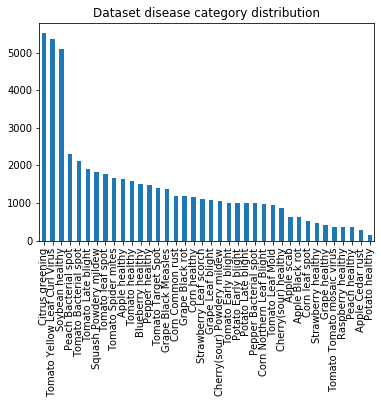

In [53]:
train_df.img_label.value_counts().plot.bar(title="Dataset disease category distribution")


In [56]:
direc = './color'

imagepaths=[]
for lbl in os.listdir(direc):
    for img_file in os.listdir(direc+"/"+lbl):
        imagepaths.append(direc+"/"+lbl+"/"+img_file)
#     print(lbl)

In [57]:
print(len(imagepaths))

54305


In [69]:
# Get path and label for each training image
db=[]
for label, class_name in enumerate(classes):
    path = data_dir + class_name
    for file in os.listdir(path):
        if not '.ini' in file:
            db.append(['{}/{}'.format(class_name, file), label, class_name])
db = pd.DataFrame(db, columns=['file', 'label', 'class_name'])

In [70]:
def read_img(filepath, size):
    img = image.load_img(data_dir + filepath, target_size=size)
    img = image.img_to_array(img)
    return img

def format_name(s):
    return re.sub('_+', ' ', s)

In [71]:
os.mkdir(data_dir+'train')
os.mkdir(data_dir+'test')

In [76]:
for c in classes:
    os.mkdir(data_dir+'train/'+c)
    os.mkdir(data_dir+'test/'+c)

In [77]:
# split data to train and test
from shutil import copyfile
tr_size = 0.8
np.random.seed(50)
num_images = len(db)
num = np.random.binomial(1, tr_size, num_images)

#Import images
i = 0
for file in tqdm(db['file'].values):
    from_path = data_dir +file
    if num[i]==1:
        to_path = data_dir+'train/'+file
    else:
        to_path = data_dir+'test/'+file
    copyfile(from_path, to_path)
    i+=1
    

100%|███████████████████████████████████████████████████████████████████████████| 54305/54305 [08:18<00:00, 108.99it/s]


In [ ]:
num_train_samples = df.train_ind.sum()
num_test_samples = len(df)-num_train_samples
print('Number of train images and test images are:', num_train_samples, num_test_samples)

# Specify data generator inputs

# Image augmentation using flips, rotations, brighting, burring
train_datagen = ImageDataGenerator(
    rescale=1/255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)
test_datagen = ImageDataGenerator(
    rescale=1/255)

In [ ]:
eidth, height, depth = 299, 299, 3
BATCH_SIZE = 64
# Create data generators
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=(width, height),
    batch_size=BATCH_SIZE,
#     interpolation="bicubic"
)
test_generator = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=(width, height),
    batch_size=BATCH_SIZE,
    shuffle = False
#     interpolation="bicubic"
)

In [ ]:
labels_map = (train_generator.class_indices)
labels = disc((v,k) for k,v in labels_map.items())

In [ ]:
def build_lrfn(lr_start=0.00001, lr_max=0.00005, 
               lr_min=0.00001, lr_rampup_epochs=5, 
               lr_sustain_epochs=0, lr_exp_decay=.8):
    #lr_max = lr_max * strategy.num_replicas_in_sync

    def lrfn(epoch):
        if epoch < lr_rampup_epochs:
            lr = (lr_max - lr_start) / lr_rampup_epochs * epoch + lr_start
        elif epoch < lr_rampup_epochs + lr_sustain_epochs:
            lr = lr_max
        else:
            lr = (lr_max - lr_min) *\
                 lr_exp_decay**(epoch - lr_rampup_epochs\
                                - lr_sustain_epochs) + lr_min
        return lr
    return lrfn

In [ ]:
lrfn = build_lrfn()
STEPS_PER_EPOCH = train_labels.shape[0] // BATCH_SIZE
lr_schedule = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=1)

In [ ]:
#with strategy.scope():
model = tf.keras.Sequential([DenseNet121(input_shape=(128, 128, 3),
                                             weights='imagenet',
                                             include_top=False),
                                 L.GlobalAveragePooling2D(),
                                 L.Dense(len(classes),
                                         activation='softmax')])
        
model.compile(optimizer='adam',
                  loss = 'categorical_crossentropy',
                  metrics=['categorical_accuracy'])
model.summary()

In [ ]:
history = model.fit_generator(train_generator,
                    epochs=EPOCHS,
                    callbacks=[lr_schedule],
                    steps_per_epoch=500,
                    validation_data=test_generator)


In [ ]:
model.save('full_efficientnet_1.h5')

In [ ]:
def display_training_curves(training, validation, yaxis):
    if yaxis == "loss":
        ylabel = "Loss"
        title = "Loss vs. Epochs"
    else:
        ylabel = "Accuracy"
        title = "Accuracy vs. Epochs"
        
    fig = go.Figure()
        
    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=training, marker=dict(color="dodgerblue"),
               name="Train"))
    
    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=validation, marker=dict(color="darkorange"),
               name="Val"))
    
    fig.update_layout(title_text=title, yaxis_title=ylabel, xaxis_title="Epochs", template="plotly_white")
    fig.show()

In [ ]:
display_training_curves(
    history.history['categorical_accuracy'], 
    history.history['val_categorical_accuracy'], 
    'accuracy')

In [ ]:
def decode_image(filename, label=None, image_size=None):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255.0
    if image_size:
        image = tf.image.resize(image, image_size)

    if label is None:
        return image
    else:
        return image, label


In [28]:
# Load sample images
def load_image(image_id):
    file_path = image_id + ".jpg"
    image = cv2.imread(IMAGE_PATH + file_path)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

train_images = train_data["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:06<00:00, 16.25it/s]



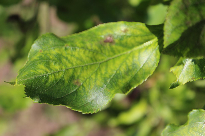

In [13]:
# Visualize one leaf
fig = px.imshow(cv2.resize(train_images[0], (205, 136)))
fig.show()

I have plotted the first image in the training data above (the RGB values can be seen by hovering over the image). The green parts of the image have very low blue values, but by contrast, the brown parts have high blue values. This suggests that green (healthy) parts of the image have low blue values, whereas unhealthy parts are more likely to have high blue values. This might suggest that the blue channel may be the key to detecting diseases in plants.

## Channel distributions 

In [14]:
red_values = [np.mean(train_images[idx][:, :, 0]) for idx in range(len(train_images))]
green_values = [np.mean(train_images[idx][:, :, 1]) for idx in range(len(train_images))]
blue_values = [np.mean(train_images[idx][:, :, 2]) for idx in range(len(train_images))]
values = [np.mean(train_images[idx]) for idx in range(len(train_images))]

In [15]:
#All channel values
fig = ff.create_distplot([values], group_labels=["Channels"], colors=["purple"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [16]:
#Red channel values
fig = ff.create_distplot([red_values], group_labels=["R"], colors=["red"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of red channel values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [17]:
fig = ff.create_distplot([red_values, green_values, blue_values],
                         group_labels=["R", "G", "B"],
                         colors=["red", "green", "blue"])
fig.update_layout(title_text="Distribution of red channel values", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig.data[2].marker.line.color = 'rgb(0, 0, 0)'
fig.data[2].marker.line.width = 0.5
fig

From the above plots, we can clearly see which colors are more common and which ones less common in the leaf images. Green is the most pronounced color, followed by red and blue respectively. The distributions, when plotted together, appear to have a similar shape, but shifted horizontally.

In [21]:
## Visualize sample leaves 
#Now, I will visualize sample leaves beloning to different categories in the dataset.
def visualize_leaves(cond=[0, 0, 0, 0], cond_cols=["healthy"], is_cond=True):
    if not is_cond:
        cols, rows = 3, min([3, len(train_images)//3])
        fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
        for col in range(cols):
            for row in range(rows):
                ax[row, col].imshow(train_images.loc[train_images.index[-row*3-col-1]])
        return None
        
    cond_0 = "healthy == {}".format(cond[0])
    cond_1 = "scab == {}".format(cond[1])
    cond_2 = "rust == {}".format(cond[2])
    cond_3 = "multiple_diseases == {}".format(cond[3])
    
    cond_list = []
    for col in cond_cols:
        if col == "healthy":
            cond_list.append(cond_0)
        if col == "scab":
            cond_list.append(cond_1)
        if col == "rust":
            cond_list.append(cond_2)
        if col == "multiple_diseases":
            cond_list.append(cond_3)
    
    data = train_data.iloc[:100]
    for cond in cond_list:
        data = data.query(cond)
        
    images = train_images.loc[list(data.index)]
    cols, rows = 3, min([3, len(images)//3])
    
    fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.loc[images.index[row*3+col]])
    plt.show()

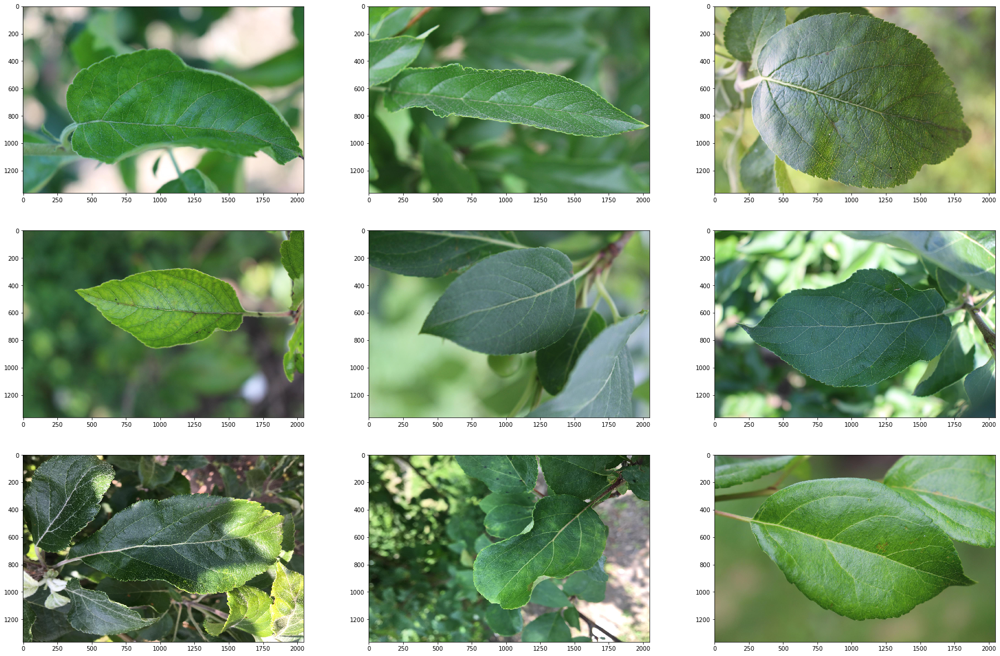

In [22]:
# Healthy leaves
visualize_leaves(cond=[1, 0, 0, 0], cond_cols=["healthy"])

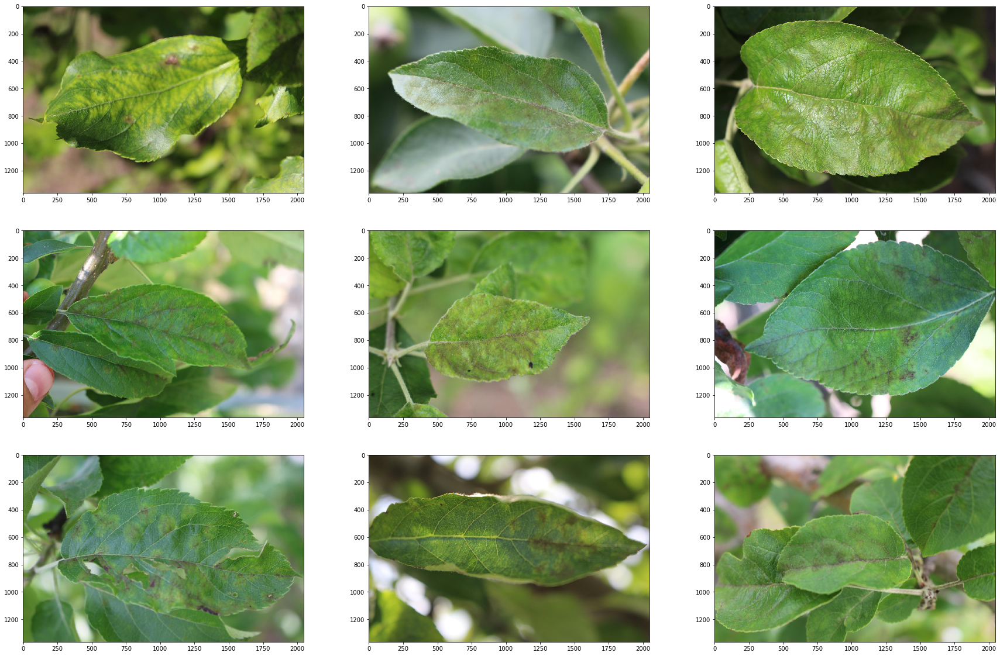

In [23]:
# Leaves with scab
visualize_leaves(cond=[0, 1, 0, 0], cond_cols=["scab"])

In the above images, we can see that leaves with "scab" have large brown marks and stains across the leaf. Scab is defined as "any of various plant diseases caused by fungi or bacteria and resulting in crustlike spots on fruit, leaves, or roots. The spots caused by such a disease". The brown marks across the leaf are a sign of these bacterial/fungal infections. Once diagnosed, scab can be treated using chemical or non-chemical methods.

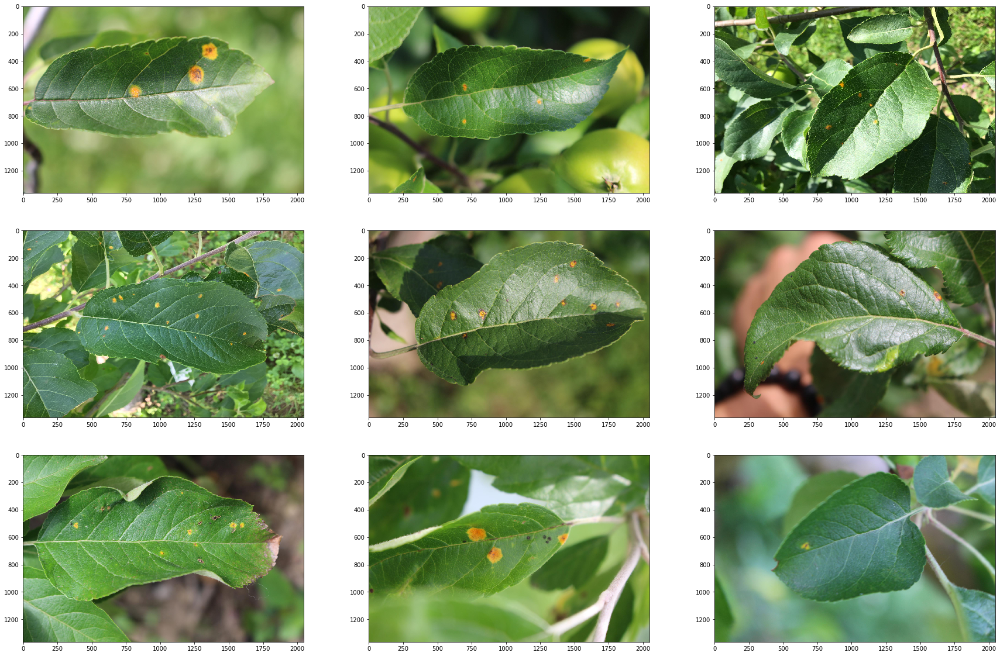

In [24]:
# Leaves with rust
visualize_leaves(cond=[0, 0, 1, 0], cond_cols=["rust"])

In the above images, we can see that leaves with "rust" have several brownish-yellow spots across the leaf. Rust is defined as "a disease, especially of cereals and other grasses, characterized by rust-colored pustules of spores on the affected leaf blades and sheaths and caused by any of several rust fungi". The yellow spots are a sign of infection by a special type of fungi called "rust fungi". Rust can also be treated with several chemical and non-chemical methods once diagnosed.

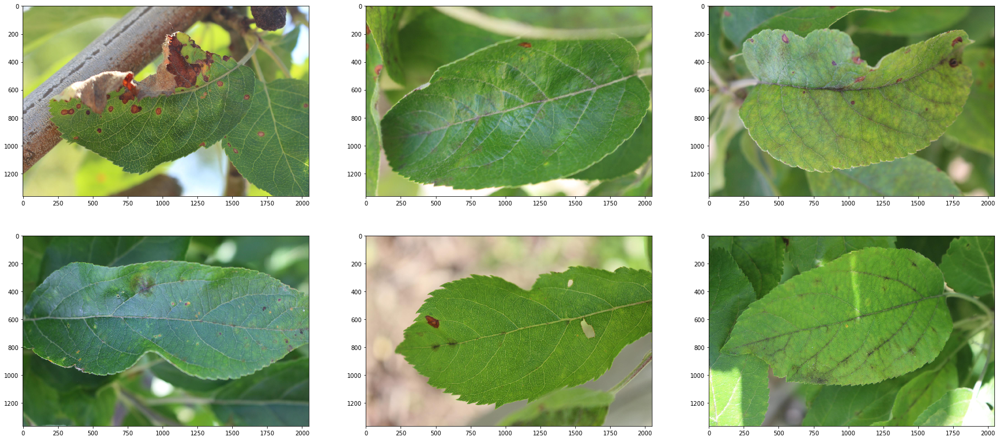

In [25]:
visualize_leaves(cond=[0, 0, 0, 1], cond_cols=["multiple_diseases"])

In the above images, we can see that the leaves show symptoms for several diseases, including brown marks and yellow spots. These plants have more than one of the above-described diseases.

In [26]:
fig = go.Figure([go.Pie(labels=train_data.columns[1:],
           values=train_data.iloc[:, 1:].sum().values)])
fig.update_layout(title_text="Pie chart of targets", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.show()

In the pie chart above, we can see that most leaves in the dataset are unhealthy (71.7%). Only 5% of plants have multiple diseases, and "rust" and "scab" occupy approximately one-third of the pie each.

In [28]:
# Image processing and augmentation
def edge_and_cut(img):
    emb_img = img.copy()
    edges = cv2.Canny(img, 100, 200)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i, j))
    
    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[1] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]
    
    emb_img[row_min-10:row_min+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_max-10:row_max+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_min:row_max, col_min-10:col_min+10] = [255, 0, 0]
    emb_img[row_min:row_max, col_max-10:col_max+10] = [255, 0, 0]
    
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(edges, cmap='gray')
    ax[1].set_title('Canny Edges', fontsize=24)
    ax[2].imshow(emb_img, cmap='gray')
    ax[2].set_title('Bounding Box', fontsize=24)
    plt.show()

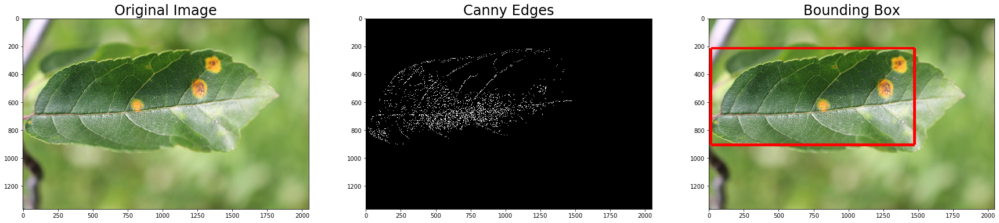

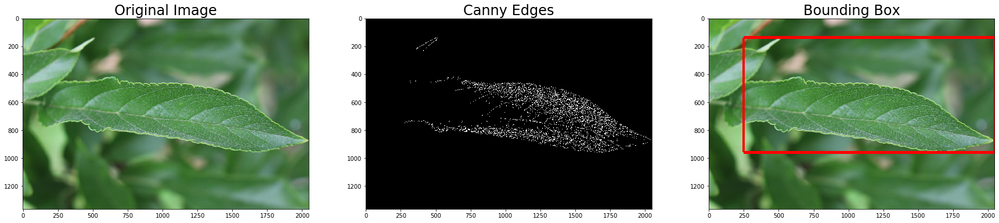

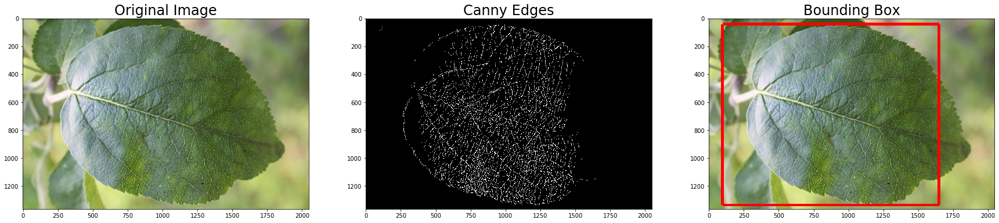

In [29]:
edge_and_cut(train_images[3])
edge_and_cut(train_images[4])
edge_and_cut(train_images[5])

The second column of images above contains the Canny edges and the third column contains cropped images. I have taken the Canny edges and used it to predict a bounding box in which the actual leaf is contained. The most extreme edges at the four corners of the image are the vertices of the bounding box. This red box is likely to contain most of if not all of the leaf. These edges and bounding boxes can be used to build more accurate models.

In [30]:
# Flipping
def invert(img):
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.flip(img, 0))
    ax[1].set_title('Vertical Flip', fontsize=24)
    ax[2].imshow(cv2.flip(img, 1))
    ax[2].set_title('Horizontal Flip', fontsize=24)
    plt.show()

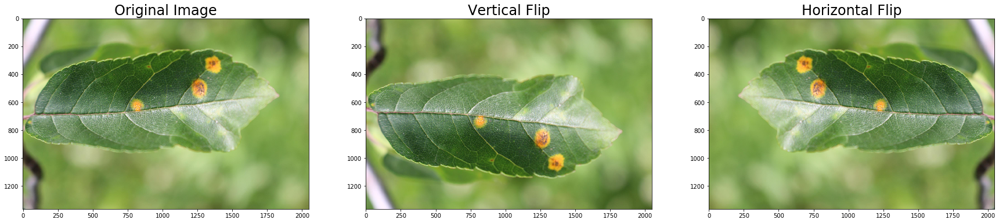

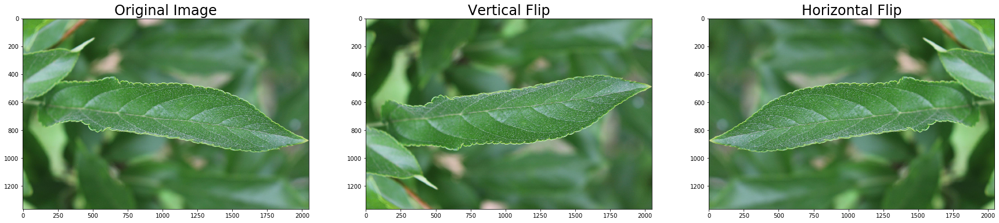

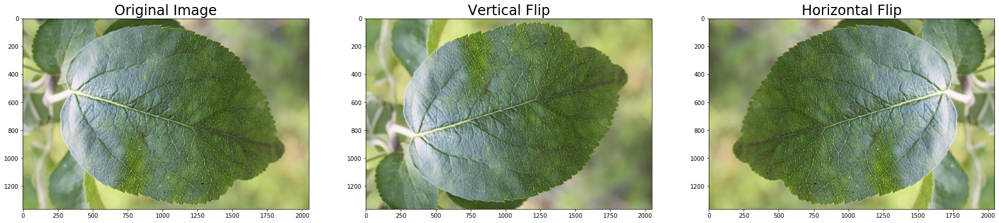

In [31]:
invert(train_images[3])
invert(train_images[4])
invert(train_images[5])

We can see that the images are simply flipped. All major features in the image remain the same, but to a computer algorithm, the flipped images look completely different. These transformations can be used for data augmentation, making models more robust and accurate.

In [32]:
# Convolution
def conv(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    kernel = np.ones((7, 7), np.float32)/25
    conv = cv2.filter2D(img, -1, kernel)
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(conv)
    ax[1].set_title('Convolved Image', fontsize=24)
    plt.show()

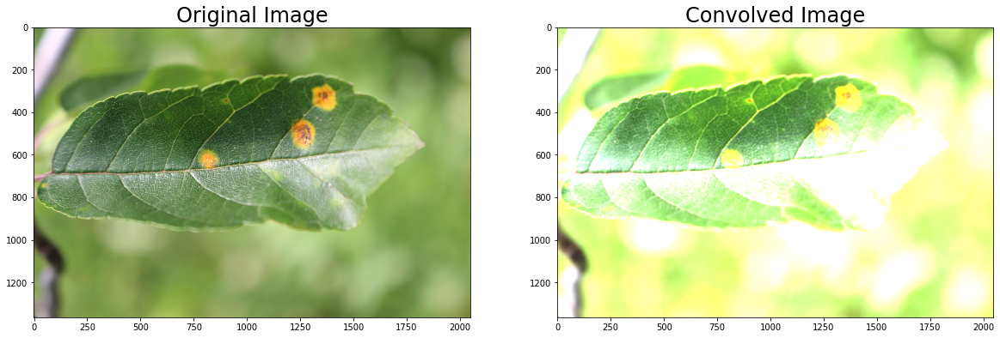

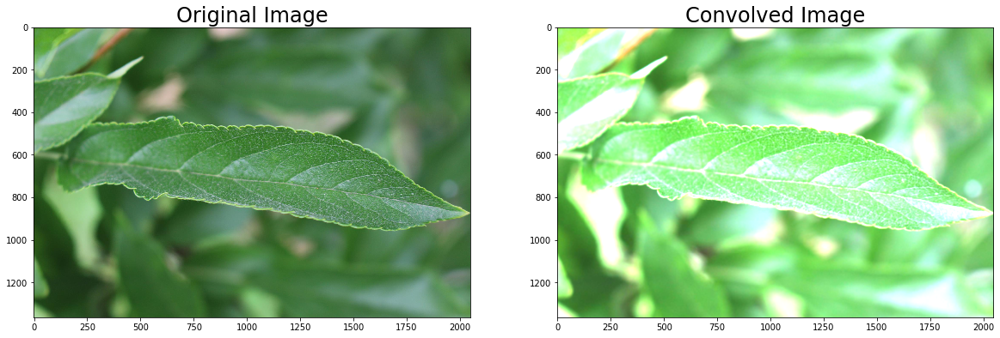

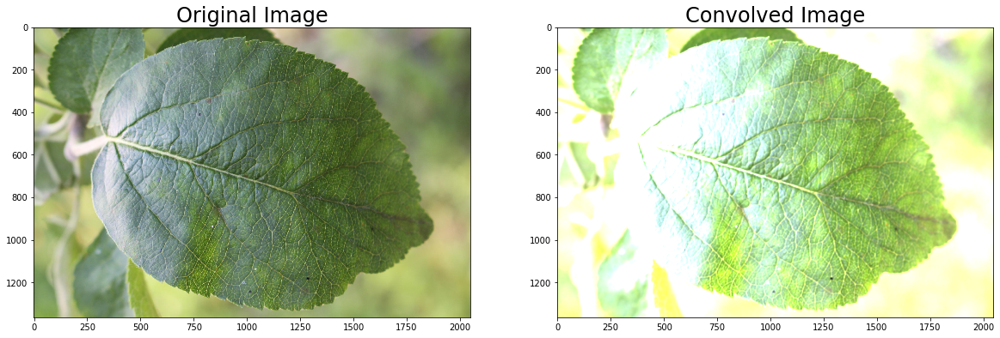

In [33]:
conv(train_images[3])
conv(train_images[4])
conv(train_images[5])

The convolution operator seems to have an apparent "sunshine" effect of the images. This may also serve the purpose of augmenting the data, thus helping to build more robust and accurate models.

## Blurring 
Blurring is simply the addition of noise to the image, resulting in a less-clear image. The noise can be sampled from any distribution of choice, as long as the main content in the image does not become invisible. Only the minor details get obfuscated due to blurring. The blurring transformation can be represented using the equation below.



In [34]:
def blur(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.blur(img, (100, 100)))
    ax[1].set_title('Blurred Image', fontsize=24)
    plt.show()

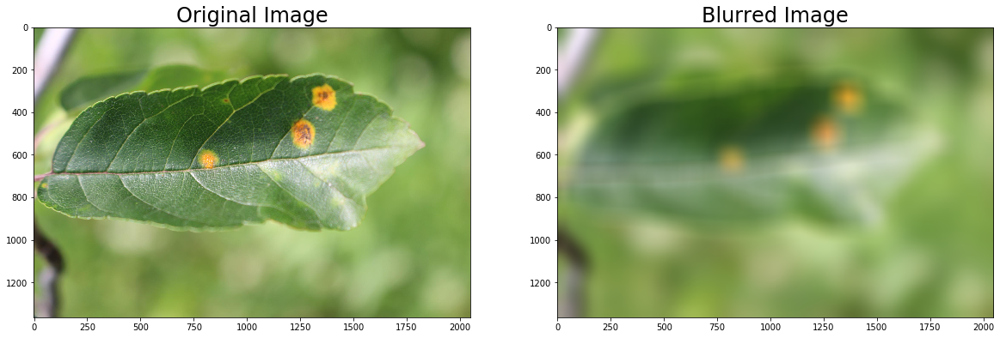

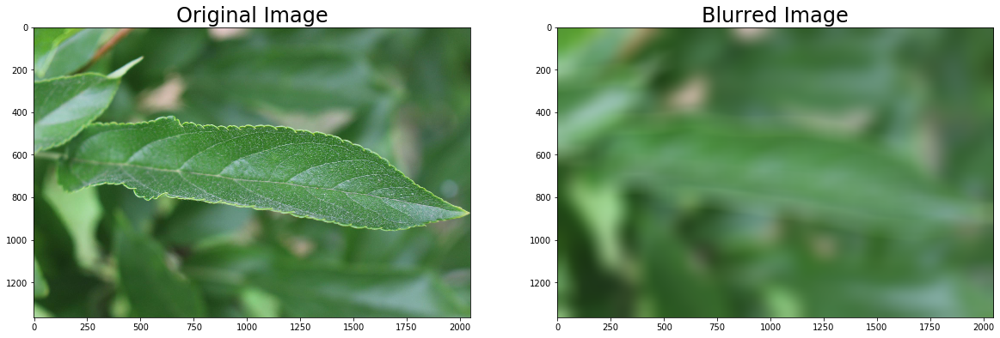

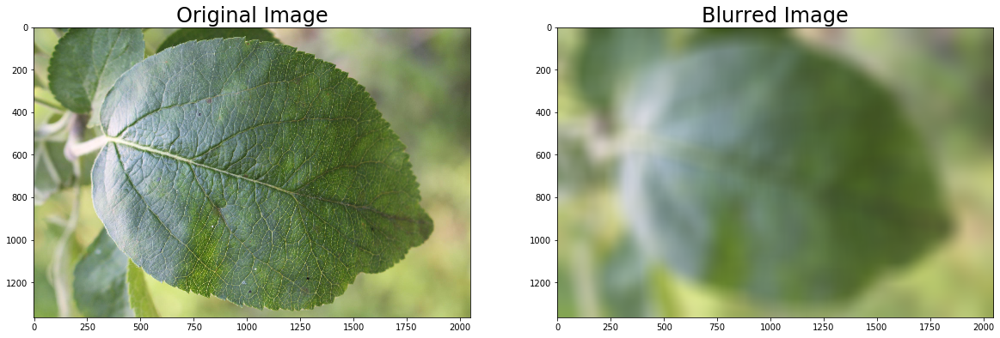

In [35]:
blur(train_images[3])
blur(train_images[4])
blur(train_images[5])

The transformation clearly blurs the image by removing detailed, low-level features, while retaining the major, high-level features. This is once again a great way to augment images and train more robust models.

## Modelling

In [6]:
AUTO = tf.data.experimental.AUTOTUNE
#tpu = tf.distribute.cluster_resolver.TPUClusterResolver()

#tf.config.experimental_connect_to_cluster(tpu)
#tf.tpu.experimental.initialize_tpu_system(tpu)
#strategy = tf.distribute.experimental.TPUStrategy(tpu)

#BATCH_SIZE = 16 * strategy.num_replicas_in_sync
#GCS_DS_PATH = KaggleDatasets().get_gcs_path()

In [7]:

BATCH_SIZE = 8

In [8]:
def format_path(st):
    return './images/' + st + '.jpg'

test_paths = test_data.image_id.apply(format_path).values
train_paths = train_data.image_id.apply(format_path).values

train_labels = np.float32(train_data.loc[:, 'healthy':'scab'].values)
train_paths, valid_paths, train_labels, valid_labels =\
train_test_split(train_paths, train_labels, test_size=0.15, random_state=2020)

In [9]:
def decode_image(filename, label=None, image_size=(512, 512)):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.resize(image, image_size)
    
    if label is None:
        return image
    else:
        return image, label

def data_augment(image, label=None):
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_flip_up_down(image)
    
    if label is None:
        return image
    else:
        return image, label

In [23]:
train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((train_paths, train_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .map(data_augment, num_parallel_calls=AUTO)
    .repeat()
    .shuffle(512)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

valid_dataset = (
    tf.data.Dataset
    .from_tensor_slices((valid_paths, valid_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .cache()
    .prefetch(AUTO)
)

test_dataset = (
    tf.data.Dataset
    .from_tensor_slices(test_paths)
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
)

In [11]:
def build_lrfn(lr_start=0.00001, lr_max=0.00005, 
               lr_min=0.00001, lr_rampup_epochs=5, 
               lr_sustain_epochs=0, lr_exp_decay=.8):
    #lr_max = lr_max * strategy.num_replicas_in_sync

    def lrfn(epoch):
        if epoch < lr_rampup_epochs:
            lr = (lr_max - lr_start) / lr_rampup_epochs * epoch + lr_start
        elif epoch < lr_rampup_epochs + lr_sustain_epochs:
            lr = lr_max
        else:
            lr = (lr_max - lr_min) *\
                 lr_exp_decay**(epoch - lr_rampup_epochs\
                                - lr_sustain_epochs) + lr_min
        return lr
    return lrfn

In [12]:
lrfn = build_lrfn()
STEPS_PER_EPOCH = train_labels.shape[0] // BATCH_SIZE
lr_schedule = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=1)

In [13]:
#with strategy.scope():
model = tf.keras.Sequential([DenseNet121(input_shape=(512, 512, 3),
                                             weights='imagenet',
                                             include_top=False),
                                 L.GlobalAveragePooling2D(),
                                 L.Dense(train_labels.shape[1],
                                         activation='softmax')])
        
model.compile(optimizer='adam',
                  loss = 'categorical_crossentropy',
                  metrics=['categorical_accuracy'])
model.summary()

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
densenet121 (Model)          (None, 16, 16, 1024)      7037504   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1024)              0         
_________________________________________________________________
dense (Dense)                (None, 4)                 4100      
Total params: 7,041,604
Trainable params: 6,957,956
Non-trainable params: 83,648
_________________________________________________________________


The above image shows the fundamental block in the DenseNet architecture. The architecture mainly involves Convolution, Maxpooling, ReLU, and concatenation.